#**Class(17)(Decision Tree)(Aug5-2023)**

In [ ]:
# if we are solving "decision tree" go with Label encoder. because its a if else condition

In [ ]:
# For Regression problem dont use decision tree that is not good option at all. we can use Linear regression,Rnadom Forest etc..

In [ ]:
#  Outlier :

#     Linear Regression                                      - Outlier tratment mandatory
#     KNN                                                    - Outlier tratment mandatory
#     SVM                                                    - Outlier tratment mandatory
#     Naive Base theorm                                      - Outlier tratment not mandatory
#     Random Forest,Bagging,adaboost,XGB,gradient boosting   - Outlier tratment not mandatory
#     Logistic Regression                                    - Outlier tratment not mandatory

In [ ]:
# why decision : -

# Decision Tree : are powerful & population tools for classification predict.
# Decision Tree represents , which can be understood by human
# Respectively fast compared to other classification models.
# obtain similar and sometime better accuracy compare to other models.

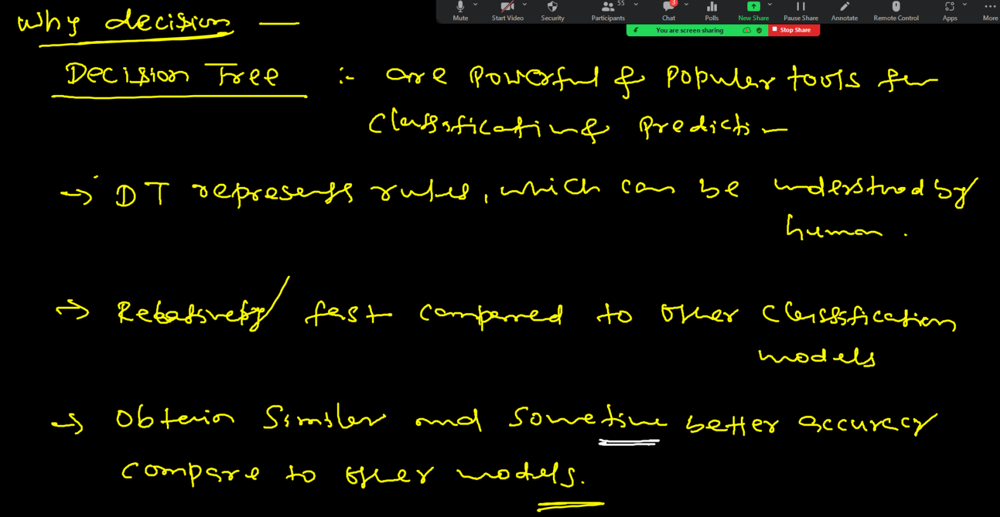

In [ ]:
# Linear Family :-

  # 1. Linear Regression
  # 2. Lasso Regression
  # 3. Ridge Regression
  # 4. Elastic net
  # 5. Gradient Descent

In [ ]:
# data is linearly seperable go with Logistic Regression, if not linearly seperable then go with decision tree

In [ ]:
# Tree Based Model :-

  # 1. Decision Tree
  # 2. Random Forest
  # 3. Bagging
  # 4. Ada boost
  # 5. Gradient Boosting
  # 6. XGB Boosting
  # 7. Light Gradient Boosting
  # 8. cat Boosting
  # 9. voting
  # 10. Stacking



In [ ]:
# Decision Tree is Non-Parametric model.

    # Parametric - Where there is Assumption there, on the basis of assumption we have to decide our model
    #               is good or bad.like Linear Regression.

    # Non-Parametric model - No Assumption is there, we have directly build a model.


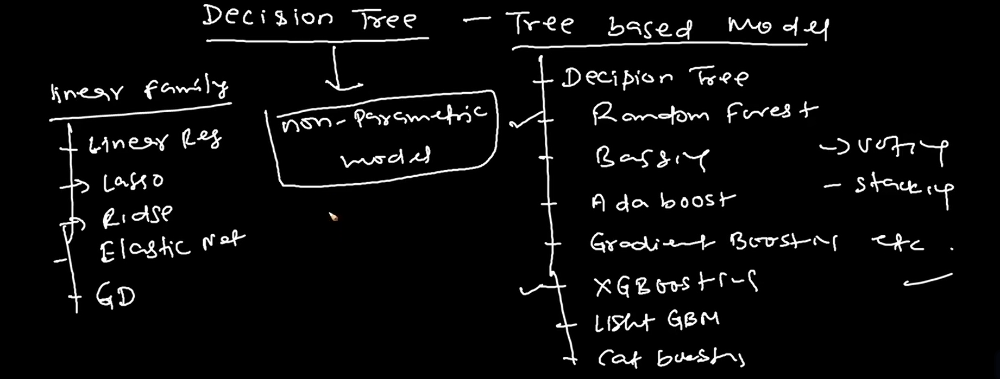

In [ ]:
# Decision tree support both Classification and Regression.
# Decision tree is a Supervised Machine Learning.supervised machine learning means we have dependent variable there.
# Geometrical institution of decision tree = "Axis parallel hyperplanes"
# Decision tree is "Nested if-else condition model".

  # Explain why decision tree is "Nested if-else model" is in figure

    # IRIS DATASET(sepal length(sL),sepal width(sw),petal length(pL),petal width(pw),specious(sitosa,verginica,vergicolor))



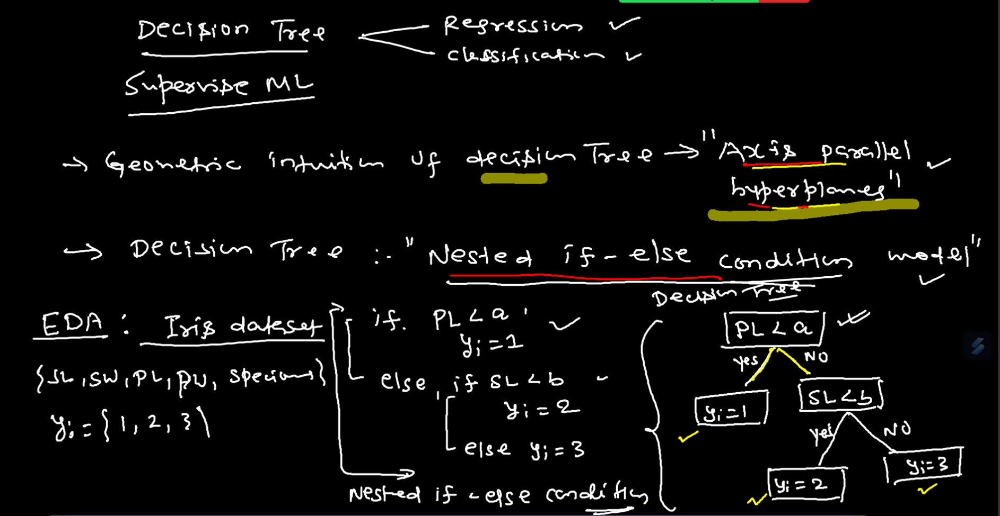

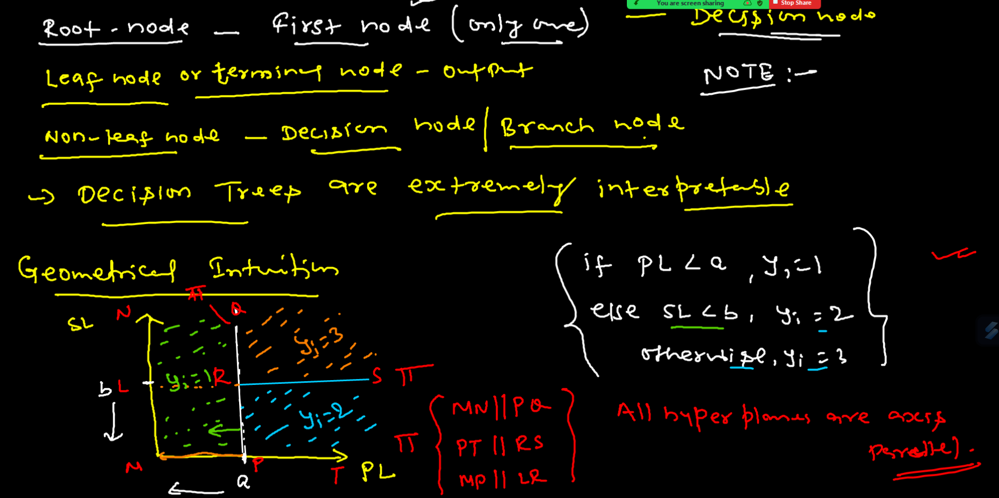

In [ ]:
# Building a Decision Tree :-

  # Certain method is there for building a decision tree:-

    # Entropy (lower the entropy value better the root node)
    # gini    (higher the gini value better the root mode)
    # Information gain (higher the information gain,better the root node)


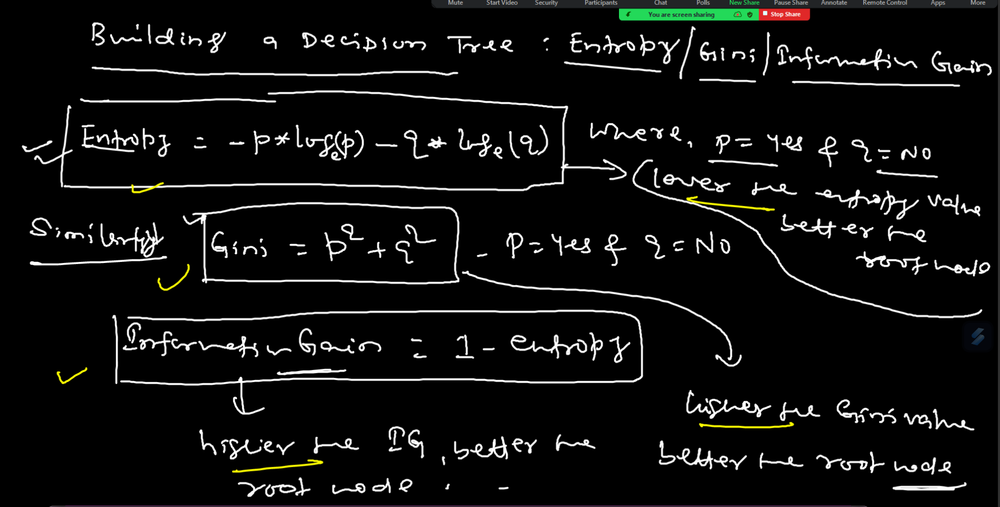

In [ ]:
# Q. Why log occurs in entropy?

# Ans : - Because of Information Theory & Thermodynamics in physics. It is proved that gives better result and
#          in data science entropy concept has taken from Information Theory


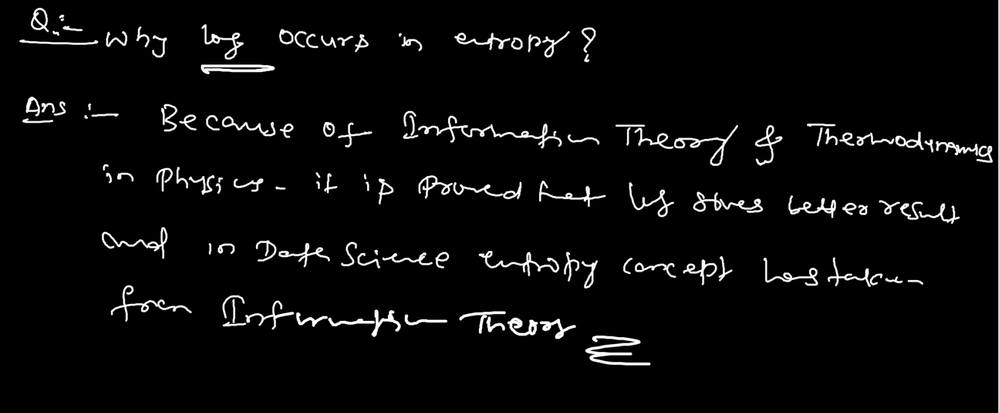

In [ ]:
# example : -

#  In this figure 30 student is there,selection team only selected only 15 student,How selection happens
#    1. gender wise
#    2. height wise
#    3. class wise


# so we cant say directly that selection team will select gender wisse or height wise or class wise

 # so here we have to choose one method(entropy,gini,information gain) for selection :-

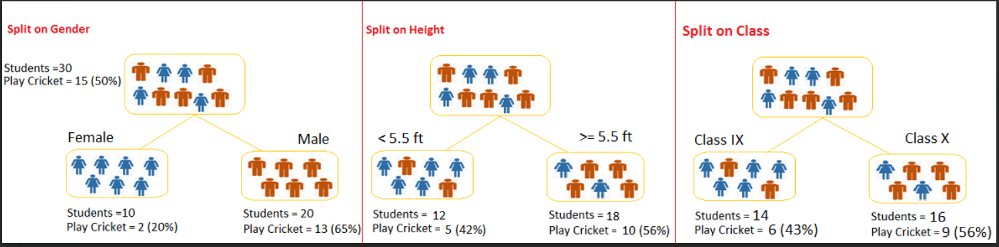

In [ ]:
   # gini

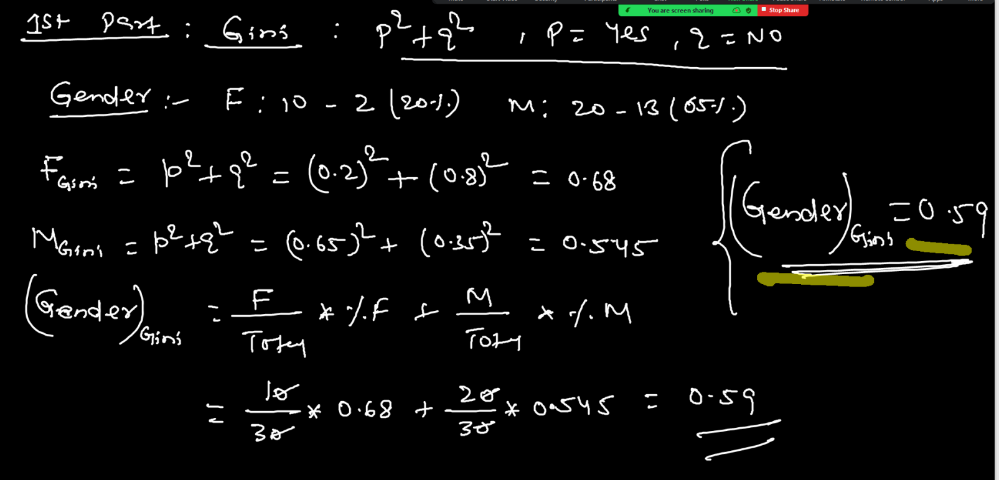

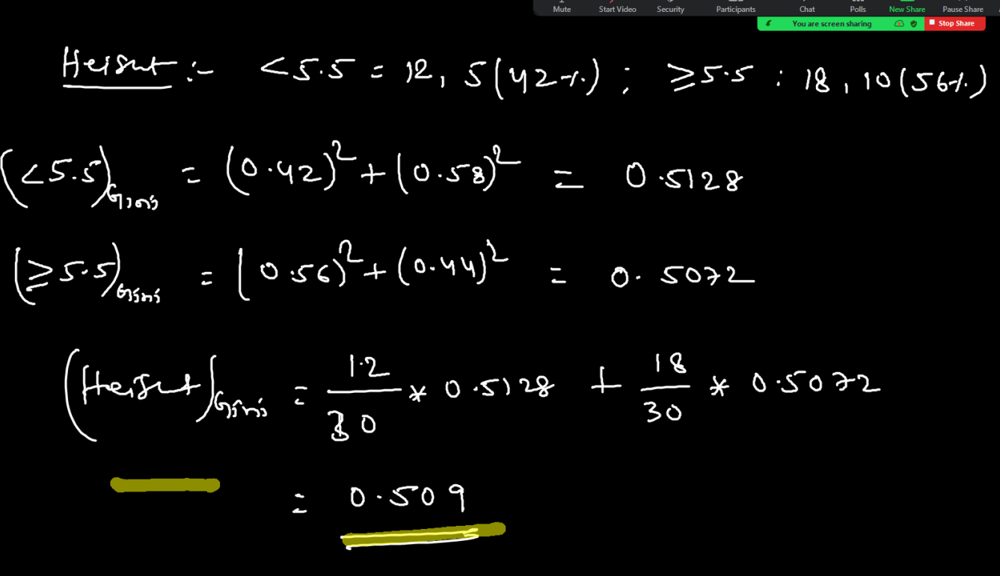

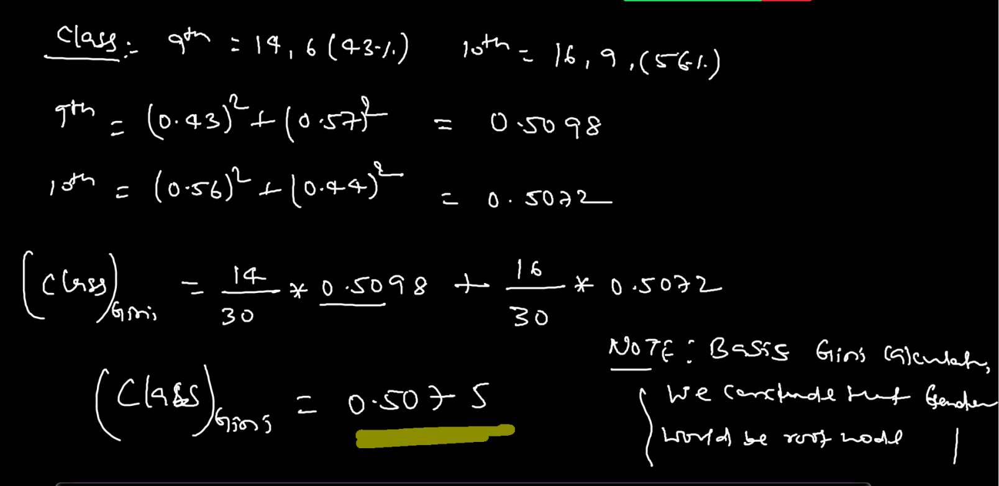

In [ ]:
# gender - 0.59
# Height - 0.509
# class - 0.507

     # gini    (higher the gini value better the root mode)

    #  so selection team will select gender wise


In [ ]:
    # entropy

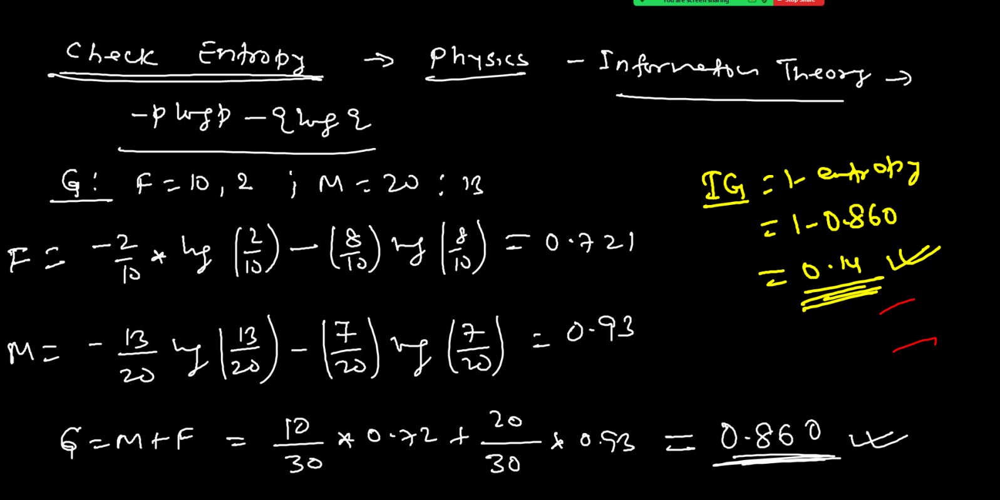

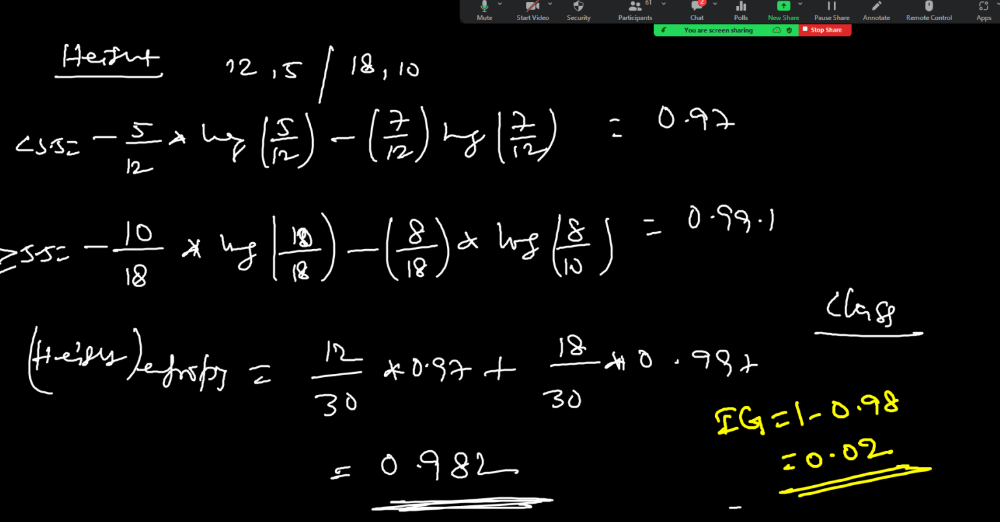

In [ ]:
# calculate class also and check.

    # Entropy (lower the entropy value better the root node)

#   #  so selection team will select with lower value.


**KL - divergence**

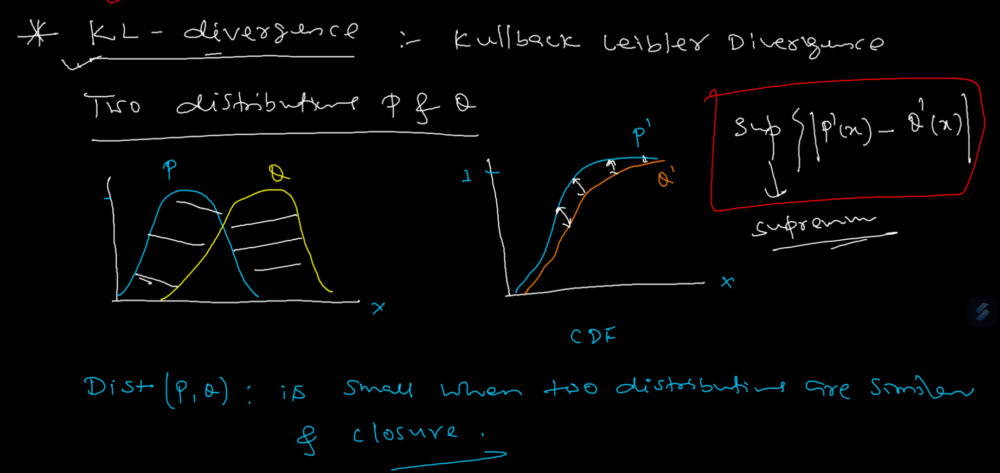

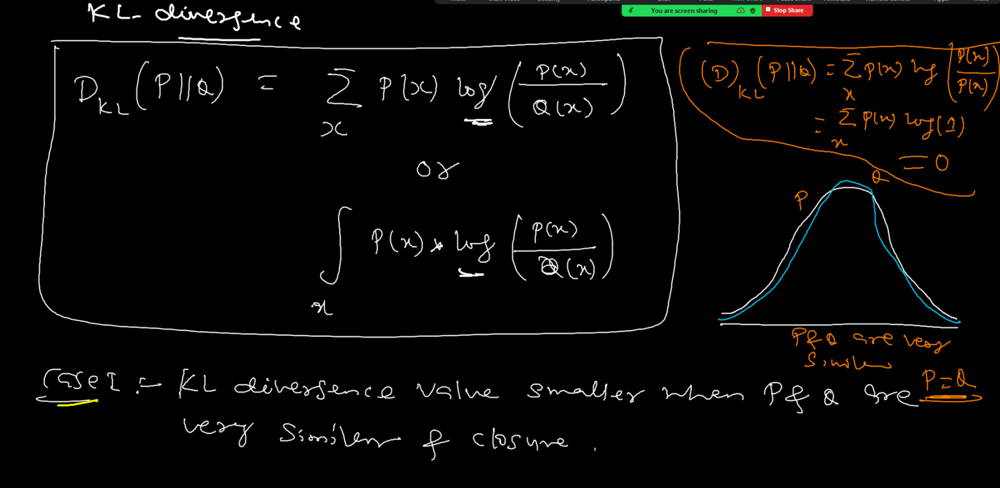

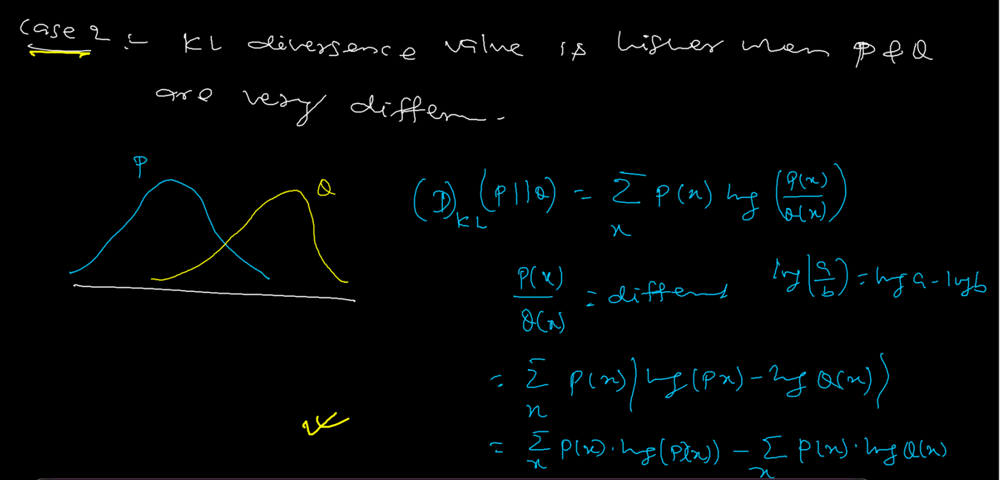

**KS - Statistics**

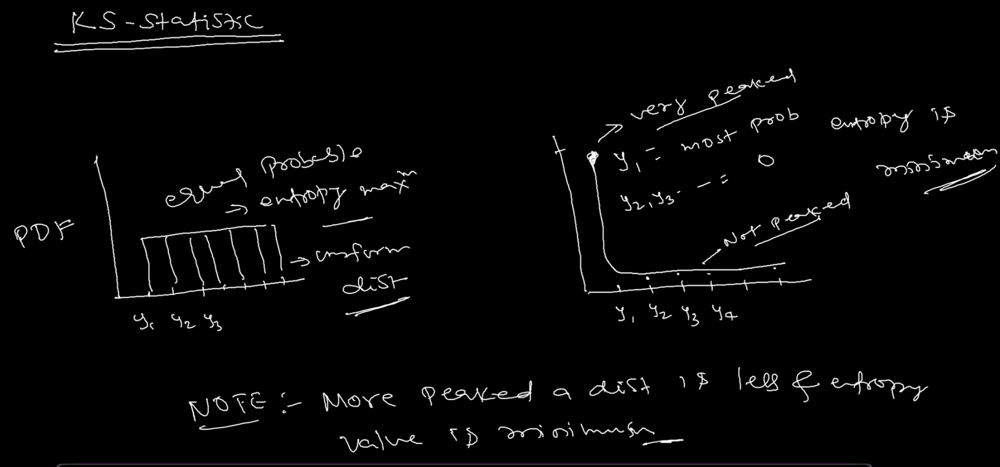

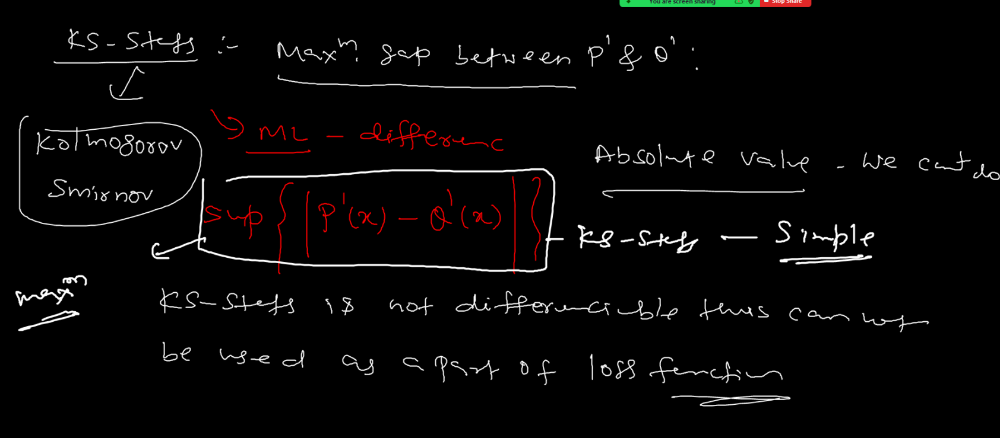

In [ ]:
 # explain Decision tree :-

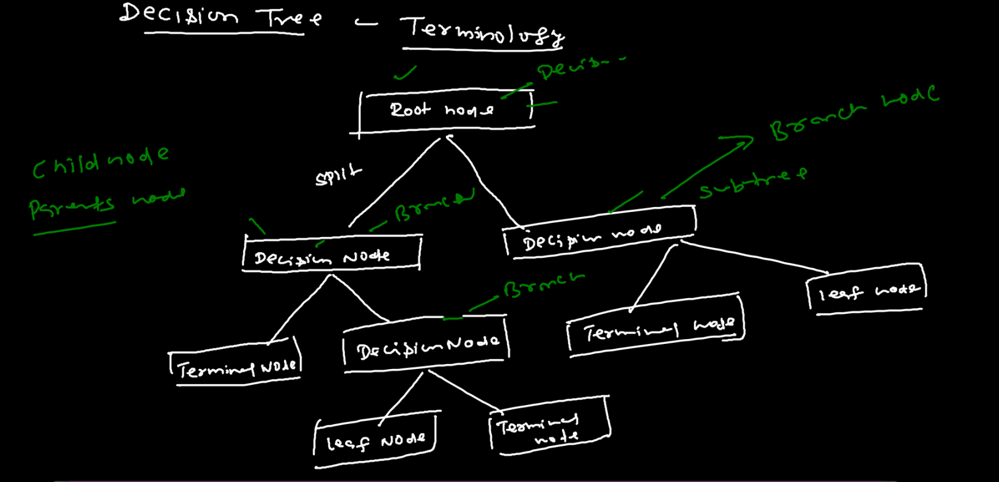

In [ ]:
# using alogorithm in Decision tree :-

   # CART
   # CHAID - chi-square Automatic Interaction Detector

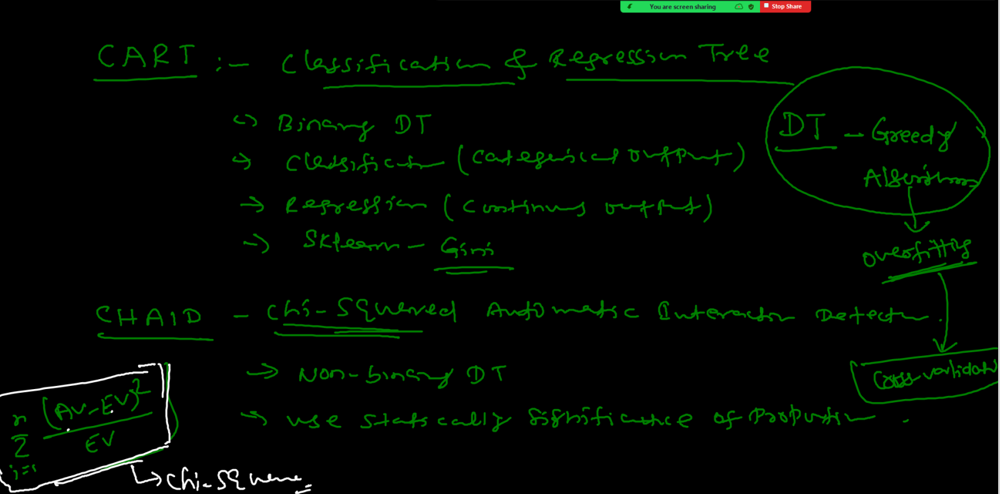

In [ ]:
# Real world case study, what are the key things we have to remember.

# (1) Imbalance dataset :- we have to balance
# (2) Large dimensiliaty(means so many feature there) :- each node-split -> time complexity happen
                                        #  categorical variable  :  In decision tree we can use Label Encoding

# (3) Multiclass classification - OVR/softmax
# (4) Decision surface     -      non-linear , axis-parallel hyperplane
# (5) Feature Interaction  - its a nested if-else condition(For this we have use entropy,gini etc )
# (6) Outlier is there - then we have to work on this
# (7) Interpretability - super
# (8) Feature importance -


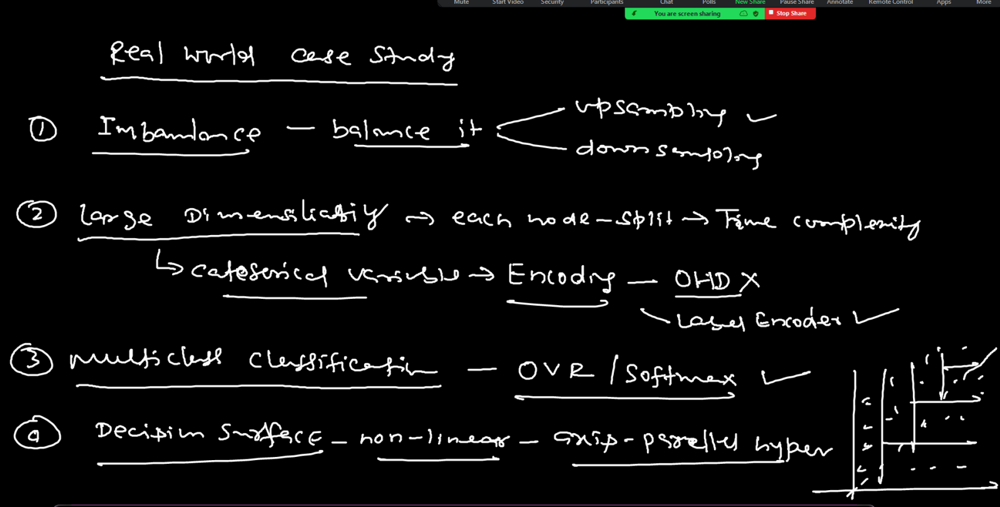

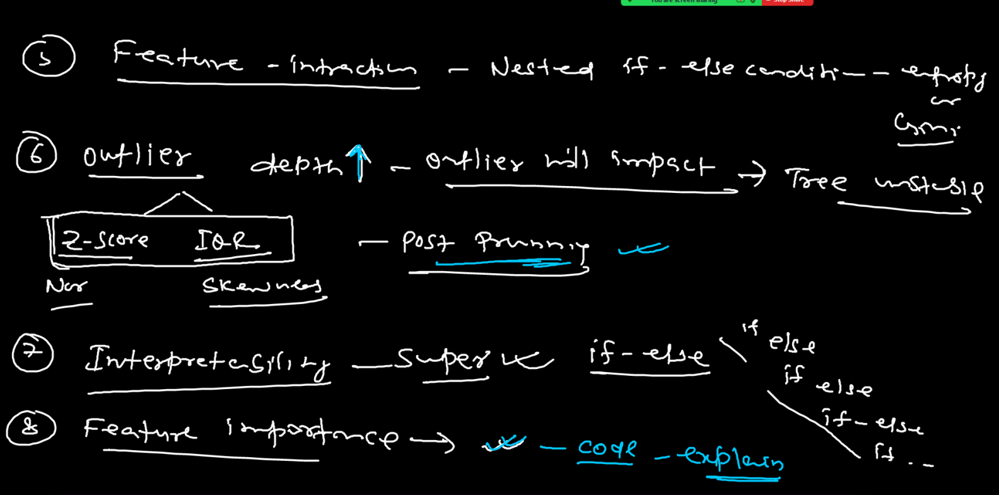

In [ ]:
# Advantage :-

# (1) Simple to understand & to interpret - tree can be visualize
# (2) can work on non-linear dataset.
# (3) Able to handle both numerical & categorical data
# (4) Require little data preparation .

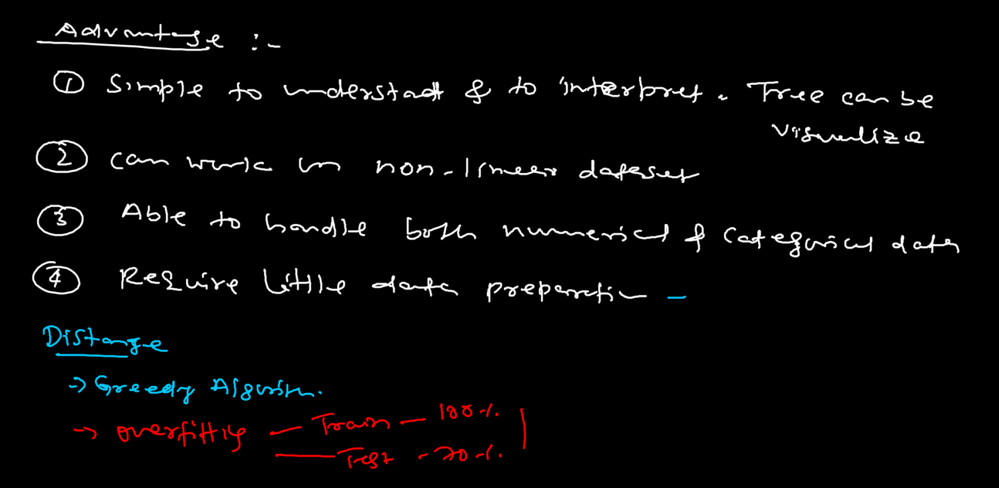

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set()
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.tree import export_text

In [ ]:
# Load iris dataset
iris = load_iris()
iris

In [ ]:
iris.target

In [ ]:
x = iris.data[:,:2]
y = iris.target

In [ ]:
# split the data into training and test
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [ ]:
dtree = DecisionTreeClassifier(criterion='gini',  max_depth=3)
dtree.fit(x_train, y_train)

#  How handle overfitting problem?
# -> we will use max_depth and then we will treat it so that my tree will not grow,my tree will not go deep dive,
#      we can maintain that, that is called postune approach

# dtree = DecisionTreeClassifier(criterion='gini')
# dtree.fit(x_train, y_train) # here not using max_depth , so give overfitting problem, and tree will grow

In [ ]:
from sklearn.metrics import accuracy_score
y_pred_train = dtree.predict(x_train)
y_pred_test = dtree.predict(x_test)
print(f"Training Accuray : {accuracy_score(y_train, y_pred_train)}")

print()

print(f"Test Accuray : {accuracy_score(y_test, y_pred_test)}")

In [ ]:
# plot the decisionTree
plt.figure(figsize=(14,12))
plot_tree(dtree, filled=True, feature_names=iris.feature_names[:2], class_names=iris.target_names)
plt.show()

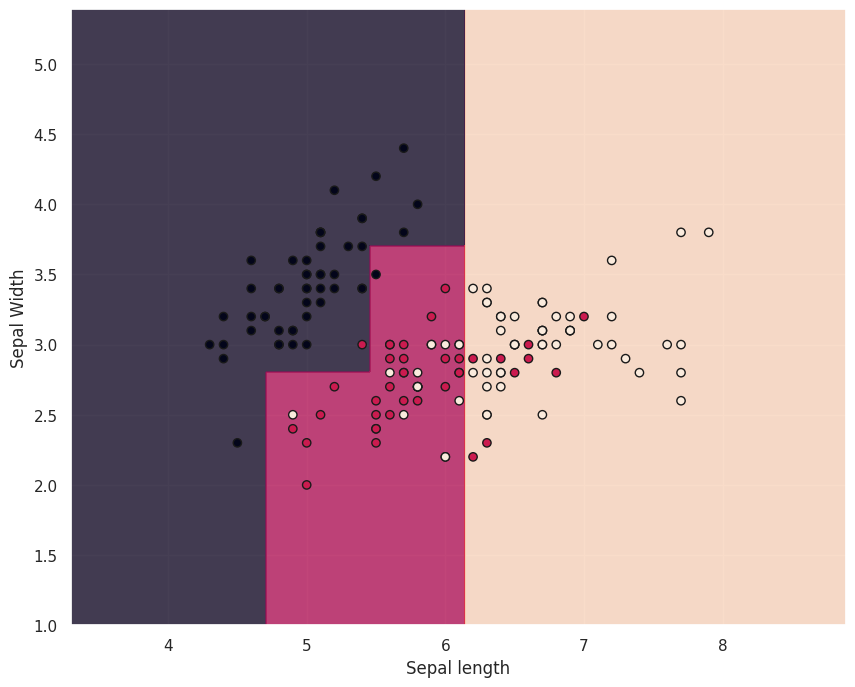

In [ ]:
# plot the decision boundary
# Parallel-axis hyperplane

plt.figure(figsize=(10,8))
x_min, x_max = x[:,0].min() - 1, x[:,0].max() + 1
y_min, y_max = x[:,1].min() - 1, x[:,1].max() + 1

xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01), np.arange(y_min, y_max, 0.01))
z = dtree.predict(np.c_[xx.ravel(), yy.ravel()])
z = z.reshape(xx.shape)

plt.contourf(xx, yy, z, alpha=0.8)
plt.scatter(x[:,0], x[:,1], c=y, edgecolor='k')
plt.xlabel('Sepal length')
plt.ylabel('Sepal Width')
plt.show()

# red is residual(error)

In [ ]:
abc = export_text(dtree, feature_names=['sepal_length','sepal_width'])
print(abc)
# this is nothing nested if-else condition

|--- sepal_length <= 5.45
|   |--- sepal_width <= 2.80
|   |   |--- sepal_length <= 4.70
|   |   |   |--- class: 0
|   |   |--- sepal_length >  4.70
|   |   |   |--- class: 1
|   |--- sepal_width >  2.80
|   |   |--- sepal_length <= 5.35
|   |   |   |--- class: 0
|   |   |--- sepal_length >  5.35
|   |   |   |--- class: 0
|--- sepal_length >  5.45
|   |--- sepal_length <= 6.15
|   |   |--- sepal_width <= 3.70
|   |   |   |--- class: 1
|   |   |--- sepal_width >  3.70
|   |   |   |--- class: 0
|   |--- sepal_length >  6.15
|   |   |--- sepal_length <= 7.05
|   |   |   |--- class: 2
|   |   |--- sepal_length >  7.05
|   |   |   |--- class: 2



#**Class(18)(Decision Tree(code),RandoForest(Theory))(Aug6-2023)**

In [ ]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [ ]:
dataset=pd.read_csv('/content/50_Startups.csv')
dataset.head()

In [ ]:
dataset.isnull().sum()

In [ ]:
dataset.info()

In [ ]:
dataset['State'].value_counts()

In [ ]:
dataset=pd.get_dummies(dataset,columns=['State'],drop_first=True)

In [ ]:
dataset.head()

In [ ]:
# split the data into ind variable and dep variable
x=dataset.drop(['Profit'],axis=1)
y=dataset[['Profit']]

In [ ]:
x.head()

In [ ]:
y.head()

In [ ]:
x.describe()

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=101)

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn import metrics
# this is regression problem not classification problem
# if classifier problem will be there then we have to import DecisionTreeClassifier

In [ ]:
# Regression - whereever output is a continious number or numerical value, we can say Regression problem.
# Classification - when output is binary class or multiclass or categorical value, we can say classification problem.

In [ ]:
dtree_reg=DecisionTreeRegressor()
dtree_reg.fit(x_train,y_train)
# this is regression problem not classification problem
# if classifier problem will be there then we have to import DecisionTreeClassifier
# In Regression Problem we can not use "gini","entropy" etc method for solving the Overfitting problem.
#      we have to use "gini","entropy" for classification problem.

In [ ]:
# predict
y_pred_train=dtree_reg.predict(x_train)
y_pred_test=dtree_reg.predict(x_test)

In [ ]:
from sklearn.metrics import r2_score
# for regression we have to import r2_score or for classification we have to import accuracy_score

In [ ]:
print("Training Accuracy ",r2_score(y_train,y_pred_train))
print()
print("Test Accuracy ",r2_score(y_test,y_pred_test))

# this is overfitting problem, here accuracy score is 100% and test accuracy is 76%, more then 10% difference is there so this is overfitting problem

RandomForest Regression

In [ ]:
from sklearn.ensemble import RandomForestRegressor


In [ ]:
rf_reg=RandomForestRegressor()
rf_reg.fit(x_train,y_train)

In [ ]:
y_pred_train_rf=rf_reg.predict(x_train)
y_pred_test_rf=rf_reg.predict(x_test)

In [ ]:
print("Training Accuracy :",r2_score(y_train,y_pred_train_rf))
print()
print("Test Accuracy ", r2_score(y_test,y_pred_test_rf))

Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression
linear=LinearRegression()
linear.fit(x_train,y_train)

In [ ]:
y_pred_train_lr=linear.predict(x_train)
y_pred_test_lr=linear.predict(x_test)

In [ ]:
print("Training Accuracy ",r2_score(y_train,y_pred_train_lr))
print()
print("Test Accuracy ",r2_score(y_test,y_pred_test_lr))

**DecisionTree Classifier**

In [ ]:
df=pd.read_csv('/content/penguins_lter (1).csv')
df.head()

In [ ]:
df['Species'].value_counts()

In [ ]:
df.columns

In [ ]:
df=df.drop(['studyName','Sample Number','Region','Stage','Individual ID','Date Egg','Delta 15 N (o/oo)','Delta 13 C (o/oo)','Comments'],axis=1)

In [ ]:
df.head()

In [ ]:
df.describe()

In [ ]:
df.isnull().sum()/len(df)*100

In [ ]:
df.info()

In [ ]:
for i in df.columns:
  print("**********************************",i,
        "****************************************")
  print()
  print(set(df[i].tolist()))
  print()

In [ ]:
sns.boxplot(y='Culmen Length (mm)',data=df)

In [ ]:
df['Culmen Length (mm)']=df['Culmen Length (mm)'].fillna(df['Culmen Length (mm)'].mean())

In [ ]:
sns.boxplot(y='Culmen Depth (mm)',data=df)

In [ ]:
df['Culmen Depth (mm)']=df['Culmen Depth (mm)'].fillna(df['Culmen Depth (mm)'].mean())

In [ ]:
df['Flipper Length (mm)'].value_counts()

In [ ]:
df['Flipper Length (mm)']=np.where(df['Flipper Length (mm)']=='.','190',df['Flipper Length (mm)'])

In [ ]:
df['Flipper Length (mm)']=pd.to_numeric(df['Flipper Length (mm)'])

In [ ]:
df['Flipper Length (mm)'].mean()

In [ ]:
df['Flipper Length (mm)'].median()

In [ ]:
sns.boxplot(y='Flipper Length (mm)',data=df)

In [ ]:
df['Flipper Length (mm)']=df['Flipper Length (mm)'].fillna(df['Flipper Length (mm)'].mean())

In [ ]:
df['Body Mass (g)'].value_counts()

In [ ]:
df['Body Mass (g)']=np.where(df['Body Mass (g)']=='.',np.nan,df['Body Mass (g)'])

In [ ]:
df['Body Mass (g)']=pd.to_numeric(df['Body Mass (g)'])

In [ ]:
df['Body Mass (g)'].mean()

In [ ]:
df['Body Mass (g)'].median()

In [ ]:
sns.boxplot(y='Body Mass (g)',data=df)

In [ ]:
df['Body Mass (g)']=df['Body Mass (g)'].fillna(df['Body Mass (g)'].mean())

In [ ]:
df['Sex'].value_counts()

In [ ]:
df['Sex']=np.where(df['Sex']=='.','MALE',df['Sex'])

In [ ]:
df['Sex']=df['Sex'].fillna('MALE')

In [ ]:
df.isnull().sum()

In [ ]:
df.info()

In [ ]:
df['Species']=df['Species'].astype('category')
df['Species']=df['Species'].cat.codes

In [ ]:
df.head()

In [ ]:
df['Species'].value_counts()

In [ ]:
df=pd.get_dummies(df,columns=['Island','Clutch Completion','Sex'],drop_first=True)

In [ ]:
df.info()

In [ ]:
df.head()

In [ ]:
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(),annot=True,cmap='Blues')

In [ ]:
sns.catplot(data=df,x='Species',y='Culmen Length (mm)',kind='box',col='Sex_MALE')
plt.show()

In [ ]:
plt.figure(figsize=(15,12))
sns.pairplot(data=df,hue='Species')
plt.show()

In [ ]:
df.head(2)

In [ ]:
# split the data into ind and dep variable
x=df.iloc[:,1:]
y=df[['Species']]

In [ ]:
x.head(2)

In [ ]:
y.head()

In [ ]:
df['Species'].value_counts()/len(df)*100

In [ ]:
# split the data into train and test
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=101,stratify=y)

Building Decision Tree Classifier model

In [ ]:
from sklearn.tree import DecisionTreeClassifier


**gini**

In [ ]:
dtree1=DecisionTreeClassifier(criterion="gini")
dtree1.fit(x_train,y_train)

In [ ]:
# predict
y_pred_dt1_train=dtree1.predict(x_train)
y_pred_dt1_test=dtree1.predict(x_test)

In [ ]:
# Evaluation matrix
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score

In [ ]:
print(confusion_matrix(y_train,y_pred_dt1_train))
print()
print(confusion_matrix(y_test,y_pred_dt1_test))

In [ ]:
print(classification_report(y_train,y_pred_dt1_train))
print()
print(classification_report(y_test,y_pred_dt1_test))

In [ ]:
from sklearn.metrics import accuracy_score

In [ ]:
print("Gini Training Accuracy ",accuracy_score(y_train,y_pred_dt1_train))
print()
print("Gini Test Accuracy ",accuracy_score(y_test,y_pred_dt1_test))

**entropy**

In [ ]:
dtree2=DecisionTreeClassifier(criterion='entropy')
dtree2.fit(x_train,y_train)

In [ ]:
y_pred_dt2_train=dtree2.predict(x_train)
y_pred_dt2_test=dtree2.predict(x_test)

In [ ]:
print(confusion_matrix(y_train,y_pred_dt2_train))
print()
print(confusion_matrix(y_test,y_pred_dt2_test))

In [ ]:
print(classification_report(y_train, y_pred_dt2_train))
print()
print(classification_report(y_test, y_pred_dt2_test))

In [ ]:
print("Entropy Training Accuracy :",accuracy_score(y_train, y_pred_dt2_train))
print()
print("Entropy Test Accuracy :", accuracy_score(y_test, y_pred_dt2_test))

Cross validation

In [ ]:
from sklearn.model_selection import cross_val_score
training_accuracy=cross_val_score(dtree1,x_train,y_train,cv=10)
print(training_accuracy)
print()
print("Training mean Accuracy ",training_accuracy.mean())
print()
print(training_accuracy.max())

In [ ]:
print("*******************Final Accuracy for Training and Test Result************")
print("Training Accuracy :",training_accuracy.mean())
print()
print("Test Accuracy :",accuracy_score(y_test,y_pred_dt1_test))

Feature importance variable

In [ ]:
dtree1.feature_importances_

In [ ]:
pd.DataFrame(index=x.columns,data=dtree1.feature_importances_,columns=['Feature Importance'])
# most significant column - 0.521401

DecisionTree Visualization

In [ ]:
from sklearn.tree import plot_tree
plt.figure(figsize=(15,12))
plot_tree(dtree1)
plt.show()

In [ ]:
plt.figure(figsize=(15,12),dpi=150)
plot_tree(dtree1,filled=True,feature_names=x.columns)
plt.show()

In [ ]:
# Overfitting - Prunning (pre-prunning and post-prunning)

In [ ]:
def report_model(model):
  model_preds=model.predict(x_test)
  print(classification_report(y_test,model_preds))
  print(accuracy_score(y_test,model_preds))
  print('\n')
  plt.figure(figsize=(15,12),dpi=150)
  plot_tree(model,filled=True,feature_names=x.columns)


In [ ]:
# HyperParameters tuning in DT
prunned_dt=DecisionTreeClassifier(max_depth=3)
prunned_dt.fit(x_train,y_train)

In [ ]:
report_model(prunned_dt)

In [ ]:
# HyperParameters tuning in DT
prunned_dt1=DecisionTreeClassifier(max_leaf_nodes=3)
prunned_dt1.fit(x_train,y_train)

In [ ]:
report_model(prunned_dt1)

**-------------------------------------------------------THE END DECISION TREE----------------------------------------------------------------**

**RANDOM FOREST**

In [ ]:
# In ML, multiple models are brought together to build a powerful model,such approach/model are called ensemble learning

In [ ]:
 # Idea :-

 # The multiple models may individually perform poorely,but when we combine they become more powerful, this
 #     combination to improve performance of several base line model is called ensemble.


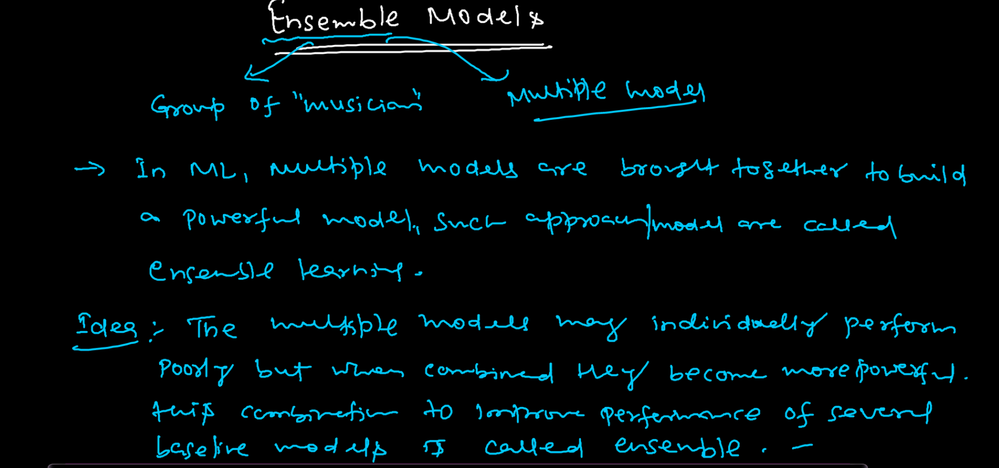

In [ ]:
# Four type of Ensemble learning :-
  # 1. Bagging(Bootstrap aggregation method) - "RandomForest" is the part of bagging
  # 2. Boosting - one of the Boosting is XGBoost
  # 3. Stacking/Voting
  # 4. Cascading

# Thses all four models are high performing model,very powerful,very useful in real world problem.

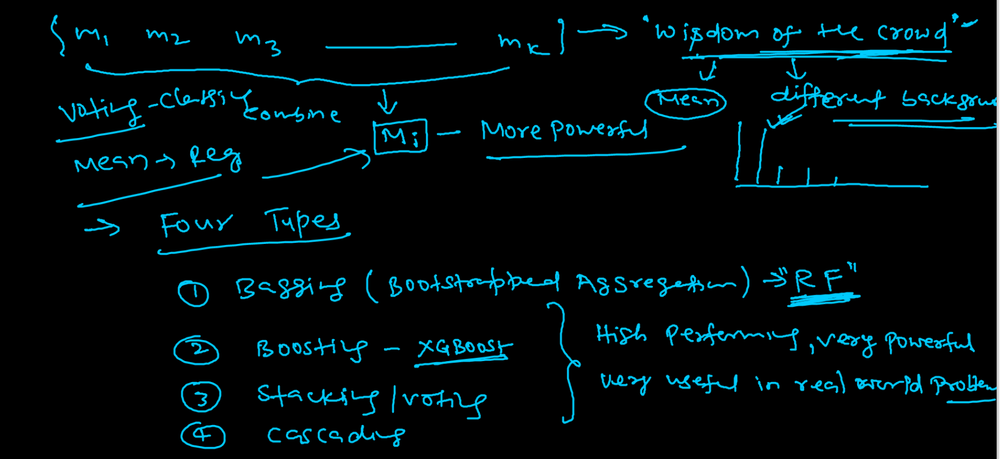

In [ ]:
# key aspect : - The more different the base line models are the better can be combine.

# Problem : - models can be thought of as experts in different aspect of the problem and when brought together, we will get a better solution.


# KNN - clinical sector
# RF/XGB - e-commerce
# naive byes theorm - sentiment analysys or text data
# Logistic - finance and banking more used



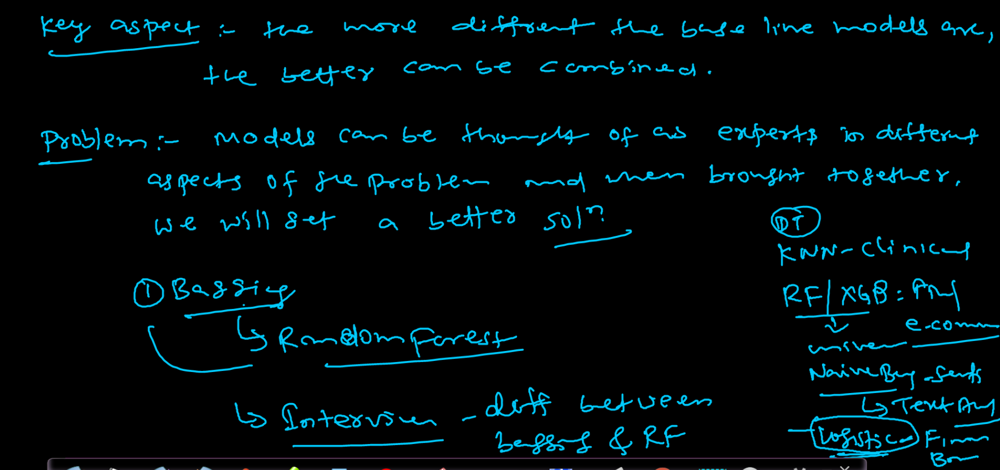

In [ ]:
    # Interview Question

# Difference between bagging and random forest?
# -----> Bagging is the short form of Bootstrap aggregating.
#      --> Bootstrap is a ML ensemble method designed to improve the stability & accuracy of ML algorithm,used for both
#               Regression and Classification problem.It also helps to avoid overfitting problem.

In [ ]:
# Bagging is for handling overfitting problem both Regression and Classification problem.
# boosting is for handling underfitting problem both Regression and Classification problem.

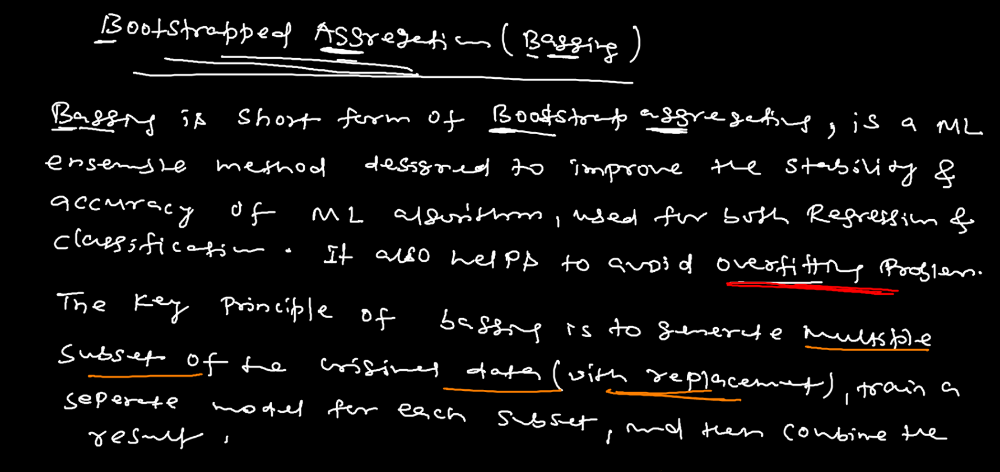

In [ ]:
  # Bagging how it is working :-
  # ----> The key principle of bagging is to generate multiple subset of the original data(with replacement),
  #          train a seperate model for each subset, and then combine the result.

In [ ]:
# Bootstrap means row sampling with replacement

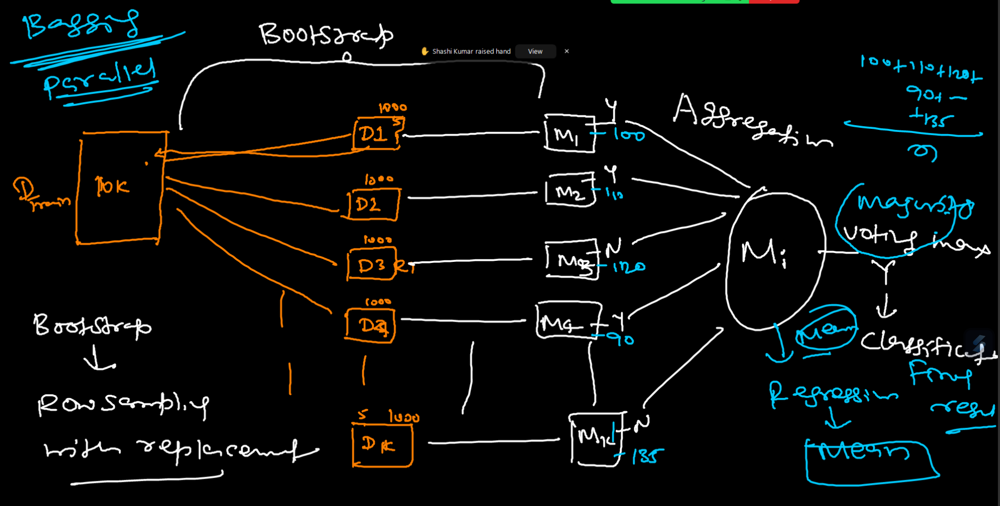

In [ ]:
# Bagging - any algorithm we can take it.

  # Sample - d1,d2,d3...dk
  # Model  - m1,m2,m3...mk

# Difference between bagging and random forest?

# ----> RandomForest - RandomForest whatever sample i will take each sample will make only decision tree.
#    --> Bagging     -  In bagging we are getting a liberty, we can use decision tree,Knn,Logistic etc. If we dont give anything
#                               model will consider decision tree.

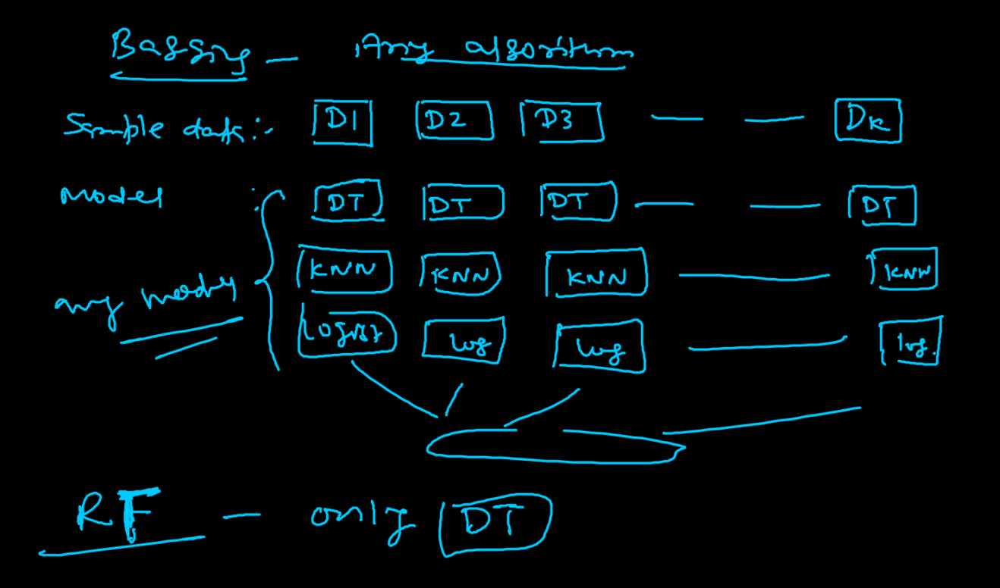

In [ ]:
# Entire machine learning having face this problem
      # Low  bias & high variance (LBHV)
      # High bias & low variance  (HBLV)

  # my objective is to make Low Bias and Low Variance as it is,only we can target High Variance and High Bias
  #         to reduce this so that High Variance become Low Variance and High Bias become Low Bias for that we are using
  #          the bagging and boosting method,that part is called Bias-variance TradeOff.

# Q. what do you mean by Bias-variance Tradeoff?
# ----> Bias - Bias is invrtionally proportional to variance.

          #                         1
          #        Bias     ∝  -------------
          #                       Variance

             # high bias and low variance then use Boosting
             # high variance and low Bias then use Bagging


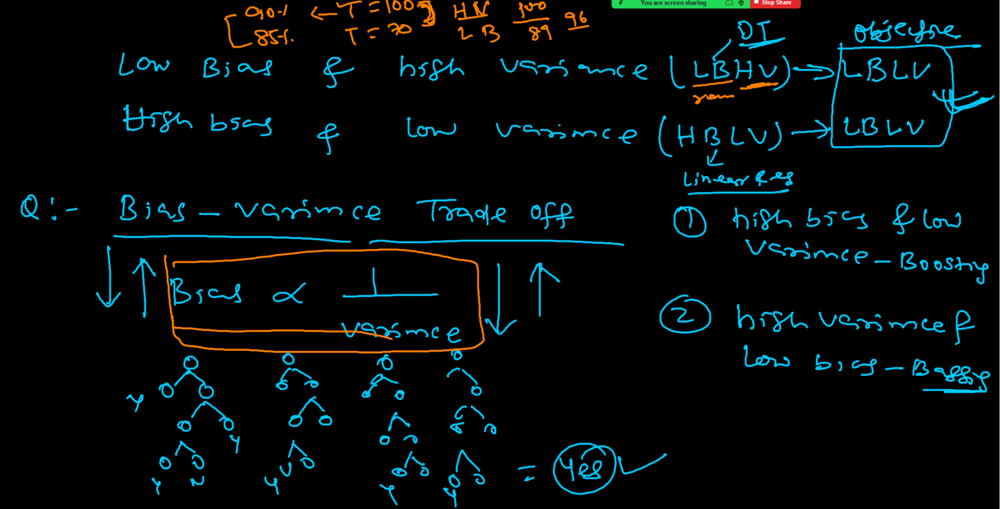

#**Class(19)(RandoForest)(Aug12-2023)**

In [ ]:
# In real world if we know RandomForest and XGB, then 99% job will do  for supervised machine learning

In [ ]:
# Random Forest is a versatile and widely used in ML.
# It belongs to the class of ensemble method.It is type of bagging method which involves training many individual model and combining their output to make final prediction

In [ ]:
# Difference between bagging and random forest?

# ----> RandomForest - RandomForest whatever sample i will take each sample will make only decision tree.
#    --> Bagging     -  In bagging we are getting a liberty, we can use decision tree,Knn,Logistic etc. If we dont give anything
#                               model will consider decision tree.

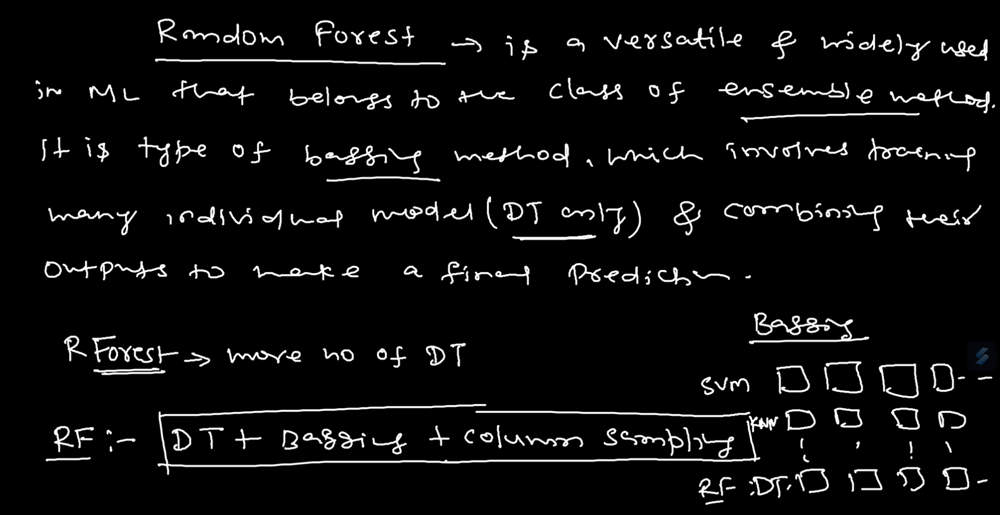

In [ ]:
# Cross Validation :-

# In machine learning, we couldn’t fit the model on the training data and can’t say that the model will work accurately for
# the real data. For this, we must assure that our model got the correct patterns from the data, and it is not getting up too much
# noise. For this purpose, we use the cross-validation technique.



# Cross validation is a technique used in machine learning to evaluate the performance of a model on unseen data. It involves dividing
# the available data into multiple folds or subsets, using one of these folds as a validation set, and training the model on the remaining
# folds. This process is repeated multiple times, each time using a different fold as the validation set. Finally, the results from each validation
# step are averaged to produce a more robust estimate of the model’s performance.

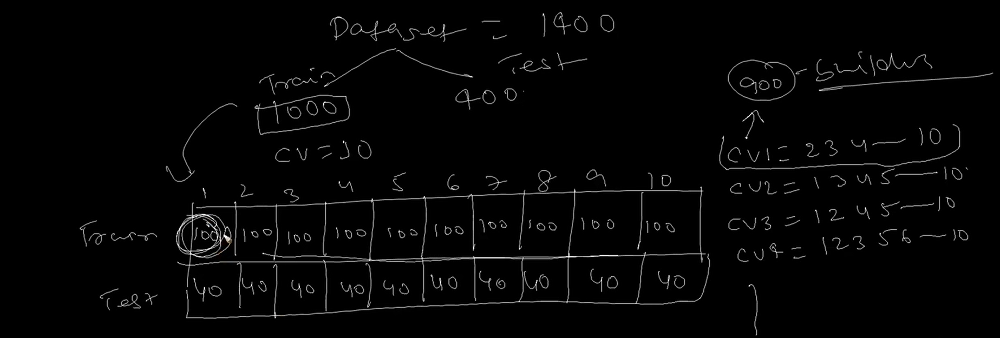

In [ ]:
# Aggregation :-

# In the case of a classification problem, the final output is taken by using the majority voting classifier. In the case of a regression
# problem, the final output is the mean of all the outputs. This part is called Aggregation.


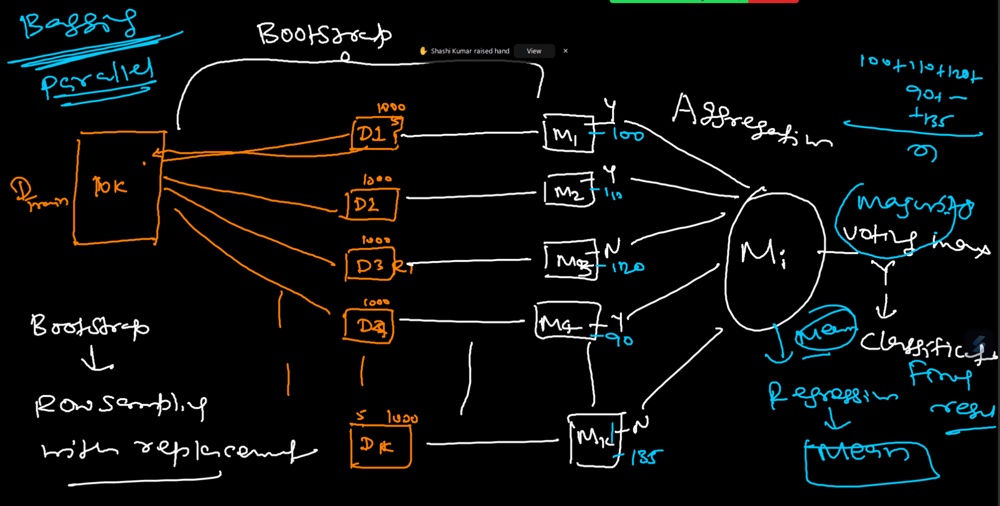

In [ ]:
# Basic package
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set()
import warnings
warnings.filterwarnings('ignore')



In [ ]:
# import the dataset for model building

dataset = pd.read_csv('/content/diabetes.csv')
dataset.head()

In [ ]:
dataset.isnull().sum()

In [ ]:
dataset.describe()

In [ ]:
for col in dataset.columns:
  print("**************************************",col,
        "********************************************")
  print(set(dataset[col].tolist()))
  print()

In [ ]:
# "Glucose" level is not possible to  0
# "BloodPressure" is not possible to 0
# "SkinThickness" is not possible to 0
# "Insulin" is not possible to 0
# "BMI" is not possible to 0


In [ ]:
def boxplots(col):
  sns.boxplot(dataset[col])
  print("**********************************",col,
        "*****************************************")
  print()
  plt.show()

for i in list(dataset.select_dtypes(exclude=['object']).columns)[0:]:
  boxplots(i)

In [ ]:
dataset['Glucose']=np.where(dataset['Glucose']==0,dataset['Glucose'].median(),dataset['Glucose'])
dataset['BloodPressure']=np.where(dataset['BloodPressure']==0,dataset['BloodPressure'].median(),dataset['BloodPressure'])
dataset['SkinThickness']=np.where(dataset['SkinThickness']==0,dataset['SkinThickness'].median(),dataset['SkinThickness'])
dataset['Insulin']=np.where(dataset['Insulin']==0,dataset['Insulin'].median(),dataset['Insulin'])
dataset['BMI']=np.where(dataset['BMI']==0,dataset['BMI'].median(),dataset['BMI'])

In [ ]:
dataset.describe()

In [ ]:
dataset.head()

In [ ]:
dataset['Outcome'].value_counts()

In [ ]:
# split the data into ind and dp variable
x=dataset.iloc[:,:-1]
y=dataset.iloc[:,-1]

In [ ]:
x

In [ ]:
y

In [ ]:
# Balance the data by using SMOTE techniques

import imblearn
from imblearn.over_sampling import SMOTE
smote = SMOTE()
x_smote, y_smote = smote.fit_resample(x, y)
print("Before SMOTE :", y.value_counts())
print()
print("After SMOTE :", y_smote.value_counts())

In [ ]:
# split the data into training and test for model building
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x_smote, y_smote, test_size=0.25, random_state=1, stratify=y_smote)

**Bagging Classifier Model**

In [ ]:
from sklearn.ensemble import BaggingClassifier #if regressor problem is there then import  BaggingRegressor

In [ ]:
# bootstrap means row sampling + aggregation

In [ ]:
bagging=BaggingClassifier() # no any parameter is there so automatically do decision tree model
bagging.fit(x_train,y_train) # x_train,y_train my model has seen this

# here by default gini is there no choice is there but in random forest choice is there.

In [ ]:
y_pred_bagg_train=bagging.predict(x_train)
y_pred_bagg_test=bagging.predict(x_test)  # x_test my model has not seen

In [ ]:
# evaluate the model
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

print(classification_report(y_train, y_pred_bagg_train))
print()
print(classification_report(y_test, y_pred_bagg_test))

In [ ]:
print(accuracy_score(y_train, y_pred_bagg_train))
print()
print(accuracy_score(y_test, y_pred_bagg_test))

# overfitting problem

In [ ]:
bagging_accuracy = accuracy_score(y_test, y_pred_bagg_test)

In [ ]:
from sklearn.tree import plot_tree

In [ ]:
bagging.estimators_

In [ ]:
plt.figure(figsize=(20,18))
plot_tree(bagging.estimators_[1])
plt.show()

**RandomForest Classifier**

In [ ]:
from sklearn.ensemble import RandomForestClassifier #  # if regressor problem is there then import  RandomForestRegressor

In [ ]:
rforest1 = RandomForestClassifier()# by default fix random forest no any base estimator is there like bagging
 # here we can take 100 tree but in bagging only take 10 tree,thats why randomforest give good accuracy
 # criterion - by default take gini but we can use entroy,it etc.
 # max_depth also given but in bagging not there

rforest1 = RandomForestClassifier(n_estimators=500, criterion='entropy',max_depth=2, max_features=2, oob_score=True)
rforest1.fit(x_train, y_train)

In [ ]:
y_pred_rf_train = rforest1.predict(x_train)
y_pred_rf_test = rforest1.predict(x_test)

In [ ]:
rforest1.feature_importances_

In [ ]:
print(accuracy_score(y_train, y_pred_rf_train))
print()
print(accuracy_score(y_test, y_pred_rf_test))

In [ ]:
rf_accuracy = accuracy_score(y_test, y_pred_rf_test)

In [ ]:
# cross validation score
from sklearn.model_selection import cross_val_score
test_accuracy = cross_val_score(rforest1, x_test, y_test, cv=10)
test_accuracy

print("Test mean accuracy :", test_accuracy.mean())
print()
print("Test max accuracy :", test_accuracy.max())

**Approach no 2 - building model with scaled data and without balancing**

In [ ]:
x.head

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
sc_x = sc.fit_transform(x)
sc_x

In [ ]:
# split the data into training and test for model building
x_train, x_test, y_train, y_test = train_test_split(sc_x, y, test_size=0.25, random_state=1, stratify=y)

In [ ]:
rforest2 = RandomForestClassifier(criterion='gini')
rforest2.fit(x_train, y_train)

In [ ]:
y_pred_rf_train = rforest2.predict(x_train)
y_pred_rf_test = rforest2.predict(x_test)

In [ ]:
rforest2.feature_importances_

In [ ]:
# Evaluate the model
print(classification_report(y_train, y_pred_rf_train))
print()
print(classification_report(y_test, y_pred_rf_test))

In [ ]:
print(accuracy_score(y_train, y_pred_rf_train))
print()
print(accuracy_score(y_test, y_pred_rf_test))

In [ ]:
print("Test mean accuracy :", test_accuracy.mean())
print()
print("Test max accuracy :", test_accuracy.max())

**Logistic Regression**

In [ ]:
from sklearn.linear_model import LogisticRegression
logit = LogisticRegression()
logit.fit(x_train, y_train)

In [ ]:
y_pred_logit_train = logit.predict(x_train)
y_pred_logit_test = logit.predict(x_test)

In [ ]:
print(accuracy_score(y_train, y_pred_logit_train))
print()
print(accuracy_score(y_test, y_pred_logit_test))

In [ ]:
logit_accuracy = accuracy_score(y_test, y_pred_logit_test)

**Decision Tree Classifier**

In [ ]:
from sklearn.tree import DecisionTreeClassifier
dtree = DecisionTreeClassifier()
dtree.fit(x_train, y_train)

In [ ]:
y_pred_dt_train = dtree.predict(x_train)
y_pred_dt_test = dtree.predict(x_test)

In [ ]:
print(accuracy_score(y_train, y_pred_dt_train))
print()
print(accuracy_score(y_test, y_pred_dt_test))

**Voting Ensemble method**

In [ ]:
# voting is used when my accuracy between  51% to 70%

In [ ]:
from sklearn.ensemble import VotingClassifier

In [ ]:
evc = VotingClassifier(estimators=[('bagging', bagging),('rforest1', rforest1),('logit', logit) ], voting='soft')

model_evc = evc.fit(x_train, y_train)

In [ ]:
y_pred_evc_train = evc.predict(x_train)
y_pred_evc_test = evc.predict(x_test)

In [ ]:
evc_accuracy = accuracy_score(y_test, y_pred_evc_test)

**Conclusion**

In [ ]:
list1 = ["Bagging","RandomForest","Logistic","Voting"]
list2 = [bagging_accuracy, rf_accuracy,logit_accuracy,evc_accuracy]
final_accuracy = pd.DataFrame({'Method Used':list1, "Accuracy":list2})
print(final_accuracy)

In [ ]:
chart = sns.barplot(x='Method Used', y='Accuracy', data= final_accuracy)
chart.set_xticklabels(chart.get_xticklabels(), rotation=90)
print(chart)

**Gaussian Naive Bayes**

In [ ]:
from sklearn.naive_bayes import GaussianNB

In [ ]:
# GaussianNB
gnb = GaussianNB()
gnb.fit(x_train, y_train)

In [ ]:
y_pred_gnb_train = gnb.predict(x_train)
y_pred_gnb_test = gnb.predict(x_test)

In [ ]:
y_pred_gnb_test

In [ ]:
# Evaluation matrix
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

In [ ]:
print(confusion_matrix(y_train, y_pred_gnb_train))
print()
print(confusion_matrix(y_test, y_pred_gnb_test))

In [ ]:
print(classification_report(y_train, y_pred_gnb_train))
print()
print(classification_report(y_test, y_pred_gnb_test))

In [ ]:
print(accuracy_score(y_train, y_pred_gnb_train))
print()
print(accuracy_score(y_test, y_pred_gnb_test))

In [ ]:
# Cross Validation

from sklearn.model_selection import cross_val_score
train_accuracy=cross_val_score(gnb,x_test,y_test,cv=10)
print(train_accuracy)
print("train accuracy mean ",train_accuracy.mean())
print("Train accuracy max ",train_accuracy.max())
print()
test_accuracy=cross_val_score(gnb,x_test,y_test,cv=10)
print(test_accuracy)
print("test accuracy mean ",test_accuracy.mean())
print("test accuracy max ",test_accuracy.max())

**Bernoulli Naive Bayes**

In [ ]:
from sklearn.naive_bayes import BernoulliNB

In [ ]:
bnb = BernoulliNB()
bnb.fit(x_train, y_train)

In [ ]:
y_pred_bnb_train = bnb.predict(x_train)
y_pred_bnb_test = bnb.predict(x_test)

In [ ]:
print(confusion_matrix(y_train, y_pred_bnb_train))
print()
print(confusion_matrix(y_test, y_pred_bnb_test))

In [ ]:
print(classification_report(y_train, y_pred_bnb_train))
print()
print(classification_report(y_test, y_pred_bnb_test))

In [ ]:
print(accuracy_score(y_train, y_pred_bnb_train))
print()
print(accuracy_score(y_test, y_pred_bnb_test))

#**Class(20)(Overfitting,Underfitting,Data Leakage,Boosting,AdaBoost,Gradient Boosting)(Aug13-2023)**

In [ ]:
#  when we will do real time job, then entire machine learning will face these challenges :-

    #(1) Overfitting problem - high variance

#          ---> we have train dataset and test dataset, train accuracy is very good more then 90% and test accuracy
#                  is 70%, if the train and test variance is coming more then 10% , then we can say high variance problem(overfitting)

#             ------> if high variance(overfitting) is there then have to used RandomForest for best use.
#              -----> high variance problem we can see in Decision tree, support vector machine etc
#           --------> so handiling overfitting(high variance) , we are using bagging method (Bagging method means Low Bias and High Variance(LBHV), objective
#                            of bagging is Low Bias remain Low Bias and High Variance converting into Low Variance)
#             ----------> Random Forest is the part of Bagging.


        # (2) Underfitting  - high Bias

 #                           ------> Train and test accuracy is less then 70%
 #                         for Boosting method we have to handle the Underfitting model

                        # Ada Boost            - not using properly
                        # Gradient Boosting   - most using
                        # XGB                 - most using


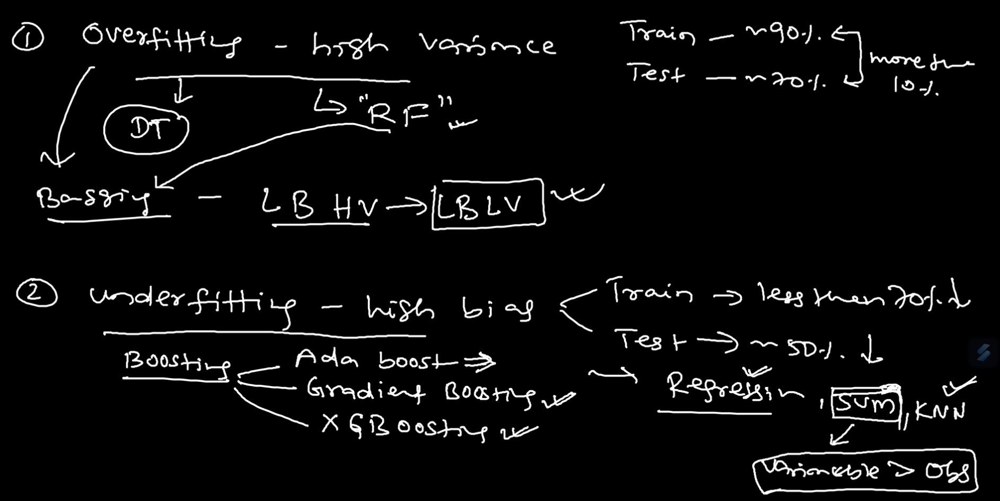

In [ ]:
# (3)  Data Leakage :-

#        we have  Train and test dataset, so normally we are doing merge the train and test data after thet
#         handling the missing value,treating the outlier, Feature scaling etc and after that build the model, and after
#          that we will go for a deployment. in a deployment time we are seeing my accuracy is not good but before deployment the model
#          my accuracy was good, because we are not handled the missing value seperately for  train and test.



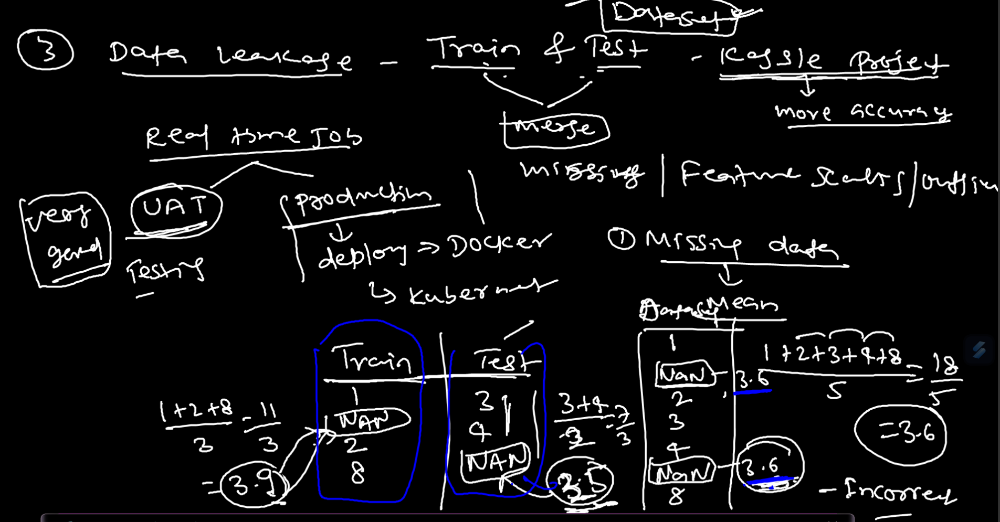

In [ ]:
 #  Feature Scaling :-

       # We have split the data into independent and dependent variable after that building a modelso getting good accuracy
      #because x_train and x_test both are normalized/standarized, but when real time when do a production they will give you without
      #  normalization/standarization data. that is naother reason for Data Leakage

        # Handling :-
       # Before Feature Scaling, do x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.25)  dont pass scale data, now
      # we can do feature scaling only for x_train then we have to bulid a model when we predict we have without scaled data(x_test),
      # so we will not get data leakage problem

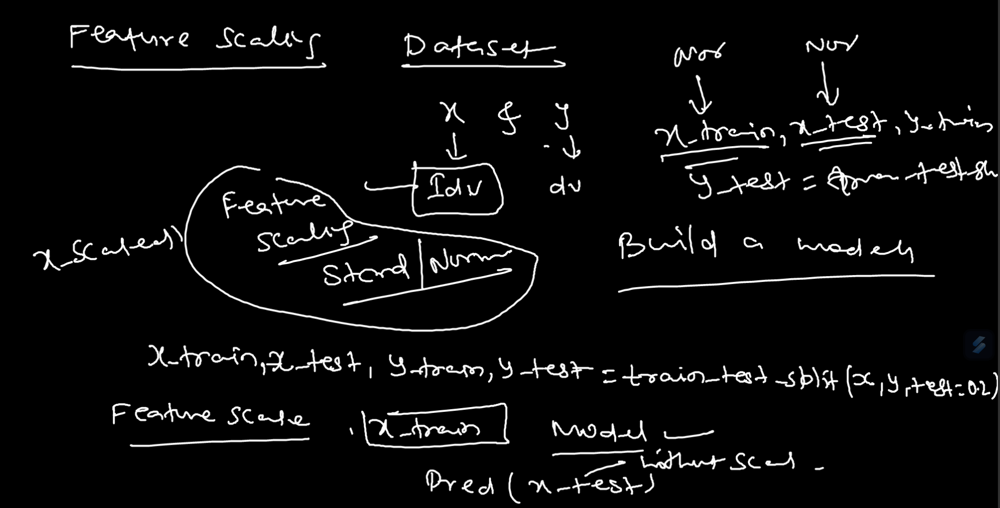

**Boosting :-**

In [ ]:
# whenever we will solve Boosting we will get Low Variance high Bias.

# Boosting(HBLV) is general ensemble method that aims to create a strong classifier or Regressior by
#      combining the predictor of several weaker models.

# The idea is to build the strong model incrementally by sequentially adding weak models that are trained
#    to correct the mistake made by the existing ensemble.

In [ ]:
# Boosting is a sequence model, this will go they will pick one model build it validate the accuracy,if
#    there is a problem another model they will build it , if again there is a problem agin another model they will build it.

#  Objective of Low Bias Low Variance(LBLV)

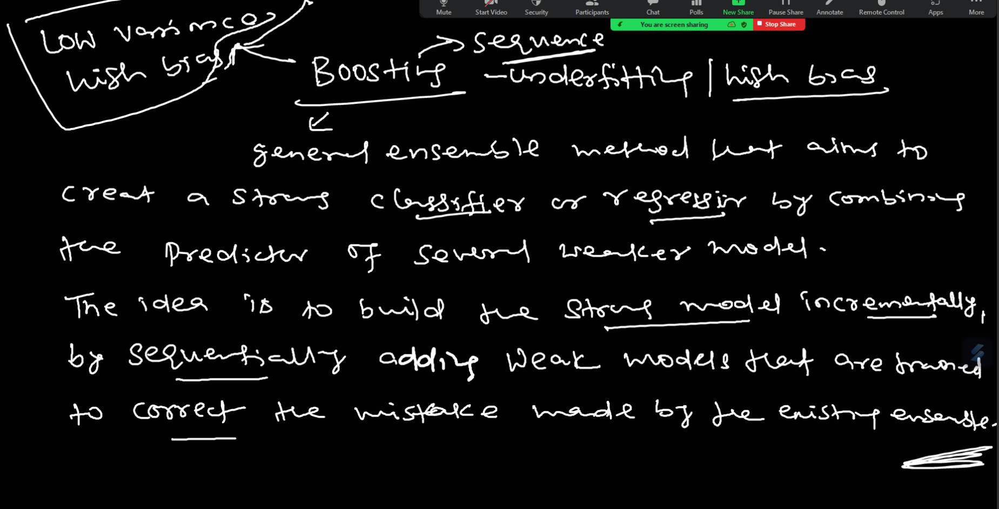

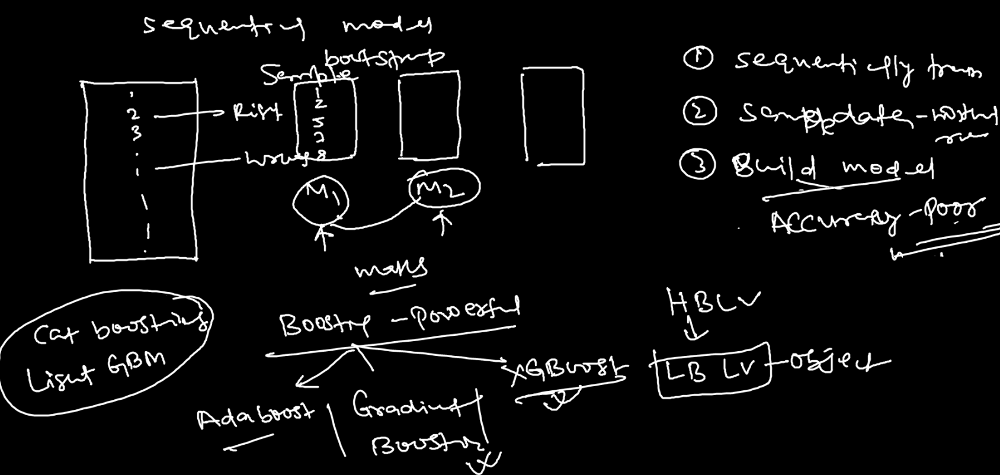

Ada Boost

In [ ]:
# what AdaBoost will do?
# -----> if my model whatever the sample data i will take if we will build the model and when we are predicting that wrongly
#             classified we will increase their weight and which is rightly classified we will reducing their weight and then we are
#             building another model and its keep iterating till then my model classified correctly

In [ ]:
# (1) Weak Learner - minimum accuracy is 51%
# (2) Decision Stamps
# (3) +1(+ve) & -1(-ve)

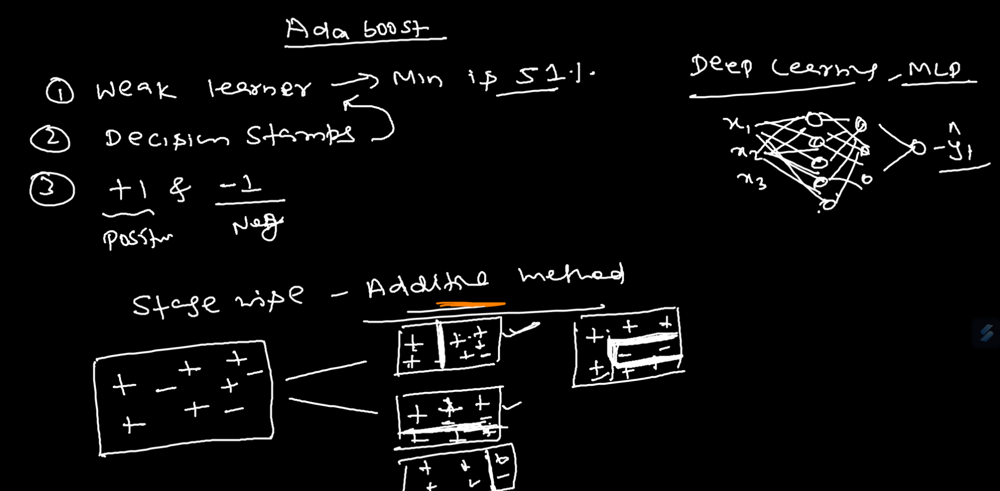

In [ ]:
# -> if my model whatever the sample data i will take if we will build the model and when we are predicting that wrongly
#             classified we will increase their weight and which is rightly classified we will reducing their weight and then we are
#             building another model and its keep iterating till then my model classified correctly

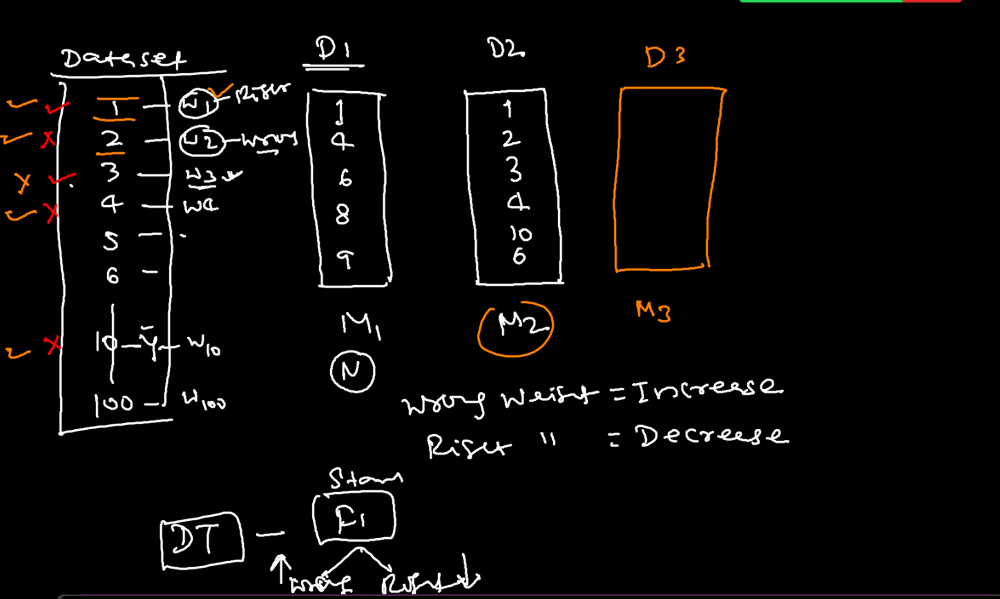

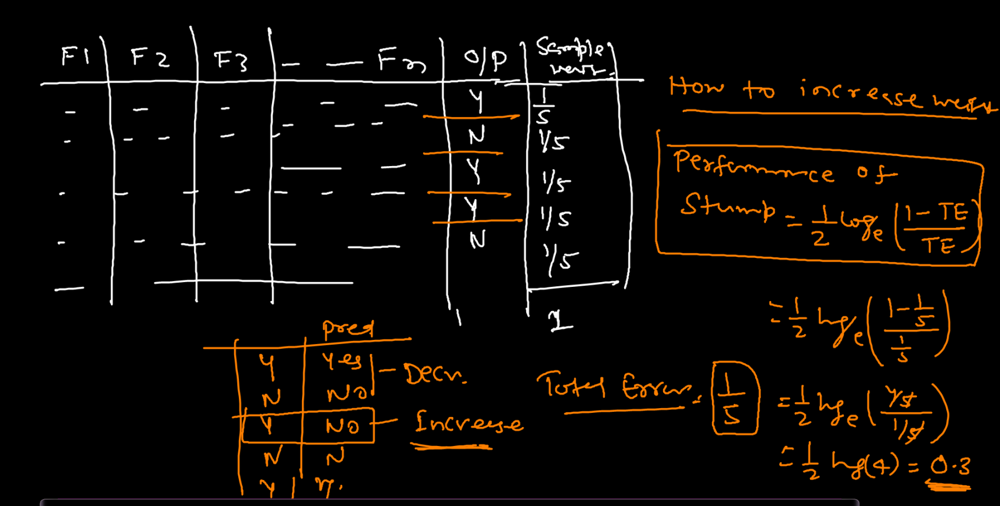

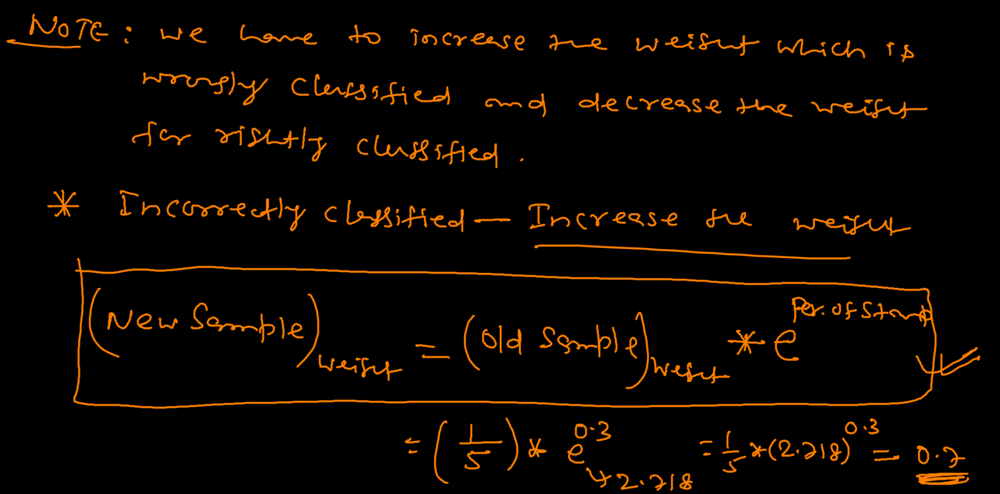

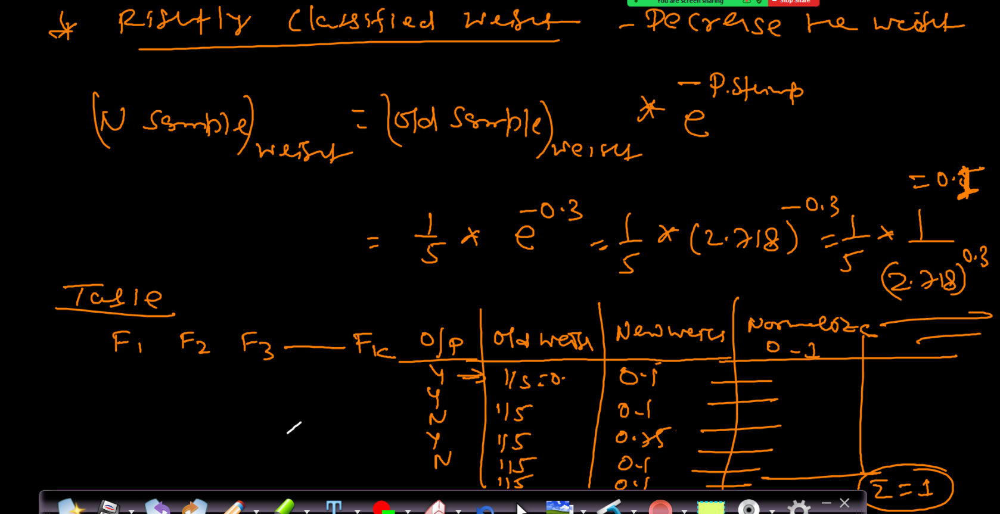

**Gradient Boosting :-**

In [ ]:
# Gradient Boosting is a machine Learning ensemble technique. Aim to built strong predictive model by combining the predictor of several weaker model.

In [ ]:
# This is nothing its a concept of Additive model
  # Additive model is combination of f(x)=f1(x)+f2(x)+f3(x)...
# tipically Gradient boosting is nothing its a decision tree only.
# To understand the gradient boosting we have to understand the Loss function(error), Residual value, Gradient point

In [ ]:
    #### Explain Grdadient boosting :-

# there is a model their and there is a problem their,in the model m1 there is a problem their, we have to take another model
      #  for increase and decrese the weight because we can predict the right answer.so whatever the mistake m1 did it, when i go in
      # the m2, m2 will not make the similar mistake,again m2  whatever mistake  they doing it we are giving information to m3
      # that m2 made such mistake you dont do that, when i will build the model, then i am saying m1,m2,m3 made such mistake you are
      # not suppose to do it so they will correct/rectify. its a iterative method

In [ ]:
# The method works by iteratively  adding model to the ensemble, with each new model trained to correct
#      the mistakes made by the combined ensemble of existing model.

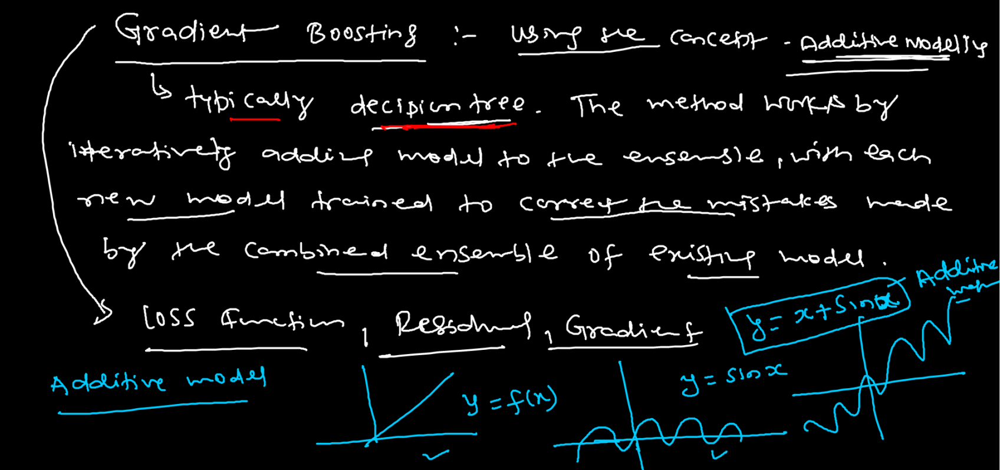

In [ ]:
# Additive model :-

      # f(x)=f1(x)+f2(x)+f3(x)...(additive model)

       # Additive model is combination of f(x)=f1(x)+f2(x)+f3(x)...

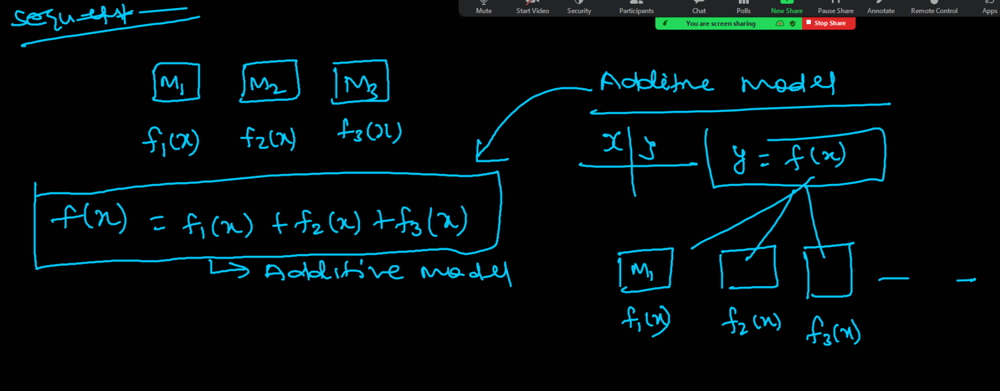

In [ ]:
# understand the gradient boosting

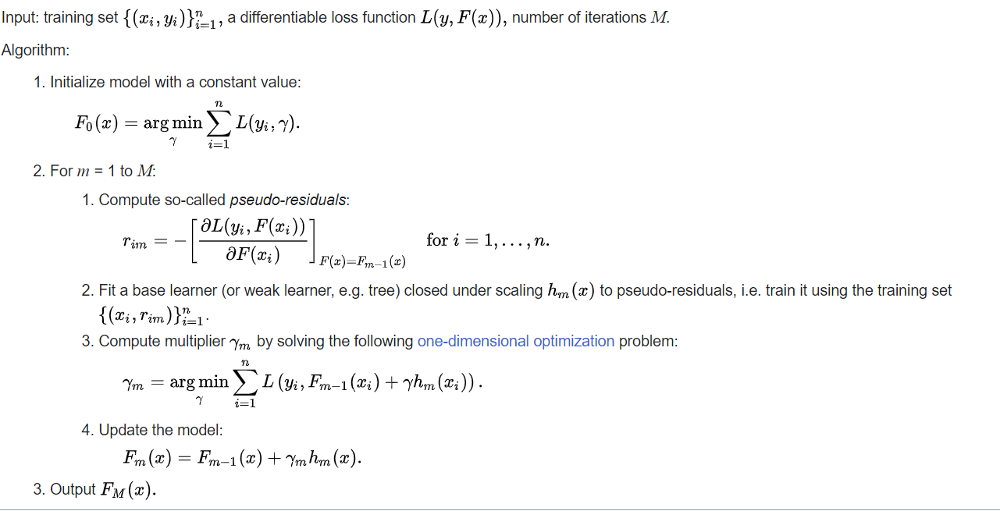

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set()


In [ ]:
df=pd.DataFrame([[165,137,472,192],[101,92,250,144],[29,127,201,91]],
                columns=['R&D','Ops','Marketing','Revenue'])

In [ ]:
df

In [ ]:
df['f0(x)']=df['Revenue'].mean()
# f0(x) is mean

In [ ]:
df

In [ ]:
df['r1']=df['Revenue']-df['f0(x)']

In [ ]:
df

In [ ]:
from sklearn.tree import DecisionTreeRegressor
reg=DecisionTreeRegressor()
reg.fit(df.iloc[:,0:3],df.iloc[:,-1])

In [ ]:
from sklearn.tree import plot_tree
plot_tree(reg)

**Step by Step - Gradient Boosting**

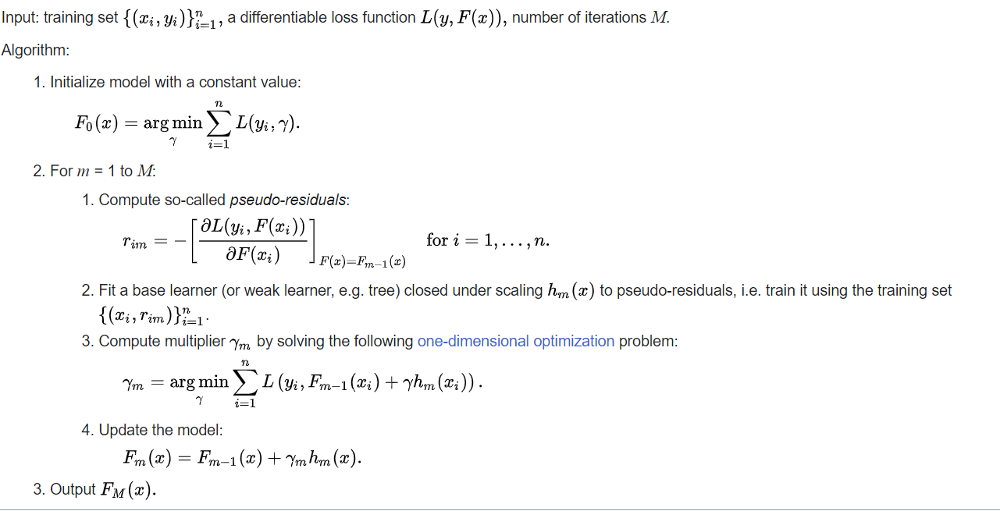

In [ ]:
np.random.seed(42)
x=np.random.rand(100,1) - 0.5

y = 3*x[:, 0]**2 + 0.05 * np.random.randn(100)

In [ ]:
x

In [ ]:
y

In [ ]:
df=pd.DataFrame()
df['x']=x.reshape(100)
df['y']=y

In [ ]:
df

In [ ]:
plt.scatter(df['x'],df['y'])
plt.title('x vs y')

# its non_linear data not a linear data

In [ ]:
# f0(x) is mean
df['pred1']=df['y'].mean()

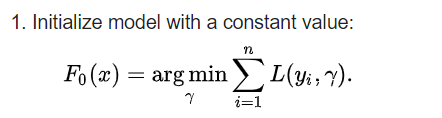

In [ ]:
df
# pred1 is mean

In [ ]:
# pseudo-residual = actual - predicted
#                  = y - pred1

df['res1'] = df['y'] - df['pred1']

# it will give the biggest error

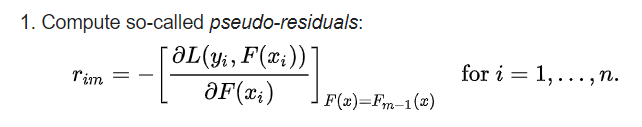

In [ ]:
df

In [ ]:
# maximum Error
plt.scatter(df['x'], df['y'])
plt.plot(df['x'], df['pred1'], color='red')
plt.title('x vs y')

In [ ]:
from sklearn.tree import DecisionTreeRegressor
tree1 = DecisionTreeRegressor(max_leaf_nodes=8)
tree1.fit(df['x'].values.reshape(100,1), df['res1'].values)

In [ ]:
plt.figure(figsize=(15,12))
plot_tree(tree1)
plt.show()

In [ ]:
# f(x)=fo(x)+f1(x)+f2(x)+f3(x)...
 # f0(x)=mean
 # f1(x)=first decisiontree(DT1)
 # f2(x)=second decisiontree(DT2)
 # f3(x)=third decisiontree(DT3)


# f0(x) - constant because its a mean value
# f1(x),f2(x),f3(x) - different

In [ ]:
# generating x_test
x_test = np.linspace(-0.5,0.5,500)

In [ ]:
y_pred = 0.265458 + tree1.predict(x_test.reshape(500,1))

In [ ]:
plt.figure(figsize=(14,4))
plt.subplot(121)
plt.plot(x_test, y_pred, linewidth=2, color='red')
plt.scatter(df['x'], df['y'])
plt.plot(df['x'], df['pred1'], color='red')
plt.title('x vs y')

In [ ]:
df['pred2'] = 0.265458 + tree1.predict(df['x'].values.reshape(100,1))
# Pred2 = pred1 + DT1(f0(x) + f1(x))

In [ ]:
df

In [ ]:
df['res2'] = df['y'] - df['pred2']

In [ ]:
df

In [ ]:
from sklearn.tree import DecisionTreeRegressor
tree2 = DecisionTreeRegressor(max_leaf_nodes=8)
tree2.fit(df['x'].values.reshape(100,1), df['res2'].values)

In [ ]:
y_pred = 0.265458 + sum(regressor.predict(x_test.reshape(-1,1)) for regressor in [tree1, tree2])

In [ ]:
plt.figure(figsize=(14,4))
plt.subplot(121)
plt.plot(x_test, y_pred, linewidth=2, color='red')
plt.scatter(df['x'], df['y'])
plt.plot(df['x'], df['pred1'], color='red')
plt.title('x vs y')

In [ ]:
def gradient_boost(x, y, number, lr, count=1, regs=[], foo=None):
    if number ==0:
        return
    else:
        if count >1:
            y = y - regs[-1].predict(x)
        else:
            foo = y

        tree_reg = DecisionTreeRegressor(max_depth=5, random_state=42)
        tree_reg.fit(x,y)
        regs.append(tree_reg)


        x1 = np.linspace(-0.5,0.5,500)
        y_pred = sum(lr * regressor.predict(x1.reshape(-1,1)) for regressor in regs)

        print(number)
        plt.figure()
        plt.plot(x1, y_pred, linewidth=2)
        plt.plot(x[:, 0], foo, 'r.')
        plt.show()

        gradient_boost(x, y, number -1, lr, count+1, regs, foo=foo)


In [ ]:
np.random.seed(42)
x = np.random.rand(100, 1) - 0.5
y = 3*x[:,0]**2 + 0.05 * np.random.randn(100)
gradient_boost(x, y, 5, lr=1)

#**Class(21)(Naive Bayes Theorem,K-Nearest Neighbors(KNN))(Aug19-2023)**

In [ ]:
# Its a Supervised Machine Learning.
# Its completely Probabilistic approach
# Its completely Classification problem, cant do Regression problem
# Mainley we are using, have a text data(sentiment analysis)

In [ ]:
# Mostly we prefer to use text data when we do sentiment analysis, when we have a text data(character data) prefer to use Naive Bayes Theorem

# Q. Why we are using Naive Bayes theorem for the Machine Learning point of view.
#   -----> its a very simple,elegent,very beautiful model(because easy to see model and understand), useful and powerful,very fast


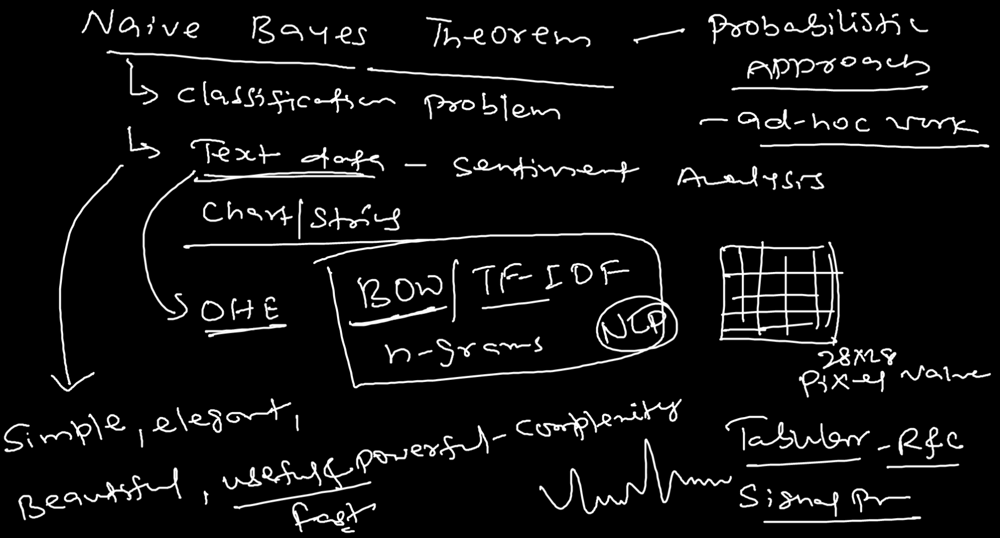

In [ ]:
# Conditional probability : Conditional probability is the probability of one event given the occurence of another event.
# P(A/B) - probability of A when B is given

#  P(A/B) = P(A∩B) / P(B) , where P(B) !=0

    # ∩ - Intersection

# Independence probability : - Two event A and B are statically independent.
 #      P(A∩B) = P(A).P(B)

   # Explain Independent.
    # one ball either six or out any one action happen

  # dependent action :
    # if one ball throw only left 5 ball in a over so this is dependent

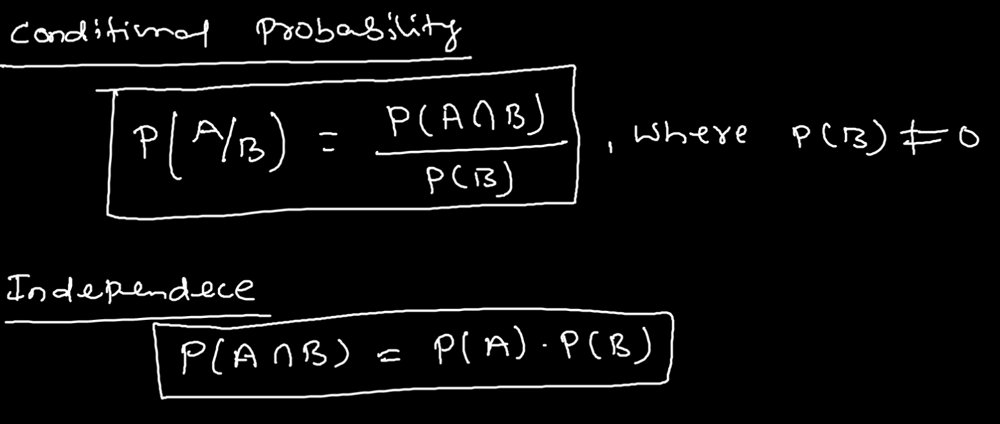

In [ ]:
  # Bayes Theorem :

#  Bayes Theorem is a method to determine conditional probabilities – that is, the probability of one event occurring given that another event has already occurred.

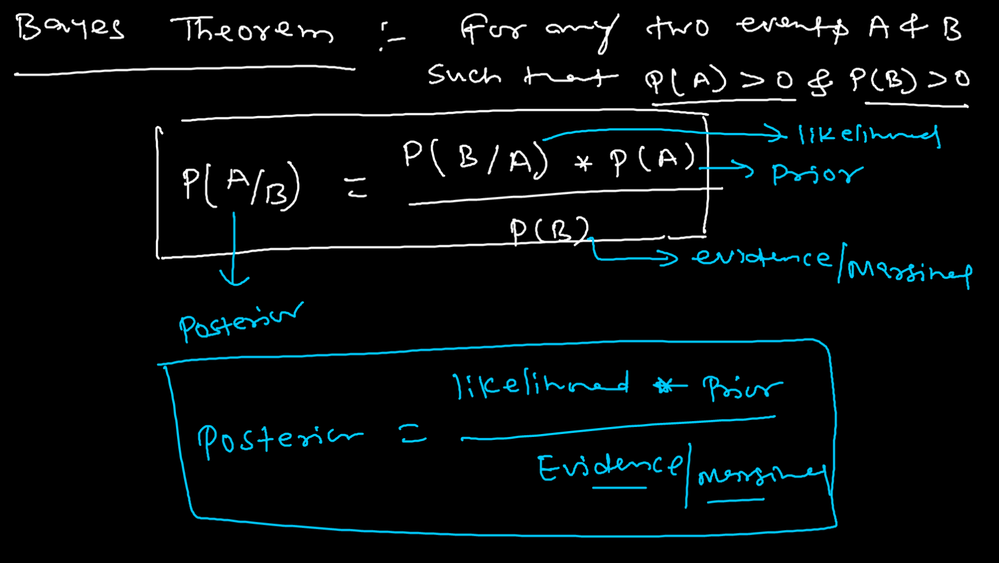

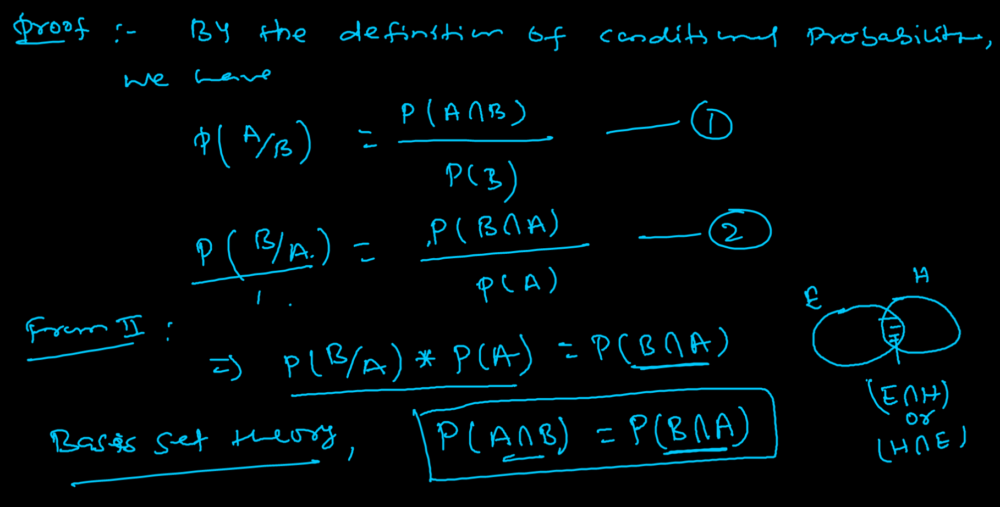

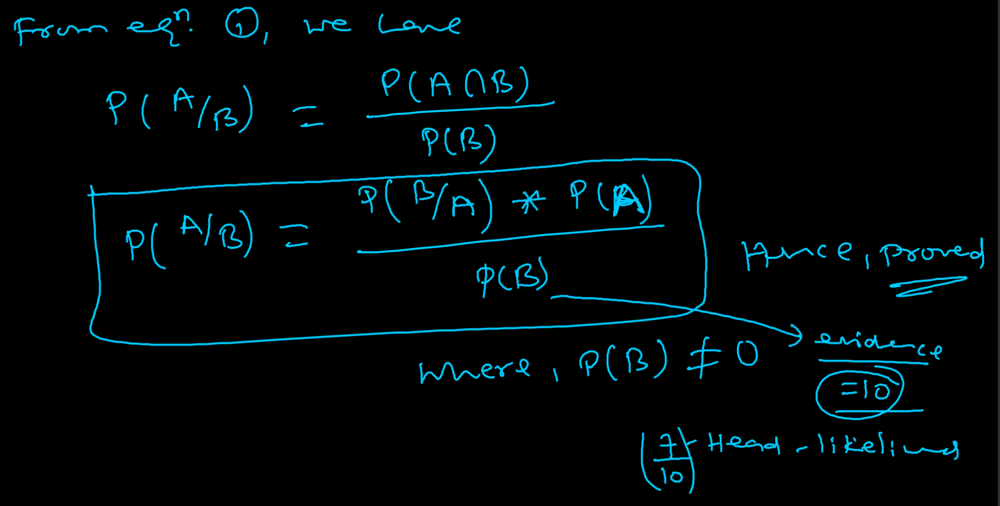

In [ ]:
# Understanding the concept :
#  Idv/(xi) - Independent variable
#  Dv(yi)  - Dependent variable

# we have to predict yi

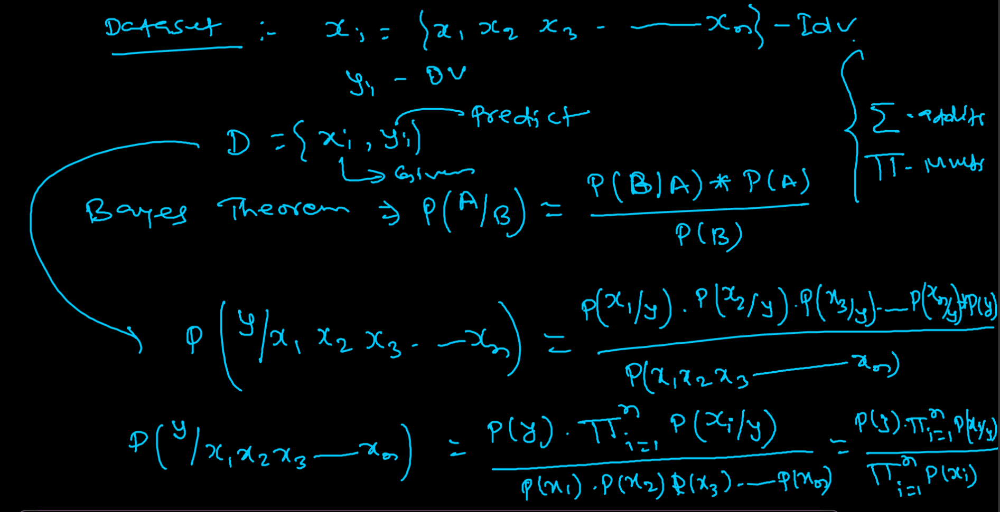

In [ ]:
# Few thing to considered when we have to do Naive Bayes Theorem :

  # Imbalanced dataset - handle it
  # Outlier Treatment  - not required(because its a text data)
  # missing valuue     - you will not get(if text data given), but if there then handled
  # categorical data   - if NAN(will not considered as a missing value,considered as a categorical value) will be there that is also called categorical
  #                       if numerical variable there then NAN is there,we have to handled it.


# if numerical feature there then we have to use Gaussian naive Bayes theorem otherwise go with Bernaulies theorem
# Gaussian naive bayes theorem - 0 or 1 like that coming dependent variable
# Bernaulie                    - Yes or No like that coming dependent variable


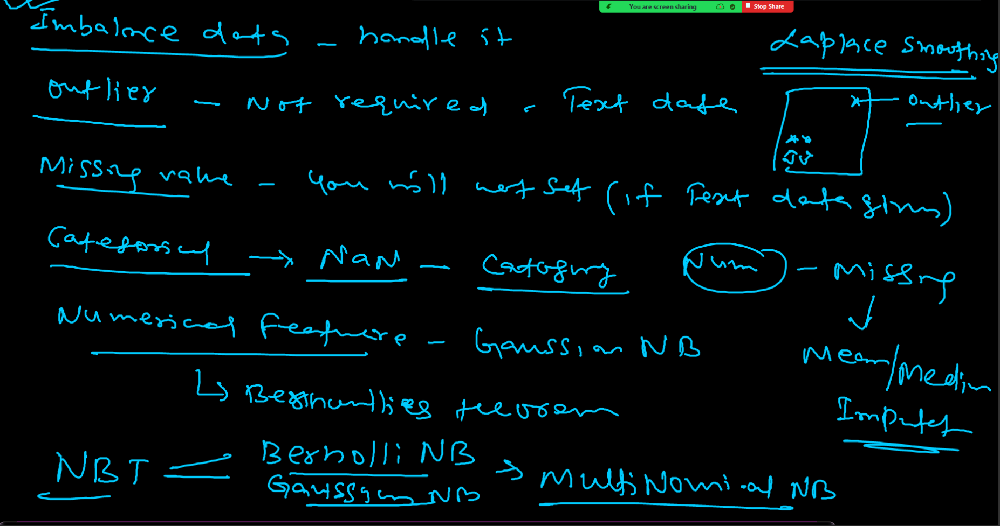

In [ ]:
# Part 1 - Import basic package and dataset
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_csv('spam.tsv', sep='\t')
df.head()

In [ ]:
df.describe()

In [ ]:
df.info()

In [ ]:
df['label'].value_counts()/len(df)*100

In [ ]:
# Data is imbalance, we have to balance it prior building a model

ham = df[df['label']=='ham']
spam = df[df['label']=='spam']

In [ ]:
print(ham.shape)
print(spam.shape)

In [ ]:
# handling imbalance data
spam = spam.sample(ham.shape[0], replace=True)

In [ ]:
print(ham.shape)
print(spam.shape)

In [ ]:
data = ham.append(spam, ignore_index = True)
data.shape

In [ ]:
data.head()

In [ ]:
data.tail()

In [ ]:
# Visualization by using ham and spam dataset
plt.hist(data[data['label']=='ham']['length'], bins=100, alpha=0.3)
plt.hist(data[data['label']=='spam']['length'], bins=100, alpha=0.3)
plt.show()

In [ ]:
plt.hist(data[data['label']=='ham']['punct'], bins=100, alpha=0.8, color='red')
plt.hist(data[data['label']=='spam']['punct'], bins=100, alpha=0.8,color='red')
plt.show()

In [ ]:
data.head(1)

In [ ]:
# We have to convert 'message' into BOW format (Text to Vector)
# ML works with number only


# import re # regular expression
# import nltk # natural language tool kit
# from nltk.corpus import stopwords
# from nltk.stem import WordNetLemmatizer

In [ ]:
# Bag Of Words - data['message'] : Text to Vector
from sklearn.feature_extraction.text import CountVectorizer
#cv = CountVectorizer(max_features=100)
cv = CountVectorizer()
x = cv.fit_transform(data['message']).toarray()
x

In [ ]:
# split the data into training and test for building a model and prediction
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, data['label'], test_size=0.25,
                                                    random_state=101, stratify=data['label'])

In [ ]:
pd.DataFrame(x).shape

In [ ]:
# Building Naive Bayes Theorem
# Gaussian NB
# Bernoulli NB

from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB

**Gaussian NB**

In [ ]:
# GaussianNB
gnb = GaussianNB()
gnb.fit(x_train, y_train)

In [ ]:
y_pred_gnb_train = gnb.predict(x_train)
y_pred_gnb_test = gnb.predict(x_test)

In [ ]:
y_pred_gnb_test

In [ ]:
# Evaluation matrix
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

In [ ]:
print(confusion_matrix(y_train, y_pred_gnb_train))
print()
print(confusion_matrix(y_test, y_pred_gnb_test))

In [ ]:
print(classification_report(y_train, y_pred_gnb_train))
print()
print(classification_report(y_test, y_pred_gnb_test))

In [ ]:
print(accuracy_score(y_train, y_pred_gnb_train))
print()
print(accuracy_score(y_test, y_pred_gnb_test))

**BernoulliNB**

In [ ]:
bnb = BernoulliNB()
bnb.fit(x_train, y_train)

In [ ]:
y_pred_bnb_train = bnb.predict(x_train)
y_pred_bnb_test = bnb.predict(x_test)

In [ ]:
print(confusion_matrix(y_train, y_pred_bnb_train))
print()
print(confusion_matrix(y_test, y_pred_bnb_test))

In [ ]:
print(classification_report(y_train, y_pred_bnb_train))
print()
print(classification_report(y_test, y_pred_bnb_test))

In [ ]:
print(accuracy_score(y_train, y_pred_bnb_train))
print()
print(accuracy_score(y_test, y_pred_bnb_test))

**K-Nearest Neighbors(KNN)**

In [ ]:
# KNN is best model for clinical data. it is also called lazy algorithm.
# it is used for both Regression and classification problem.

In [ ]:
# if we will build KNN model, we can not take hyperparameter K equal to even no, always will take k equal to odd no.


In [ ]:
# How KNN is working?
#   -----> we are finding the nearest value.

In [ ]:
# why famous in clinical sector?
#   -----> Patient is diabeties is or not so we are checking glucose level, if the glucose level is more
#             then 120 we can say they have a diabeties similarly any patient glucose level is more
#               then 120 ,considered as diabeties patient.Here we are using nearest value.



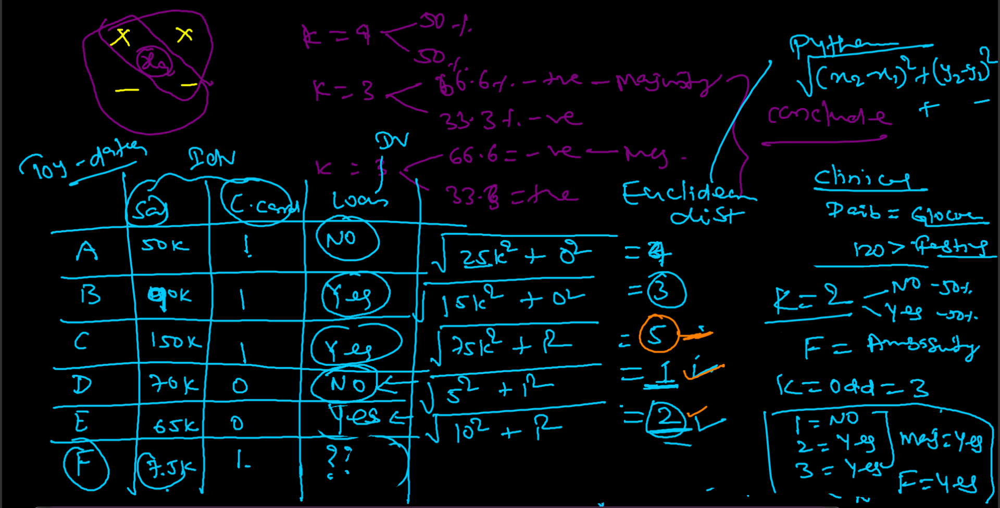

In [ ]:
# Failure cases in KNN :
   # (1) if the point is very far away from the dependent variable, the we can say the that is not the good measurement.
   # (2) jumble between +ve & -Ve, mixed data i have

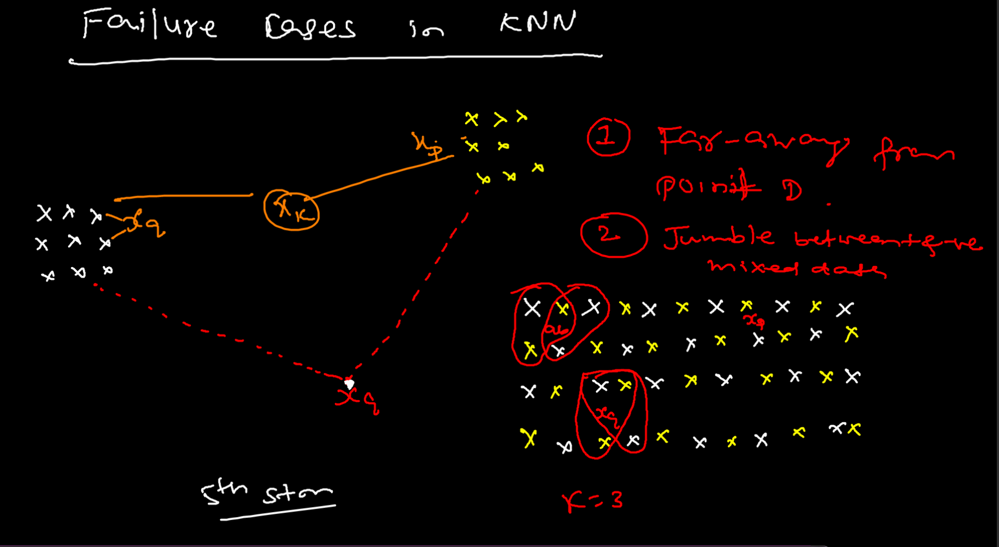

In [ ]:
# Euclidean Distance(L2-Norms):

# Euclidean distance is a widely used distance metric. It works on the principle of the Pythagoras
#  theorem and signifies the shortest distance between two points.

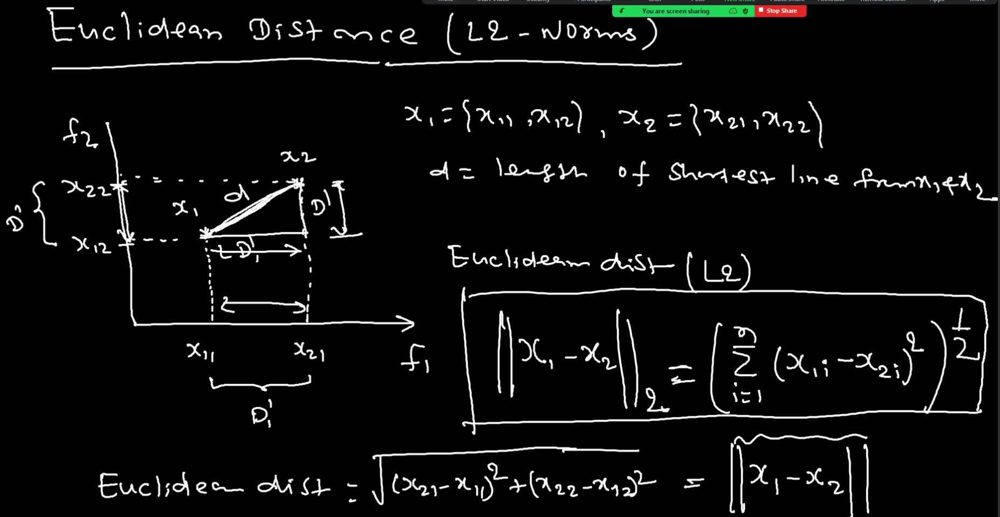

In [ ]:
# manhatten distance(L1-norms) :
    # Manhattan distance is a distance measure that is calculated by taking the sum of distances between the x and y coordinates.

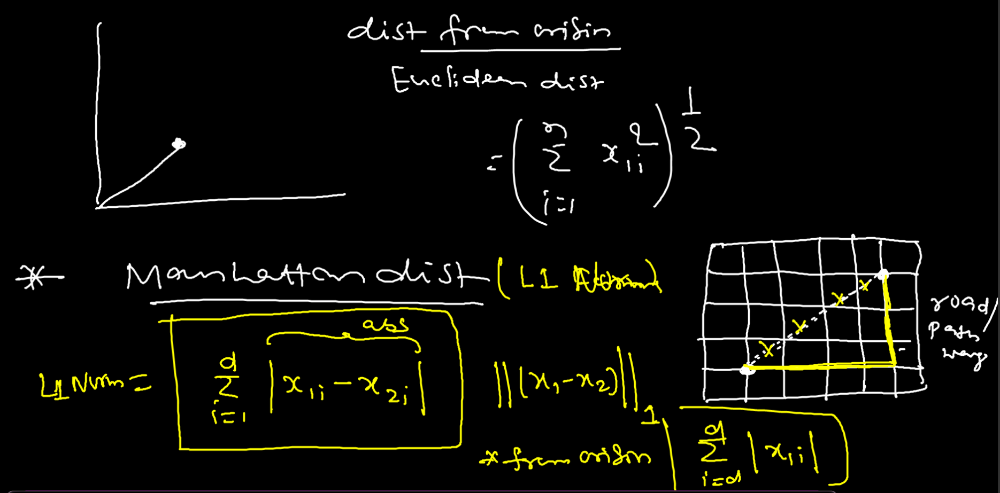

In [ ]:
# minkowski distance(p-norm):
    #  The Minkowski distance or Minkowski metric is a metric in a normed vector space which can be considered as a generalization of both the Euclidean distance and the Manhattan distance.

# if p = 1 that means manhatten distance
# if p=2 that means euclidean distance

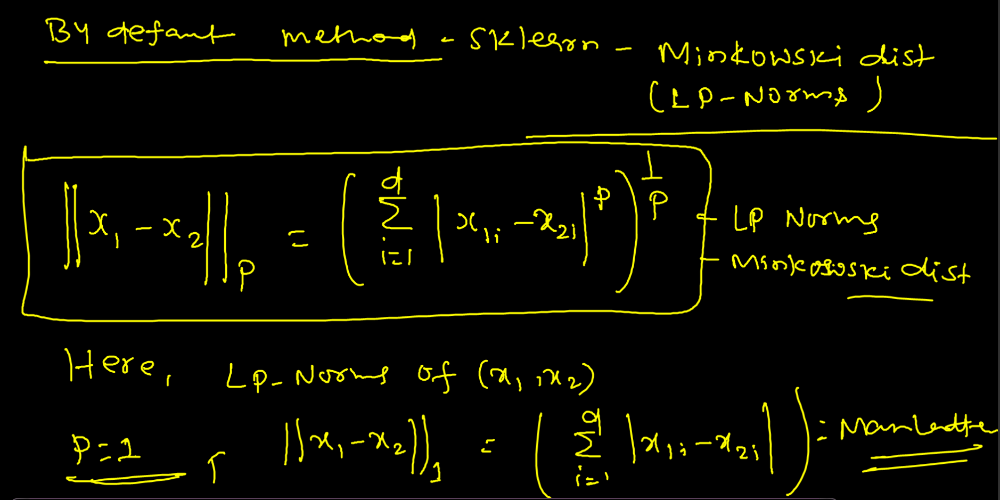

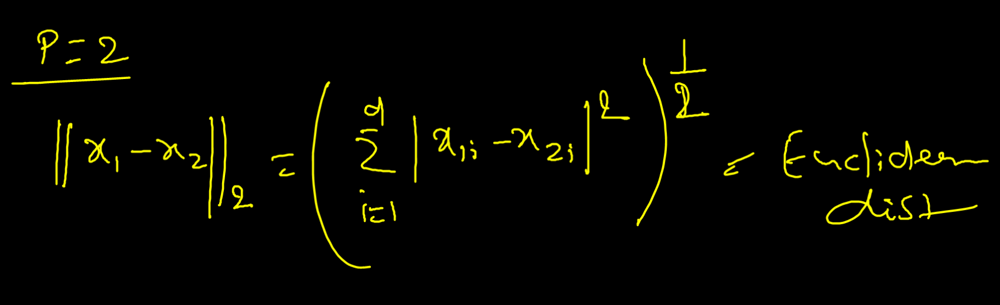

#**Class(22)(K-Nearest Neighbors(KNN),Support Vector Machine(SVM))(Aug20-2023)**

In [ ]:
        # Hamming Distance(Boolean vector) :

  # we can only use the hamming distance when we have a binary data or string data. if number then dont go by this method.

  # Boolean(0,1)
# --> Hamming distance meaning is between x1 and x2 is equal to total number of Location or number of dimension,where binary vector differ(not same) that is called hamming distance.

   # in fig hamming distance =6


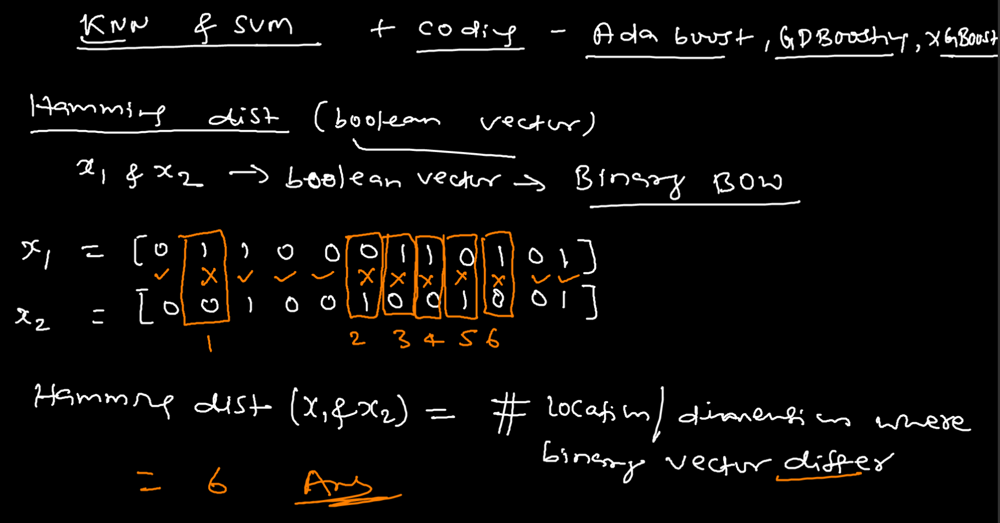

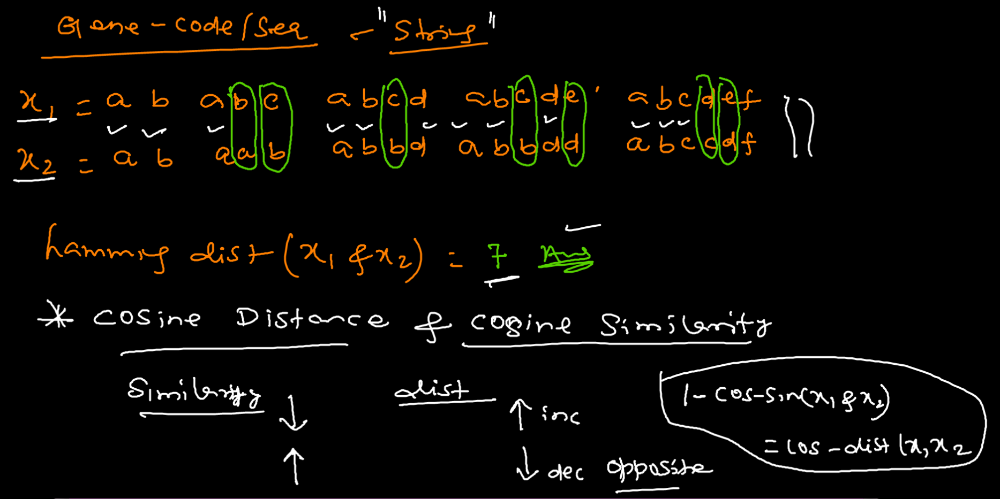

In [ ]:
    # Cosine distance and cosine similarity :

#     Cosine Distance = 1 — Cosine Similarity
# The intuition behind this is that if 2 vectors are perfectly the same then the similarity is 1 (angle=0 hence 𝑐𝑜𝑠(𝜃)=1) and
# thus, distance is 0 (1–1=0).

In [ ]:
# Cosine similarity is used as a metric in different machine learning algorithms like the KNN for determining the
#   distance between the neighbors, in recommendation systems, it is used to recommend movies with the same similarities
#   and for textual data, it is used to find the similarity of texts in the document.

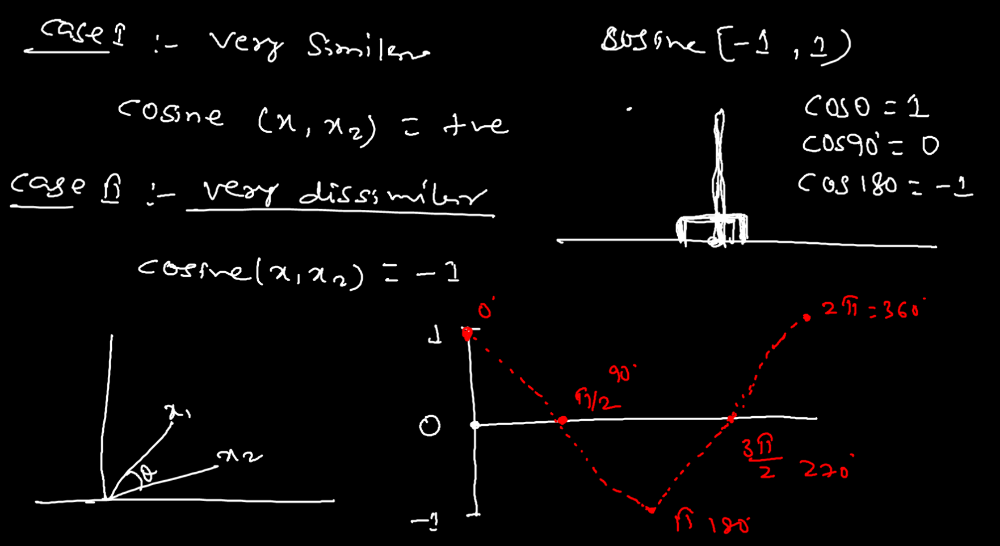

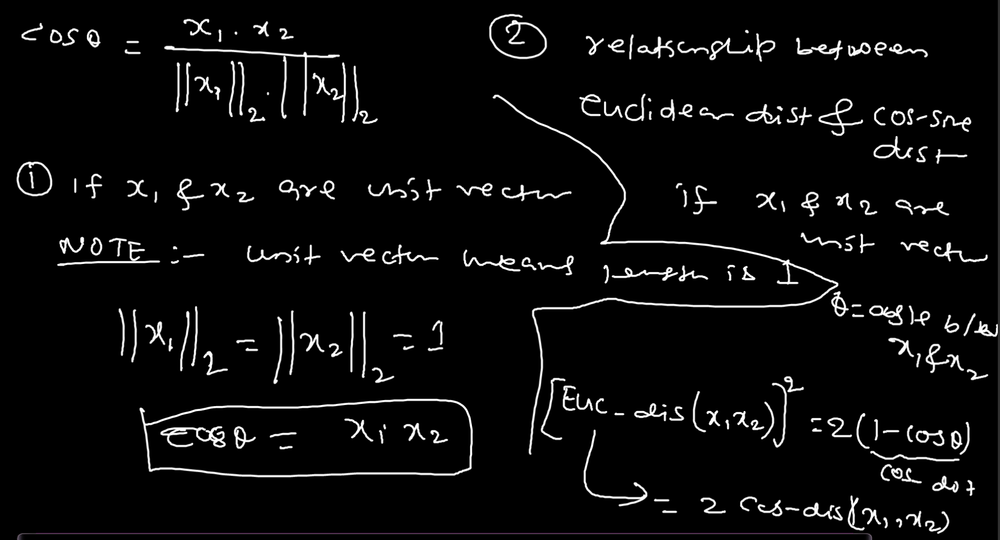

In [ ]:
# KNN - Clinical sector dataset
#       less data(less then 5000)

# knn.fit() machine automatically considered that which model(ball_tree,kd_tree,brute) they have to used,we dont worry about that.
      # Normally 90% time brute only

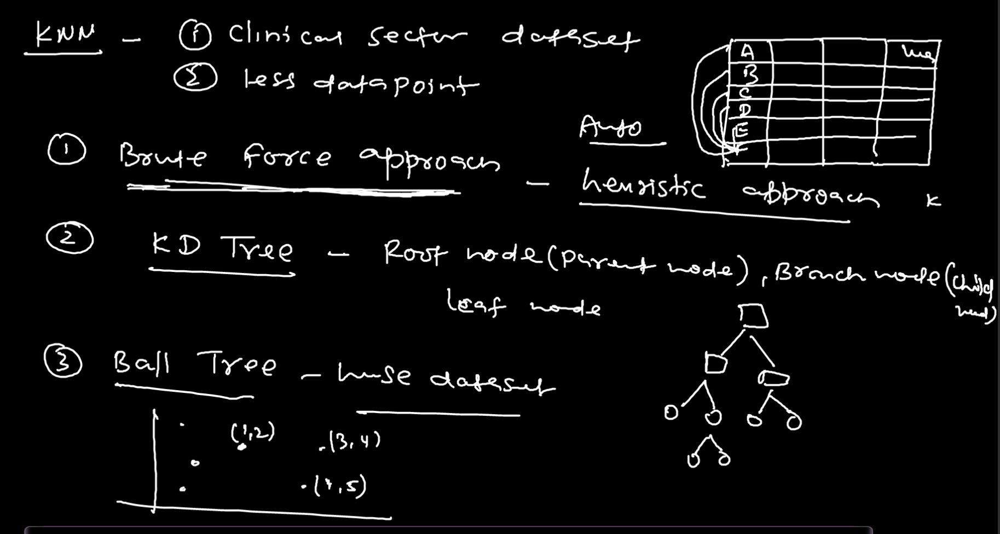

In [ ]:
      #Limitation :

# Large dataset - not give good accuracy, KNN is a lazy learning technique
# high dimension(Features) - not give good accuracy
# Outlier - handle outlier
# Imbalance - do balance


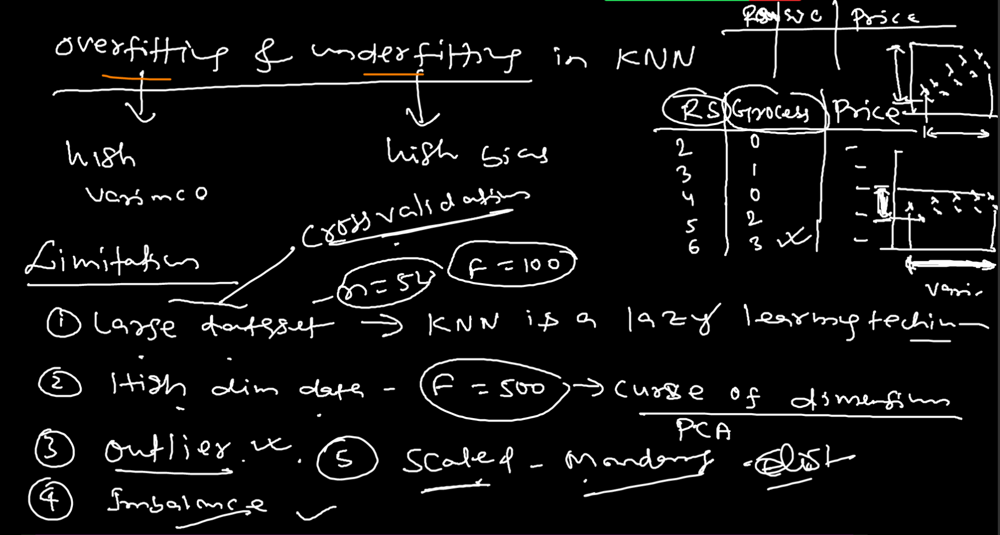

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
sns.set()
%matplotlib inline

In [ ]:
dataset = pd.read_csv('Classified Data', index_col=0)
dataset.head()

In [ ]:
dataset.duplicated().sum()

In [ ]:
dataset.isnull().sum()

In [ ]:
dataset.info()

In [ ]:
dataset.describe()

In [ ]:
# checking imbalance
dataset['TARGET CLASS'].value_counts()

In [ ]:
# split the data into x and y
x = dataset.iloc[:,:-1]
y = dataset.iloc[:,-1]

In [ ]:
x.head()

In [ ]:
y.head()

In [ ]:
# split the data into training and testing
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=101)

In [ ]:
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

**Building KNN Model**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
#knn = KNeighborsClassifier(n_neighbors=5)
#knn.fit(x_train, y_train)
#y_pred = knn.predict(x_test)
#print(y_test)
#print("****************"*10)
#print(y_pred)

**Select the best K value to decide "n_neighbors" basis error_rate**

In [ ]:
error_rate = []

for i in range(1,50):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(x_train, y_train)
    y_pred = knn.predict(x_test)
    error_rate.append(np.mean(y_pred !=y_test))

In [ ]:
error_rate

In [ ]:
plt.figure(figsize=(16,16))
plt.plot(range(1,50), error_rate, color='red', linestyle='dashed', marker='o',
        markersize=12, markerfacecolor='blue')
plt.title("Error Rate vs K-Value")
plt.xlabel("K-Value")
plt.ylabel("Error Rate")
plt.show()

In [ ]:
knn = KNeighborsClassifier(n_neighbors=27)
knn.fit(x_train, y_train)

In [ ]:
y_pred_train = knn.predict(x_train)
y_pred_test = knn.predict(x_test)

In [ ]:
# Evaluate the model
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

In [ ]:
print(confusion_matrix(y_train, y_pred_train))
print("*****************"*10)
print(confusion_matrix(y_test, y_pred_test))

In [ ]:
print(classification_report(y_train, y_pred_train))
print("*****************"*10)
print(classification_report(y_test, y_pred_test))

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test))

**Cross Validation**

In [ ]:
from sklearn.model_selection import cross_val_score

In [ ]:
training_accuracy = cross_val_score(knn, x_train, y_train, cv=10)
test_accuracy = cross_val_score(knn, x_test, y_test, cv=10)
print(training_accuracy)
print("Training Avg Accuracy :",training_accuracy.mean())
print("Training Max Accuracy :",training_accuracy.max())
print("*******************"*10)
print(test_accuracy)
print("Test Avg Accuracy :",test_accuracy.mean())
print("Test Max Accuracy :",test_accuracy.max())

**Support Vector Machine**

In [ ]:
from sklearn.svm import SVC
from sklearn.svm import SVR

In [ ]:
# kernel = 'linear'
svm_linear = SVC(kernel='linear')
svm_linear.fit(x_train, y_train)

In [ ]:
y_pred_train_linear = svm_linear.predict(x_train)
y_pred_test_linear = svm_linear.predict(x_test)

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train_linear))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test_linear))

In [ ]:
# kernel = 'sigmoid'
svm_sigmoid = SVC(C=0.01)
svm_sigmoid.fit(x_train, y_train)

In [ ]:
y_pred_train_sigmoid = svm_sigmoid.predict(x_train)
y_pred_test_sigmoid = svm_sigmoid.predict(x_test)

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train_sigmoid))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test_sigmoid))

In [ ]:
# kernel = 'poly'
svm_poly = SVC(kernel='poly')
svm_poly.fit(x_train, y_train)

In [ ]:
y_pred_train_poly = svm_poly.predict(x_train)
y_pred_test_poly = svm_poly.predict(x_test)

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train_poly))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test_poly))

In [ ]:
# kernel = 'rbf'
svm_rbf = SVC(kernel='rbf')
svm_rbf.fit(x_train, y_train)

In [ ]:
y_pred_train_rbf = svm_rbf.predict(x_train)
y_pred_test_rbf = svm_rbf.predict(x_test)

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train_rbf))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test_rbf))

------------------------------------------------------------End KNN------------------------------------

**SVM(SUPPORT VECTOR MACHINE)**

In [ ]:
# Supervised machine learning.
# It can solve reression and classification problem. but mostly used in classification problem.
# kernal is there in SVM.
# kernal is nothing its a approach(linear,sigmoid,polynomial,rbf ).
# ker

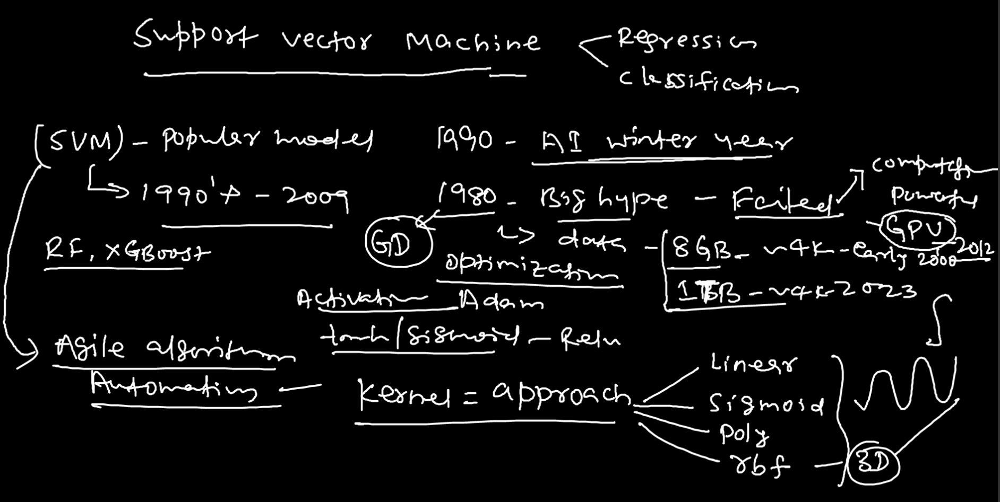

In [ ]:
       # geometrical Institution:
#---> many plane(pie) that seperate the +ve from -ve point.

      # key idea of svm :
    # --> we have to choose the plane thet seperate +ve from -Ve points as "widely" as possible
    #     widely means how far away with equal distance


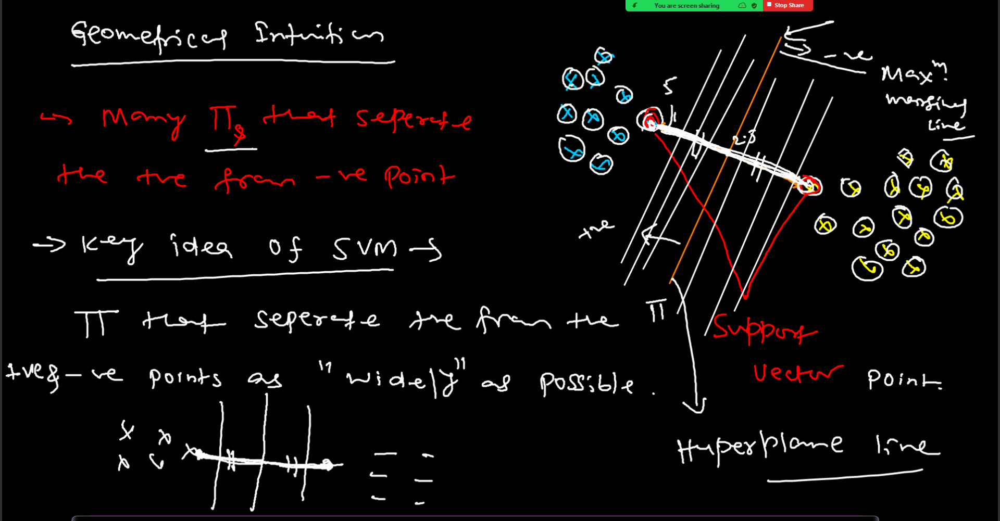

In [ ]:
# SVM, try to find a plane(pie) that maximize the margin = distance from +ve to -ve point.

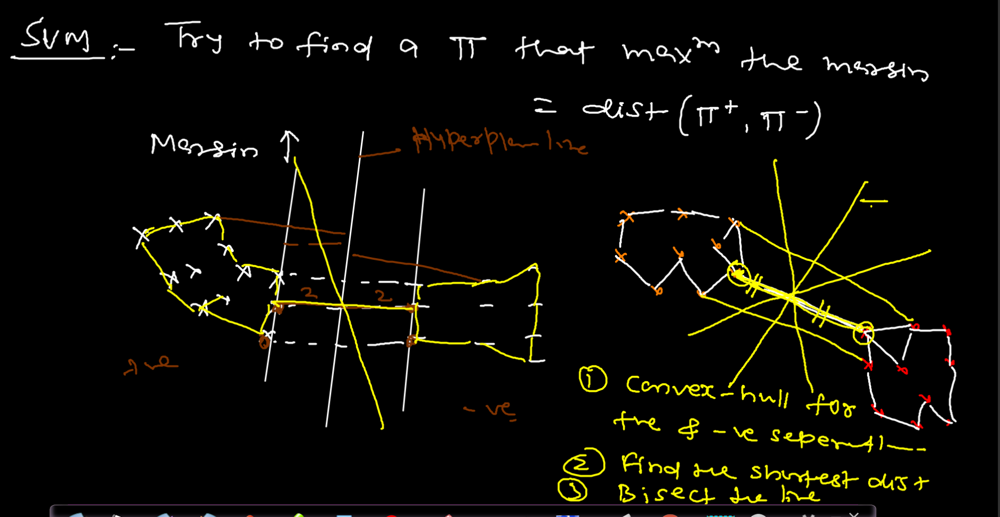

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
sns.set()
%matplotlib inline

In [ ]:
dataset = pd.read_csv('Classified Data', index_col=0)
dataset.head()

In [ ]:
dataset.info()

In [ ]:
dataset.describe()

In [ ]:
dataset['TARGET CLASS'].value_counts()

In [ ]:
# split the data into x and y
x = dataset.iloc[:,:-1]
y = dataset.iloc[:,-1]

In [ ]:
x.head()

In [ ]:
y.head()

In [ ]:
# split the data into training and testing
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=101)

**Support Vector Machine**

In [ ]:
from sklearn.svm import SVC
#from sklearn.svm import SVR # SVR is for regression problem

kernal=linear

In [ ]:
# kernel = 'linear'
svm_linear = SVC(kernel='linear')
svm_linear.fit(x_train, y_train)

In [ ]:
# Evaluate the model
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

In [ ]:
y_pred_train_linear = svm_linear.predict(x_train)
y_pred_test_linear = svm_linear.predict(x_test)

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train_linear))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test_linear))

kernal=sigmoid

In [ ]:
# kernel = 'sigmoid'
svm_sigmoid = SVC(kernel='sigmoid')
svm_sigmoid.fit(x_train, y_train)

# svm_sigmoid = SVC(C=0.01)
# svm_sigmoid.fit(x_train, y_train)

In [ ]:
y_pred_train_sigmoid = svm_sigmoid.predict(x_train)
y_pred_test_sigmoid = svm_sigmoid.predict(x_test)

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train_sigmoid))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test_sigmoid))

In [ ]:
# here i am getting very pathetic result 51 and 46 percent.
# if we are getting overfitting problem then we have to give hyperparameter means change c value and handle the overfitting problem.
# through c we can handle underfitting and overfitting problem.
# c is nothing its a hinge loss
# maximum c value we can take 1.0(100%).
# the hinge loss is a loss function used for training classifiers. The hinge loss is used for "maximum-margin" classification, most notably for support vector machines (SVMs).



     # 1. we have to give c value and sigmoid is also there then check accuracy.

# svm_sigmoid = SVC(c=0.02,kernel='sigmoid')
# svm_sigmoid.fit(x_train, y_train)

#       still again getting very pathetic result 46 and 51 percent


#      2.now c=0.05 and kernal=sigmoid

# svm_sigmoid = SVC(c=0.02,kernel='sigmoid')
# svm_sigmoid.fit(x_train, y_train)

#     still getting pathetic result, c is not impacting.because kernal is not appreaciting


#         3.now we have to give only c value not give kernal

# svm_sigmoid = SVC(c=0.5)
# svm_sigmoid.fit(x_train, y_train)

#     now getting good accuracy more then 95%,both train and test


kernal=poly

In [ ]:
# kernel = 'poly'
svm_poly = SVC(kernel='poly')
svm_poly.fit(x_train, y_train)

In [ ]:
y_pred_train_poly = svm_poly.predict(x_train)
y_pred_test_poly = svm_poly.predict(x_test)

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train_poly))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test_poly))

kernal=rbf

In [ ]:
# kernel = 'rbf'
svm_rbf = SVC(kernel='rbf')
svm_rbf.fit(x_train, y_train)

In [ ]:
y_pred_train_rbf = svm_rbf.predict(x_train)
y_pred_test_rbf = svm_rbf.predict(x_test)

In [ ]:
print("Training Accuracy :", accuracy_score(y_train, y_pred_train_rbf))
print("*****************"*10)
print("Test Accuracy :",accuracy_score(y_test, y_pred_test_rbf))

#**Class(23)(AdaBoost,GradientBoosting,XGBClassifier,SVM,code only,HyperParameter tuning)(Aug26-2023)**

In [ ]:
#!pip install xbgoost

In [ ]:
# make necessary imports
import warnings
warnings.filterwarnings('ignore')

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set()

from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score


In [ ]:
dataset = pd.read_csv('/content/kidney_disease.csv')
dataset.head()

,id,age,bp,sg,al,su,rbc,pc,pcc,ba,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
0,0,48.0,80.0,1.020,1.0,0.0,NaN,normal,notpresent,notpresent,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,1,7.0,50.0,1.020,4.0,0.0,NaN,normal,notpresent,notpresent,...,38,6000,NaN,no,no,no,good,no,no,ckd
2,2,62.0,80.0,1.010,2.0,3.0,normal,normal,notpresent,notpresent,...,31,7500,NaN,no,yes,no,poor,no,yes,ckd
3,3,48.0,70.0,1.005,4.0,0.0,normal,abnormal,present,notpresent,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,4,51.0,0.0,1.010,2.0,0.0,normal,normal,notpresent,notpresent,...,35,7300,4.6,no,no,no,good,no,no,ckd


In [ ]:
# Find null values in our dataset
dataset.isnull().sum()/len(dataset)*100

id                 0.00
age                2.25
bp                 3.00
sg                11.75
al                11.50
su                12.25
rbc               38.00
pc                16.25
pcc                1.00
ba                 1.00
bgr               11.00
bu                 4.75
sc                 4.25
sod               21.75
pot               22.00
hemo              13.00
pcv               17.50
wc                26.25
rc                32.50
htn                0.50
dm                 0.50
cad                0.50
appet              0.25
pe                 0.25
ane                0.25
classification     0.00
dtype: float64

In [ ]:
dataset.dtypes

id                  int64
age               float64
bp                float64
sg                float64
al                float64
su                float64
rbc                object
pc                 object
pcc                object
ba                 object
bgr               float64
bu                float64
sc                float64
sod               float64
pot               float64
hemo              float64
pcv                object
wc                 object
rc                 object
htn                object
dm                 object
cad                object
appet              object
pe                 object
ane                object
classification     object
dtype: object

In [ ]:
dataset.describe()

,id,age,bp,sg,al,su,bgr,bu,sc,sod,pot,hemo
count,400.000000,391.000000,388.000000,353.000000,354.000000,351.000000,356.000000,381.000000,383.000000,313.000000,312.000000,348.000000
mean,199.500000,51.483376,76.082474,1.017408,1.016949,0.450142,148.036517,57.425722,3.072454,137.528754,4.627244,12.474713
std,115.614301,17.169714,14.736739,0.005717,1.352679,1.099191,79.281714,50.503006,5.741126,10.408752,3.193904,3.040816
min,0.000000,2.000000,0.000000,1.005000,0.000000,0.000000,22.000000,1.500000,0.400000,4.500000,2.500000,0.000000
25%,99.750000,42.000000,70.000000,1.010000,0.000000,0.000000,99.000000,27.000000,0.900000,135.000000,3.800000,10.300000
50%,199.500000,55.000000,80.000000,1.020000,0.000000,0.000000,121.000000,42.000000,1.300000,138.000000,4.400000,12.650000
75%,299.250000,64.500000,80.000000,1.020000,2.000000,0.000000,163.000000,66.000000,2.800000,142.000000,4.900000,15.000000
max,399.000000,90.000000,180.000000,1.025000,5.000000,5.000000,490.000000,391.000000,76.000000,163.000000,47.000000,17.800000


In [ ]:
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer

In [ ]:
imputer1 = SimpleImputer(strategy='mean')
imputer2 = SimpleImputer(strategy='median')
imputer3 = SimpleImputer(strategy='most_frequent')
#imputer4 = SimpleImputer(strategy='constant')

In [ ]:
dataset.columns

Index(['id', 'age', 'bp', 'sg', 'al', 'su', 'rbc', 'pc', 'pcc', 'ba', 'bgr',
       'bu', 'sc', 'sod', 'pot', 'hemo', 'pcv', 'wc', 'rc', 'htn', 'dm', 'cad',
       'appet', 'pe', 'ane', 'classification'],
      dtype='object')

In [ ]:
trf = ColumnTransformer([('imputer1', imputer1,['age','bp','sg','al','su','sod','pot', 'hemo']),
                         ('imputer2', imputer2, ['bgr','bu','sc']),
                         ('imputer3', imputer3,['rbc', 'pc', 'pcc', 'ba','pcv', 'wc', 'rc', 'htn', 'dm', 'cad','appet', 'pe', 'ane']),
                         ],
                          remainder='passthrough')

In [ ]:
dataset1 = dataset.copy()
dataset1.head()

,id,age,bp,sg,al,su,rbc,pc,pcc,ba,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
0,0,48.0,80.0,1.020,1.0,0.0,NaN,normal,notpresent,notpresent,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,1,7.0,50.0,1.020,4.0,0.0,NaN,normal,notpresent,notpresent,...,38,6000,NaN,no,no,no,good,no,no,ckd
2,2,62.0,80.0,1.010,2.0,3.0,normal,normal,notpresent,notpresent,...,31,7500,NaN,no,yes,no,poor,no,yes,ckd
3,3,48.0,70.0,1.005,4.0,0.0,normal,abnormal,present,notpresent,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,4,51.0,0.0,1.010,2.0,0.0,normal,normal,notpresent,notpresent,...,35,7300,4.6,no,no,no,good,no,no,ckd


In [ ]:
dataset1 = dataset1.drop(['id'], axis=1)

In [ ]:
df_imputed = pd.DataFrame(trf.fit_transform(dataset1))
#df_imputed.columns = dataset1.columns
df_imputed

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,48.0,80.0,1.02,1.0,0.0,137.528754,4.627244,15.4,121.0,36.0,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,7.0,50.0,1.02,4.0,0.0,137.528754,4.627244,11.3,121.0,18.0,...,38,6000,5.2,no,no,no,good,no,no,ckd
2,62.0,80.0,1.01,2.0,3.0,137.528754,4.627244,9.6,423.0,53.0,...,31,7500,5.2,no,yes,no,poor,no,yes,ckd
3,48.0,70.0,1.005,4.0,0.0,111.0,2.5,11.2,117.0,56.0,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,51.0,0.0,1.01,2.0,0.0,137.528754,4.627244,11.6,106.0,26.0,...,35,7300,4.6,no,no,no,good,no,no,ckd
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,55.0,80.0,1.02,0.0,0.0,150.0,4.9,15.7,140.0,49.0,...,47,6700,4.9,no,no,no,good,no,no,notckd
396,42.0,70.0,1.025,0.0,0.0,141.0,3.5,16.5,75.0,31.0,...,54,7800,6.2,no,no,no,good,no,no,notckd
397,12.0,80.0,1.02,0.0,0.0,137.0,4.4,15.8,100.0,26.0,...,49,6600,5.4,no,no,no,good,no,no,notckd
398,17.0,60.0,1.025,0.0,0.0,135.0,4.9,14.2,114.0,50.0,...,51,7200,5.9,no,no,no,good,no,no,notckd


In [ ]:
df_imputed.columns = ['age','bp','sg','al','su','sod','pot', 'hemo','bgr','bu','sc','rbc', 'pc', 'pcc', 'ba','pcv', 'wc', 'rc', 'htn', 'dm', 'cad','appet', 'pe', 'ane','classification']

In [ ]:
df_imputed.head()

,age,bp,sg,al,su,sod,pot,hemo,bgr,bu,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
0,48.0,80.0,1.02,1.0,0.0,137.528754,4.627244,15.4,121.0,36.0,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,7.0,50.0,1.02,4.0,0.0,137.528754,4.627244,11.3,121.0,18.0,...,38,6000,5.2,no,no,no,good,no,no,ckd
2,62.0,80.0,1.01,2.0,3.0,137.528754,4.627244,9.6,423.0,53.0,...,31,7500,5.2,no,yes,no,poor,no,yes,ckd
3,48.0,70.0,1.005,4.0,0.0,111.0,2.5,11.2,117.0,56.0,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,51.0,0.0,1.01,2.0,0.0,137.528754,4.627244,11.6,106.0,26.0,...,35,7300,4.6,no,no,no,good,no,no,ckd


In [ ]:
dataset1['ane'].value_counts()

no     339
yes     60
Name: ane, dtype: int64

In [ ]:
df_imputed['ane'].value_counts()

no     340
yes     60
Name: ane, dtype: int64

In [ ]:
dataset1.shape

(400, 25)

In [ ]:
#df_imputed.columns = dataset.columns
df_imputed.shape

(400, 25)

In [ ]:
df_imputed.isnull().sum()

age               0
bp                0
sg                0
al                0
su                0
sod               0
pot               0
hemo              0
bgr               0
bu                0
sc                0
rbc               0
pc                0
pcc               0
ba                0
pcv               0
wc                0
rc                0
htn               0
dm                0
cad               0
appet             0
pe                0
ane               0
classification    0
dtype: int64

In [ ]:
# Finding the unique values in the columns
for i in df_imputed.columns:
  print("***********************************************************************", i,
        "************************************************************")
  print()
  print(set(df_imputed[i].tolist()))
  print()

*********************************************************************** age ************************************************************

{2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 11.0, 12.0, 14.0, 15.0, 17.0, 19.0, 20.0, 21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0, 53.0, 51.48337595907928, 54.0, 55.0, 56.0, 58.0, 59.0, 60.0, 61.0, 62.0, 63.0, 64.0, 65.0, 57.0, 67.0, 68.0, 69.0, 70.0, 71.0, 72.0, 73.0, 74.0, 75.0, 76.0, 78.0, 79.0, 80.0, 81.0, 82.0, 83.0, 90.0, 66.0}

*********************************************************************** bp ************************************************************

{0.0, 100.0, 70.0, 76.08247422680412, 140.0, 110.0, 80.0, 50.0, 180.0, 120.0, 90.0, 60.0}

*********************************************************************** sg ************************************************************

{1.0174079320113314, 1.02, 

In [ ]:
"""
bp
hemo
pcv
wc
rc
dm
cad
classification
"""

'\nbp\nhemo\npcv\nwc\nrc\ndm\ncad\nclassification\n'

In [ ]:
df_imputed['bp'] = np.where(df_imputed['bp']==0.00, df_imputed['bp'].median(), df_imputed['bp'])

In [ ]:
df_imputed['hemo'] = np.where(df_imputed['hemo']==0.00, df_imputed['hemo'].median(), df_imputed['hemo'])

In [ ]:
df_imputed['pcv'].value_counts()

41      91
52      21
44      19
48      19
40      16
43      14
42      13
45      13
32      12
36      12
33      12
50      12
28      12
34      11
37      11
30       9
29       9
35       9
46       9
31       8
24       7
39       7
26       6
38       5
53       4
51       4
49       4
47       4
54       4
25       3
22       3
27       3
19       2
23       2
15       1
21       1
17       1
20       1
\t43     1
18       1
9        1
\t?      1
16       1
14       1
Name: pcv, dtype: int64

In [ ]:
df_imputed['pcv'].mode()

0    41
Name: pcv, dtype: object

In [ ]:
df_imputed['pcv'] = df_imputed['pcv'].apply(lambda x:'43' if x=='\t43' else x)

In [ ]:
df_imputed['pcv'] = df_imputed['pcv'].apply(lambda x:'41' if x=='\t?' else x)

In [ ]:
df_imputed['wc'].value_counts()

9800     116
6700      10
9600       9
7200       9
9200       9
        ... 
19100      1
\t?        1
12300      1
14900      1
12700      1
Name: wc, Length: 92, dtype: int64

In [ ]:
df_imputed['wc'] = df_imputed['wc'].apply(lambda x:'9800' if x=='\t?' else x)

In [ ]:
df_imputed['rc'].value_counts()

5.2    148
4.5     16
4.9     14
4.7     11
5       10
3.9     10
4.8     10
4.6      9
3.4      9
5.9      8
3.7      8
6.1      8
5.5      8
5.4      7
5.3      7
5.8      7
3.8      7
4.2      6
4.3      6
4        6
5.6      6
5.1      5
6.2      5
6.4      5
5.7      5
6.5      5
4.1      5
4.4      5
3.2      5
6        4
3.6      4
6.3      4
3.3      3
3        3
3.5      3
2.9      2
2.6      2
2.8      2
3.1      2
2.5      2
2.7      2
2.1      2
\t?      1
2.3      1
2.4      1
8        1
Name: rc, dtype: int64

In [ ]:
df_imputed['rc'] = df_imputed['rc'].apply(lambda x:'5.2' if x=='\t?' else x)

In [ ]:
"""
bp
hemo
pcv
wc
rc
dm
cad
classification
"""

'\nbp\nhemo\npcv\nwc\nrc\ndm\ncad\nclassification\n'

In [ ]:
df_imputed['dm'].value_counts()

no       260
yes      134
\tno       3
\tyes      2
 yes       1
Name: dm, dtype: int64

In [ ]:
df_imputed['dm'] = df_imputed['dm'].apply(lambda x:'no' if x=='\tno' else x)
df_imputed['dm'] = df_imputed['dm'].apply(lambda x:'yes' if x=='\tyes' else x)
df_imputed['dm'] = df_imputed['dm'].apply(lambda x:'yes' if x==' yes' else x)

In [ ]:
df_imputed['cad'].value_counts()

no      364
yes      34
\tno      2
Name: cad, dtype: int64

In [ ]:
df_imputed['cad'] = df_imputed['cad'].apply(lambda x:'no' if x=='\tno' else x)

In [ ]:
df_imputed['classification'].value_counts()

ckd       248
notckd    150
ckd\t       2
Name: classification, dtype: int64

In [ ]:
df_imputed['classification'] = df_imputed['classification'].apply(lambda x:'ckd' if x=='ckd\t' else x)

In [ ]:
df_imputed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             400 non-null    object
 1   bp              400 non-null    object
 2   sg              400 non-null    object
 3   al              400 non-null    object
 4   su              400 non-null    object
 5   sod             400 non-null    object
 6   pot             400 non-null    object
 7   hemo            400 non-null    object
 8   bgr             400 non-null    object
 9   bu              400 non-null    object
 10  sc              400 non-null    object
 11  rbc             400 non-null    object
 12  pc              400 non-null    object
 13  pcc             400 non-null    object
 14  ba              400 non-null    object
 15  pcv             400 non-null    object
 16  wc              400 non-null    object
 17  rc              400 non-null    object
 18  htn       

In [ ]:
dataset1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             391 non-null    float64
 1   bp              388 non-null    float64
 2   sg              353 non-null    float64
 3   al              354 non-null    float64
 4   su              351 non-null    float64
 5   rbc             248 non-null    object 
 6   pc              335 non-null    object 
 7   pcc             396 non-null    object 
 8   ba              396 non-null    object 
 9   bgr             356 non-null    float64
 10  bu              381 non-null    float64
 11  sc              383 non-null    float64
 12  sod             313 non-null    float64
 13  pot             312 non-null    float64
 14  hemo            348 non-null    float64
 15  pcv             330 non-null    object 
 16  wc              295 non-null    object 
 17  rc              270 non-null    obj

In [ ]:
for i in dataset1.select_dtypes(exclude=['object']).columns:
  df_imputed[i] = df_imputed[i].apply(lambda x:float(x))

In [ ]:
"""
pcv
wc
rc
"""

df_imputed['pcv'] = pd.to_numeric(df_imputed['pcv'])
df_imputed['wc'] = pd.to_numeric(df_imputed['wc'])
df_imputed['rc'] = pd.to_numeric(df_imputed['rc'])

In [ ]:
df_imputed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             400 non-null    float64
 1   bp              400 non-null    float64
 2   sg              400 non-null    float64
 3   al              400 non-null    float64
 4   su              400 non-null    float64
 5   sod             400 non-null    float64
 6   pot             400 non-null    float64
 7   hemo            400 non-null    float64
 8   bgr             400 non-null    float64
 9   bu              400 non-null    float64
 10  sc              400 non-null    float64
 11  rbc             400 non-null    object 
 12  pc              400 non-null    object 
 13  pcc             400 non-null    object 
 14  ba              400 non-null    object 
 15  pcv             400 non-null    int64  
 16  wc              400 non-null    int64  
 17  rc              400 non-null    flo

In [ ]:
df_imputed.columns

Index(['age', 'bp', 'sg', 'al', 'su', 'sod', 'pot', 'hemo', 'bgr', 'bu', 'sc',
       'rbc', 'pc', 'pcc', 'ba', 'pcv', 'wc', 'rc', 'htn', 'dm', 'cad',
       'appet', 'pe', 'ane', 'classification'],
      dtype='object')

In [ ]:
df_imputed['rbc'] = df_imputed['rbc'].astype('category')
df_imputed['rbc'] = df_imputed['rbc'].cat.codes

df_imputed['pc'] = df_imputed['pc'].astype('category')
df_imputed['pc'] = df_imputed['pc'].cat.codes

df_imputed['pcc'] = df_imputed['pcc'].astype('category')
df_imputed['pcc'] = df_imputed['pcc'].cat.codes

df_imputed['ba'] = df_imputed['ba'].astype('category')
df_imputed['ba'] = df_imputed['ba'].cat.codes

df_imputed['htn'] = df_imputed['htn'].astype('category')
df_imputed['htn'] = df_imputed['htn'].cat.codes

df_imputed['dm'] = df_imputed['dm'].astype('category')
df_imputed['dm'] = df_imputed['dm'].cat.codes

df_imputed['cad'] = df_imputed['cad'].astype('category')
df_imputed['cad'] = df_imputed['cad'].cat.codes

df_imputed['appet'] = df_imputed['appet'].astype('category')
df_imputed['appet'] = df_imputed['appet'].cat.codes

df_imputed['pe'] = df_imputed['pe'].astype('category')
df_imputed['pe'] = df_imputed['pe'].cat.codes

df_imputed['ane'] = df_imputed['ane'].astype('category')
df_imputed['ane'] = df_imputed['ane'].cat.codes

df_imputed['classification'] = df_imputed['classification'].astype('category')
df_imputed['classification'] = df_imputed['classification'].cat.codes

In [ ]:
df_imputed.head()

,age,bp,sg,al,su,sod,pot,hemo,bgr,bu,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
0,48.0,80.000000,1.020,1.0,0.0,137.528754,4.627244,15.4,121.0,36.0,...,44,7800,5.2,1,1,0,0,0,0,0
1,7.0,50.000000,1.020,4.0,0.0,137.528754,4.627244,11.3,121.0,18.0,...,38,6000,5.2,0,0,0,0,0,0,0
2,62.0,80.000000,1.010,2.0,3.0,137.528754,4.627244,9.6,423.0,53.0,...,31,7500,5.2,0,1,0,1,0,1,0
3,48.0,70.000000,1.005,4.0,0.0,111.000000,2.500000,11.2,117.0,56.0,...,32,6700,3.9,1,0,0,1,1,1,0
4,51.0,76.082474,1.010,2.0,0.0,137.528754,4.627244,11.6,106.0,26.0,...,35,7300,4.6,0,0,0,0,0,0,0


In [ ]:
df_imputed['classification'].value_counts()

0    250
1    150
Name: classification, dtype: int64

In [ ]:
# Feature Scaling
x = df_imputed.iloc[:,:-1]
y = df_imputed.iloc[:,-1]

In [ ]:
scaler = MinMaxScaler((-1,1))
x = scaler.fit_transform(x)
pd.DataFrame(x).head()

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,0.045455,-0.538462,0.5,-0.6,-1.0,0.678596,-0.904394,0.673469,-0.576923,-0.822850,...,-1.0,0.555556,-0.537190,0.050847,1.0,1.0,-1.0,-1.0,-1.0,-1.0
1,-0.886364,-1.000000,0.5,0.6,-1.0,0.678596,-0.904394,0.115646,-0.576923,-0.915276,...,-1.0,0.288889,-0.685950,0.050847,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2,0.363636,-0.538462,-0.5,-0.2,0.2,0.678596,-0.904394,-0.115646,0.713675,-0.735558,...,-1.0,-0.022222,-0.561983,0.050847,-1.0,1.0,-1.0,1.0,-1.0,1.0
3,0.045455,-0.692308,-1.0,0.6,-1.0,0.343849,-1.000000,0.102041,-0.594017,-0.720154,...,-1.0,0.022222,-0.628099,-0.389831,1.0,-1.0,-1.0,1.0,1.0,1.0
4,0.113636,-0.598731,-0.5,-0.2,-1.0,0.678596,-0.904394,0.156463,-0.641026,-0.874198,...,-1.0,0.155556,-0.578512,-0.152542,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0


In [ ]:
# split the data into train and test
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42, stratify=y)

In [ ]:
from sklearn.svm import SVC

In [ ]:
# boosting method

# AdaBoost Model
adaboost = AdaBoostClassifier()
adbt = adaboost.fit(x_train, y_train)
y_pred_adbt = adaboost.predict(x_test)
accuracy_adbt = accuracy_score(y_test, y_pred_adbt)

# GradientBoostingClassifier
gdboosting = GradientBoostingClassifier()
gdbt = gdboosting.fit(x_train, y_train)
y_pred_gdbt = gdboosting.predict(x_test)
accuracy_gdbt = accuracy_score(y_test, y_pred_gdbt)

# XGBClassifier
xgboost = XGBClassifier()
xgbt = xgboost.fit(x_train, y_train)
y_pred_xgbt = xgboost.predict(x_test)
accuracy_xgbt = accuracy_score(y_test, y_pred_xgbt)

# SVM -
# kernel = linear
svm_linear = SVC(kernel='linear')
linear = svm_linear.fit(x_train, y_train)
y_pred_linear = svm_linear.predict(x_test)
accuracy_linear = accuracy_score(y_test, y_pred_linear)

# kernel = sigmoid
svm_sigmoid = SVC(kernel='sigmoid')
sigmoid = svm_sigmoid.fit(x_train, y_train)
y_pred_sigmoid = svm_sigmoid.predict(x_test)
accuracy_sigmoid = accuracy_score(y_test, y_pred_sigmoid)

# kernel = poly
svm_poly = SVC(kernel='poly')
poly = svm_poly.fit(x_train, y_train)
y_pred_poly = svm_poly.predict(x_test)
accuracy_poly = accuracy_score(y_test, y_pred_poly)

# kernel = rbf
svm_rbf = SVC(kernel='rbf')
rbf = svm_rbf.fit(x_train, y_train)
y_pred_rbf = svm_rbf.predict(x_test)
accuracy_rbf = accuracy_score(y_test, y_pred_rbf)

In [ ]:
list1 = ['Adaboost','GradientBoosting','XGBoost','SVM_Linear','SVM_Sigmoid','SVM_Poly','SVM_RBF']
list2 = [accuracy_adbt,accuracy_gdbt,accuracy_xgbt,accuracy_linear,accuracy_sigmoid,accuracy_poly,accuracy_rbf]
list3 = [adbt,gdbt,xgbt,linear,sigmoid,poly, rbf]

Axes(0.125,0.11;0.775x0.77)


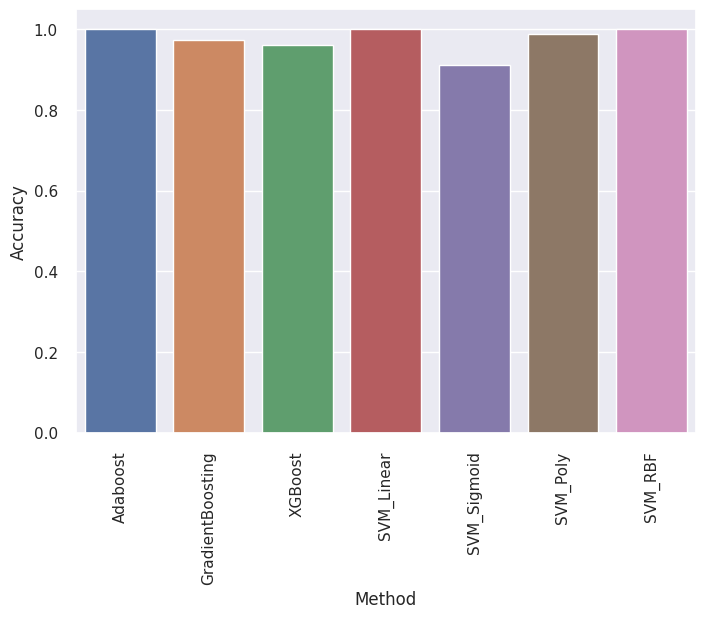

In [ ]:
final_accuracy = pd.DataFrame({'Method':list1, "Accuracy":list2})
chart = sns.barplot(x='Method', y='Accuracy', data=final_accuracy)
chart.set_xticklabels(chart.get_xticklabels(), rotation=90)
print(chart)

In [ ]:
# XGBClassifier
xgboost = XGBClassifier()
xgbt = xgboost.fit(x_train, y_train)
y_pred_xgbt_train = xgboost.predict(x_train)
y_pred_xgbt_test = xgboost.predict(x_test)
accuracy_xgbt_train = accuracy_score(y_train, y_pred_xgbt_train)
from sklearn.model_selection import cross_val_score
accuracy_train = cross_val_score(xgboost, x_train, y_train, cv=10)
accuracy_xgbt_test = accuracy_score(y_test, y_pred_xgbt_test)
print(accuracy_train.mean())
print(accuracy_xgbt_test)

0.98125
0.9625


In [ ]:
print(classification_report(y_train, y_pred_xgbt_train))
print()
print(classification_report(y_test, y_pred_xgbt_test))
print("Training Accuracy :",accuracy_train.mean())
print()
print("Test Accuracy :",accuracy_xgbt_test)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       200
           1       1.00      1.00      1.00       120

    accuracy                           1.00       320
   macro avg       1.00      1.00      1.00       320
weighted avg       1.00      1.00      1.00       320


              precision    recall  f1-score   support

           0       0.94      1.00      0.97        50
           1       1.00      0.90      0.95        30

    accuracy                           0.96        80
   macro avg       0.97      0.95      0.96        80
weighted avg       0.96      0.96      0.96        80

Training Accuracy : 0.98125

Test Accuracy : 0.9625


In [ ]:
print(confusion_matrix(y_train, y_pred_xgbt_train))
print()
print(confusion_matrix(y_test, y_pred_xgbt_test))

[[200   0]
 [  0 120]]

[[50  0]
 [ 3 27]]


**Hyperparameter Tunning**

Grid Search CV

In [ ]:
# GridSearchCV (Grid Search Cross-Validation) is a technique used in machine learning to search and find the optimal
#     combination of hyperparameters for a given model.

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
#Support Vector Machine
param_grid={'C':[0.1,1,10,100],'gamma':[1,0.1,0.01,0.0001],'kernel':['linear','sigmoid','poly','rbf']}
# C is cost of misclassification(Regularization parameter) and gamma influence of sample
# lambda and C is inversionally proportional(λ=1/C)
# C higher is better and gamma lower is better - we want the optimum value

grid=GridSearchCV(SVC(),param_grid,refit=True)
grid.fit(x_train,y_train)
grid_pred_train=grid.predict(x_train)
grid_pred_test=grid.predict(x_test)
print(accuracy_score(y_train,grid_pred_train))
print(accuracy_score(y_test,grid_pred_test))

print("Best Tuned HyperParameters k :{}".format(grid.best_params_))

1.0
1.0
Best Tuned HyperParameters k :{'C': 10, 'gamma': 1, 'kernel': 'rbf'}


RandomizedsearchCV

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

In [ ]:
# Random Forest#Support Vector Machine
param_grid={'C':[0.1,1,10,100],'gamma':[1,0.1,0.01,0.0001],'kernel':['linear','sigmoid','poly','rbf']}
# C is cost of misclassification(Regularization parameter) and gamma influence of sample
# lambda and C is inversionally proportional(λ=1/C)
# C higher is better and gamma lower is better - we want the optimum value

rnd=RandomizedSearchCV(SVC(),param_grid,refit=True)
rnd.fit(x_train,y_train)
rnd_pred_train=rnd.predict(x_train)
rnd_pred_test=rnd.predict(x_test)
print(accuracy_score(y_train,rnd_pred_train))
print(accuracy_score(y_test,rnd_pred_test))

print("Best Tuned HyperParameters k :{}".format(rnd.best_params_))

1.0
1.0
Best Tuned HyperParameters k :{'kernel': 'poly', 'gamma': 1, 'C': 0.1}


#**Class(24)(Pycaret package,Hyperparameter tuning,Feature Engineering,Principal Component Analysis(PCA))(Aug27-2023)**

**PYCARET PACKAGE**

In [ ]:
# Pycaret packege, its a Automation Model.
#PyCaret automates the entire process of model selection, from data pre-processing to model selection
#      and hyperparameter tuning.It will also comapre with model.

In [ ]:
!pip install pycaret

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [ ]:
# import dataset
dataset=pd.read_csv('/content/kidney_disease.csv')
dataset.head()

,id,age,bp,sg,al,su,rbc,pc,pcc,ba,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
0,0,48.0,80.0,1.020,1.0,0.0,NaN,normal,notpresent,notpresent,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,1,7.0,50.0,1.020,4.0,0.0,NaN,normal,notpresent,notpresent,...,38,6000,NaN,no,no,no,good,no,no,ckd
2,2,62.0,80.0,1.010,2.0,3.0,normal,normal,notpresent,notpresent,...,31,7500,NaN,no,yes,no,poor,no,yes,ckd
3,3,48.0,70.0,1.005,4.0,0.0,normal,abnormal,present,notpresent,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,4,51.0,0.0,1.010,2.0,0.0,normal,normal,notpresent,notpresent,...,35,7300,4.6,no,no,no,good,no,no,ckd


In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              400 non-null    int64  
 1   age             391 non-null    float64
 2   bp              388 non-null    float64
 3   sg              353 non-null    float64
 4   al              354 non-null    float64
 5   su              351 non-null    float64
 6   rbc             248 non-null    object 
 7   pc              335 non-null    object 
 8   pcc             396 non-null    object 
 9   ba              396 non-null    object 
 10  bgr             356 non-null    float64
 11  bu              381 non-null    float64
 12  sc              383 non-null    float64
 13  sod             313 non-null    float64
 14  pot             312 non-null    float64
 15  hemo            348 non-null    float64
 16  pcv             330 non-null    object 
 17  wc              295 non-null    obj

In [ ]:
dataset['classification'].value_counts()

ckd       250
notckd    150
Name: classification, dtype: int64

In [ ]:
dataset['classification']=np.where(dataset['classification']=='ckd\t','ckd',
                                   dataset['classification'])

In [ ]:
dataset['classification'].value_counts()

ckd       250
notckd    150
Name: classification, dtype: int64

In [ ]:
dataset.isnull().sum()/len(dataset)*100

id                 0.00
age                2.25
bp                 3.00
sg                11.75
al                11.50
su                12.25
rbc               38.00
pc                16.25
pcc                1.00
ba                 1.00
bgr               11.00
bu                 4.75
sc                 4.25
sod               21.75
pot               22.00
hemo              13.00
pcv               17.50
wc                26.25
rc                32.50
htn                0.50
dm                 0.50
cad                0.50
appet              0.25
pe                 0.25
ane                0.25
classification     0.00
dtype: float64

In [ ]:
dataset.describe()

,id,age,bp,sg,al,su,bgr,bu,sc,sod,pot,hemo
count,400.000000,391.000000,388.000000,353.000000,354.000000,351.000000,356.000000,381.000000,383.000000,313.000000,312.000000,348.000000
mean,199.500000,51.483376,76.082474,1.017408,1.016949,0.450142,148.036517,57.425722,3.072454,137.528754,4.627244,12.474713
std,115.614301,17.169714,14.736739,0.005717,1.352679,1.099191,79.281714,50.503006,5.741126,10.408752,3.193904,3.040816
min,0.000000,2.000000,0.000000,1.005000,0.000000,0.000000,22.000000,1.500000,0.400000,4.500000,2.500000,0.000000
25%,99.750000,42.000000,70.000000,1.010000,0.000000,0.000000,99.000000,27.000000,0.900000,135.000000,3.800000,10.300000
50%,199.500000,55.000000,80.000000,1.020000,0.000000,0.000000,121.000000,42.000000,1.300000,138.000000,4.400000,12.650000
75%,299.250000,64.500000,80.000000,1.020000,2.000000,0.000000,163.000000,66.000000,2.800000,142.000000,4.900000,15.000000
max,399.000000,90.000000,180.000000,1.025000,5.000000,5.000000,490.000000,391.000000,76.000000,163.000000,47.000000,17.800000


In [ ]:
dataset

,id,age,bp,sg,al,su,rbc,pc,pcc,ba,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
0,0,48.0,80.0,1.020,1.0,0.0,NaN,normal,notpresent,notpresent,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,1,7.0,50.0,1.020,4.0,0.0,NaN,normal,notpresent,notpresent,...,38,6000,NaN,no,no,no,good,no,no,ckd
2,2,62.0,80.0,1.010,2.0,3.0,normal,normal,notpresent,notpresent,...,31,7500,NaN,no,yes,no,poor,no,yes,ckd
3,3,48.0,70.0,1.005,4.0,0.0,normal,abnormal,present,notpresent,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,4,51.0,0.0,1.010,2.0,0.0,normal,normal,notpresent,notpresent,...,35,7300,4.6,no,no,no,good,no,no,ckd
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,395,55.0,80.0,1.020,0.0,0.0,normal,normal,notpresent,notpresent,...,47,6700,4.9,no,no,no,good,no,no,notckd
396,396,42.0,70.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,54,7800,6.2,no,no,no,good,no,no,notckd
397,397,12.0,80.0,1.020,0.0,0.0,normal,normal,notpresent,notpresent,...,49,6600,5.4,no,no,no,good,no,no,notckd
398,398,17.0,60.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,51,7200,5.9,no,no,no,good,no,no,notckd


In [ ]:
# creating training data
data=dataset.sample(frac=0.90,random_state=None).reset_index(drop=True)

# Creating test data
data_unseen=dataset.drop(data.index).reset_index(drop=True)

# x_train,y_train for model building and x_test,y_test is for prediction


In [ ]:
print("data for modelling :",data.shape)
print("unseen data for prediction :",data_unseen.shape)

data for modelling : (360, 26)
unseen data for prediction : (40, 26)


In [ ]:
# setting up an environment in pycaret
from pycaret.classification import *

In [ ]:
exp_clf=setup(data=data,target='classification',session_id=123)

,Description,Value
0,Session id,123
1,Target,classification
2,Target type,Binary
3,Target mapping,"ckd: 0, notckd: 1"
4,Original data shape,"(360, 26)"
5,Transformed data shape,"(360, 31)"
6,Transformed train set shape,"(251, 31)"
7,Transformed test set shape,"(109, 31)"
8,Ordinal features,8
9,Numeric features,12


In [ ]:
# check model
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lr,Logistic Regression,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.6130
rf,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0310
xgboost,Extreme Gradient Boosting,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.8060
lightgbm,Light Gradient Boosting Machine,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.6390
dt,Decision Tree Classifier,0.9962,0.9950,0.9900,1.0000,0.9947,0.9917,0.9920,0.7760
ada,Ada Boost Classifier,0.9962,0.9950,0.9900,1.0000,0.9947,0.9917,0.9920,0.5530
gbc,Gradient Boosting Classifier,0.9962,0.9950,0.9900,1.0000,0.9947,0.9917,0.9920,1.0150
et,Extra Trees Classifier,0.9960,1.0000,0.9889,1.0000,0.9941,0.9911,0.9915,0.9880
knn,K Neighbors Classifier,0.9880,1.0000,1.0000,0.9742,0.9861,0.9757,0.9771,0.7810
svm,SVM - Linear Kernel,0.9880,0.0000,0.9889,0.9798,0.9841,0.9744,0.9748,0.5240


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=123, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [ ]:
lf=r=create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
rf=create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
# Hyper Parameter tuning
# Hyperparameter means some option there like in random forest max_depth, criterion(gini,entropy),max_feature,bootstrap is there,so here tune_model check one by one after that they will give answer,which parameter is best
tuned_rf=tune_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [ ]:
# Evaluate the model
evaluate_model(tuned_rf)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [ ]:
predict_model(tuned_rf)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


,id,age,bp,sg,al,su,rbc,pc,pcc,ba,...,rc,htn,dm,cad,appet,pe,ane,classification,prediction_label,prediction_score
154,181,45.0,70.0,1.025,2.0,0.0,normal,abnormal,present,notpresent,...,3.7,no,no,no,good,no,no,0,ckd,0.96
223,320,57.0,60.0,1.020,0.0,0.0,normal,normal,notpresent,notpresent,...,6.2,no,no,no,good,no,no,1,notckd,0.98
186,318,61.0,70.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,5.3,no,no,no,good,no,no,1,notckd,0.99
241,203,NaN,90.0,NaN,NaN,NaN,NaN,NaN,notpresent,notpresent,...,NaN,yes,yes,no,good,no,yes,0,ckd,1.00
22,79,56.0,80.0,1.010,1.0,0.0,NaN,normal,notpresent,notpresent,...,5,yes,yes,no,poor,yes,no,0,ckd,0.95
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150,175,60.0,50.0,1.010,0.0,0.0,NaN,normal,notpresent,notpresent,...,3.4,yes,no,no,good,no,no,0,ckd,1.00
72,231,60.0,90.0,NaN,NaN,NaN,NaN,NaN,notpresent,notpresent,...,NaN,yes,yes,yes,good,yes,no,0,ckd,1.00
41,295,44.0,70.0,NaN,NaN,NaN,NaN,NaN,notpresent,notpresent,...,6.5,no,no,no,good,no,no,1,notckd,0.85
195,226,64.0,100.0,1.015,4.0,2.0,abnormal,abnormal,notpresent,present,...,3.4,yes,yes,no,good,yes,no,0,ckd,1.00


In [ ]:
# Predict the unseen test data
unseen_prediction=predict_model(tuned_rf,data=data_unseen)
unseen_prediction

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,1.0000,0,1.0000,1.0000,1.0000,nan,0.0000


,id,age,bp,sg,al,su,rbc,pc,pcc,ba,...,rc,htn,dm,cad,appet,pe,ane,classification,prediction_label,prediction_score
0,360,35.0,60.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,6.2,no,no,no,good,no,no,1,notckd,1.00
1,361,29.0,80.0,1.020,0.0,0.0,normal,normal,notpresent,notpresent,...,5.8,no,no,no,good,no,no,1,notckd,0.97
2,362,33.0,80.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,4.8,no,no,no,good,no,no,1,notckd,1.00
3,363,67.0,80.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,5.2,no,no,no,good,no,no,1,notckd,0.95
4,364,73.0,80.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,4.7,no,no,no,good,no,no,1,notckd,1.00
5,365,24.0,80.0,1.020,0.0,0.0,normal,normal,notpresent,notpresent,...,6.3,no,no,no,good,no,no,1,notckd,0.94
6,366,60.0,80.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,5.3,no,no,no,good,no,no,1,notckd,1.00
7,367,68.0,60.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,6.1,no,no,no,good,no,no,1,notckd,1.00
8,368,30.0,80.0,1.025,0.0,0.0,normal,normal,notpresent,notpresent,...,5.9,no,no,no,good,no,no,1,notckd,1.00
9,369,75.0,70.0,1.020,0.0,0.0,normal,normal,notpresent,notpresent,...,4.8,no,no,no,good,no,no,1,notckd,1.00


In [ ]:
# Save model for deployment
save_model(tuned_rf,'tuned_rf_model')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=/tmp/joblib),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['id', 'age', 'bp', 'sg', 'al',
                                              'su', 'bgr', 'bu', 'sc', 'sod',
                                              'pot', 'hemo'],
                                     transformer=SimpleImputer(add_indicator=False,
                                                               copy=True,
                                                               fill_v...
                  RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                         class_weight=None, criterion='gini',
                                         max_depth=None, max_features='

**Feature Engineering**

In [ ]:
    # Feature Engineering Types :-

  ## Feature Transformation :-
       # Missing value(Imputation)
       # Handling Categorical Feature(Encoding)
       # Outlier detector(capping,trimming)
       # Feature Scaling

  ## Feature Construction :
      # split the data into train and test

  ## Feature Selection :
      # p-value
      # Heatmap (decide which variable to take)
      # Regularization
      # Forward selection
      # Backward selection

  ## Feature Extraction :
      # PCA (very popular)
      # LDA
      # t-SNA

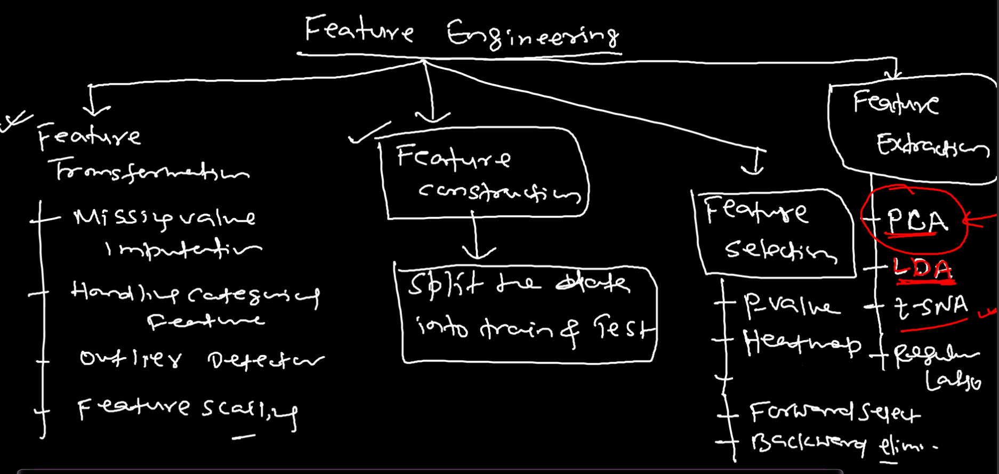

**Feature Extraction**

In [ ]:
# Feature extraction cuts through the noise, removing redundant and unnecessary data. This frees machine learning programs to focus on the most relevant data.

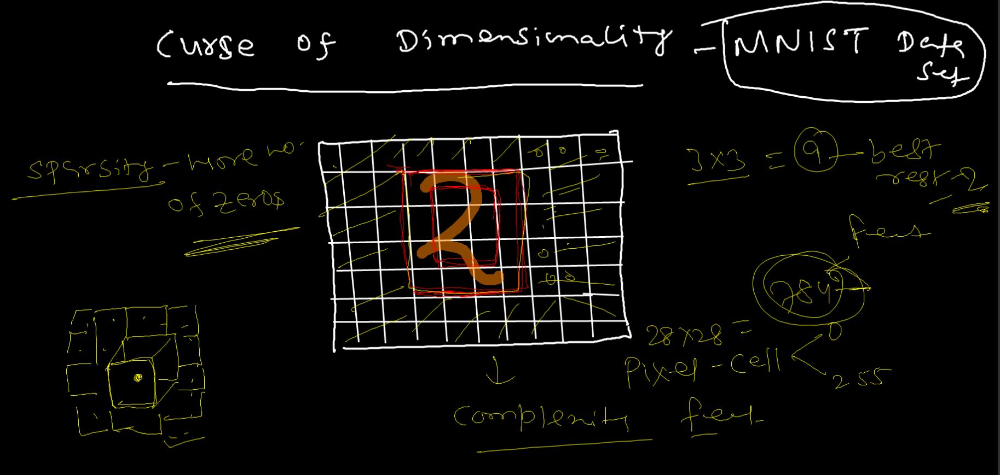

**Principal Component Analysis (PCA)**

In [ ]:
# Principal Component Analysis is an unsupervised learning algorithm.
# It is one of the popular tools that is used for exploratory data analysis and predictive modeling.

    # The PCA algorithm is based on some mathematical concepts such as:
    #         Variance and Covariance
    #         Eigenvalues and Eigen factors

In [ ]:
        ## Variance :-
  # Variance is a measure of how data points differ from the mean. According to Layman, a variance is a measure
  #   of how far a set of data (numbers) are spread out from their mean (average) value. Variance means to find the
  #   expected difference of deviation from actual value.

# Why Variance is important?
# ----> if we are using central tendency, in fig data is different but mean is 0 for all, thats why we are using variance.

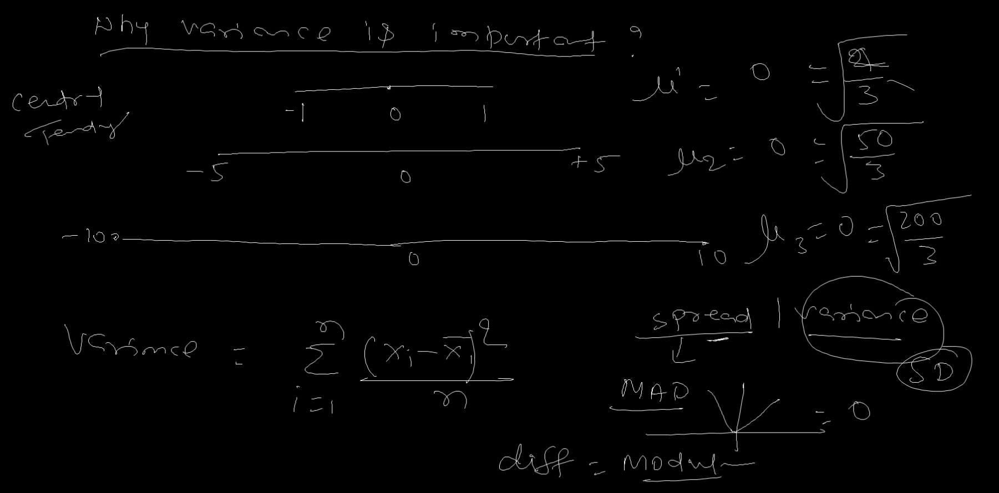

In [ ]:
 # Covariance and Correlation :-

# Covariance measures the direction of a relationship between two variables, while correlation
#   measures the strength of that relationship. Both correlation and covariance are positive when the
#   variables move in the same direction and negative when they move in opposite directions. However, a
#   correlation coefficient must always be between -1 and +1,


In [ ]:
# -2/3 -ve correlation

# 2/3  +ve correlation

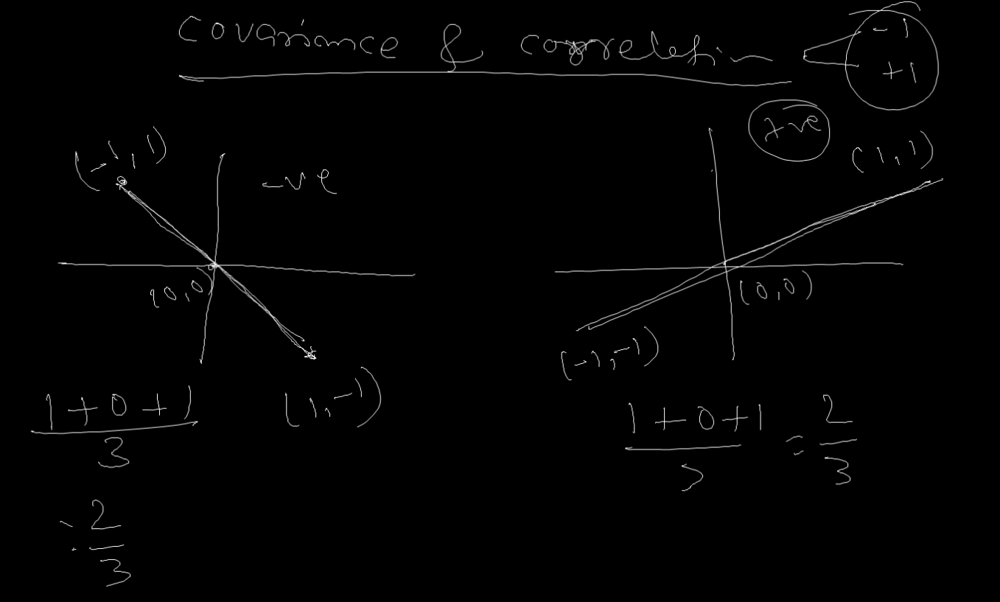

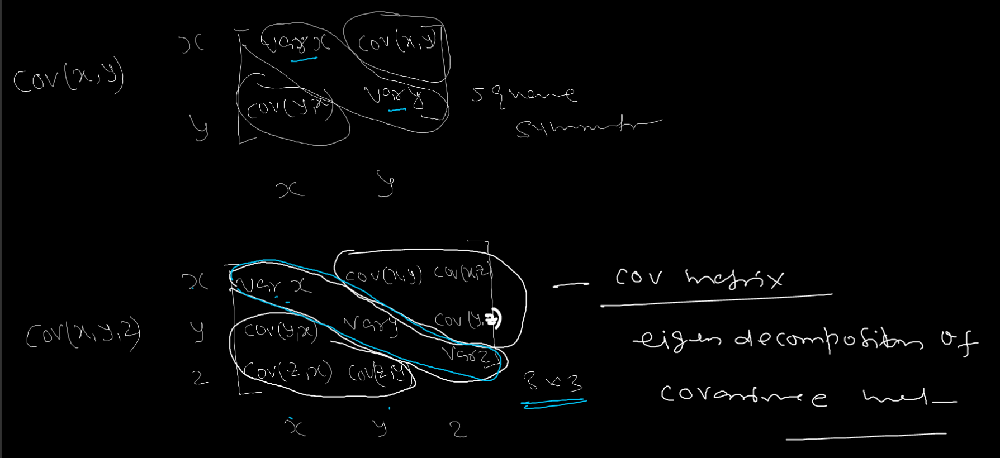

In [ ]:
 # Eigen Vector & Eigen Value :-

 # eigenvalues and eigenvectors are the building blocks of linear transformations.
 # An eigenvector defines a direction in which a space is scaled by a transform
 # An eigenvalue defines a length of scaled change related to the eigenvector.


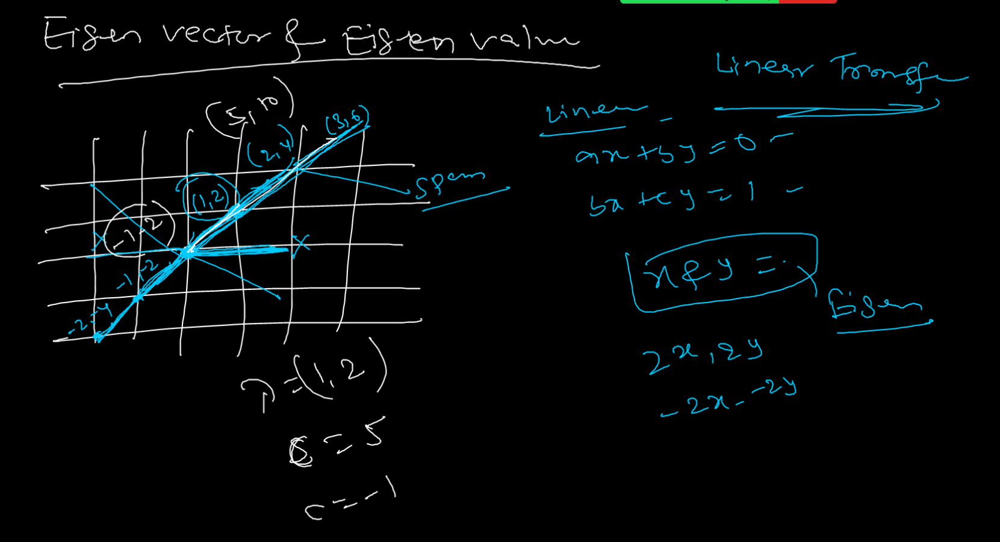

In [ ]:
        # Properties of eigen value(λ) :-

#(1) sum of eigen value equal to the diagonal value(variance).
#(2) Product of eigen value is determinant of given matrix.
#(3) eigen value correspondent to different eigen value are orthogonal(perpendicular)

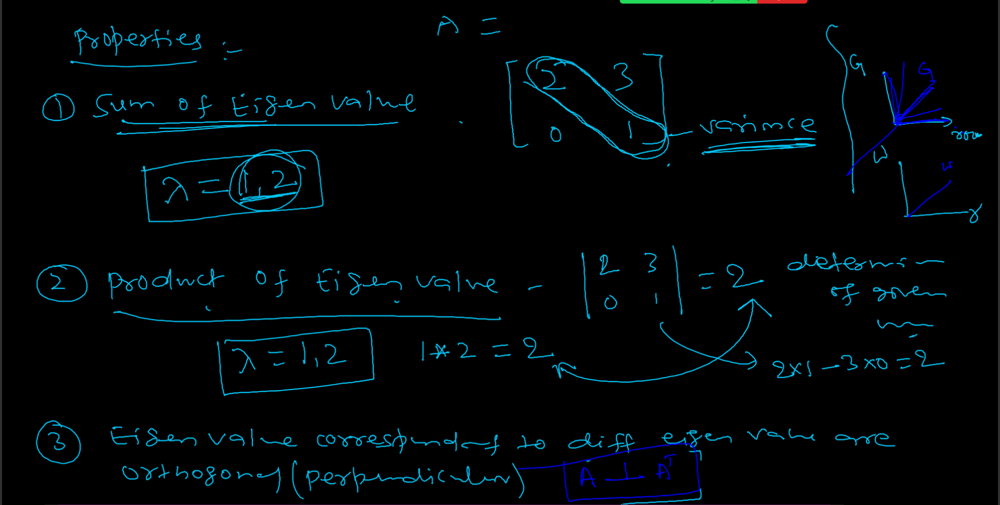

In [ ]:
#(4) Eigen value of a scaler multiple (B=CA)

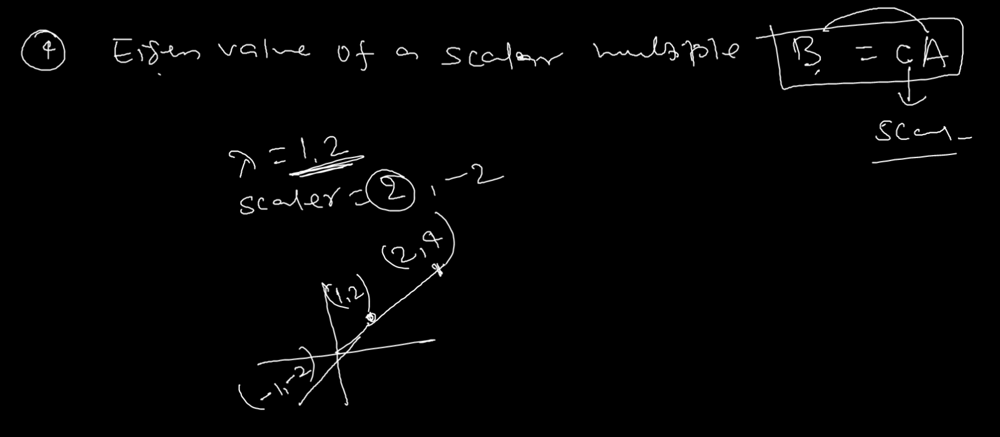

In [ ]:
# calculate eigen value and eigen vector :-

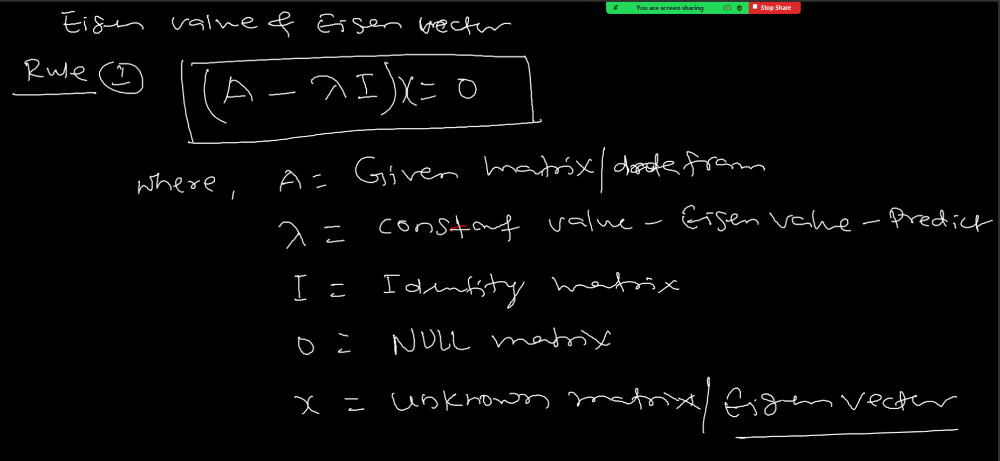

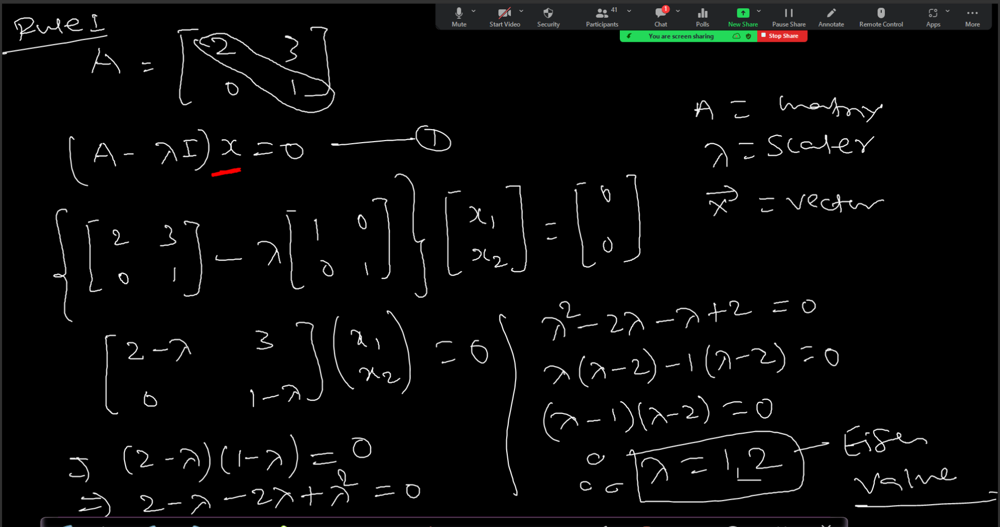

In [ ]:
# |A| - determinant of A

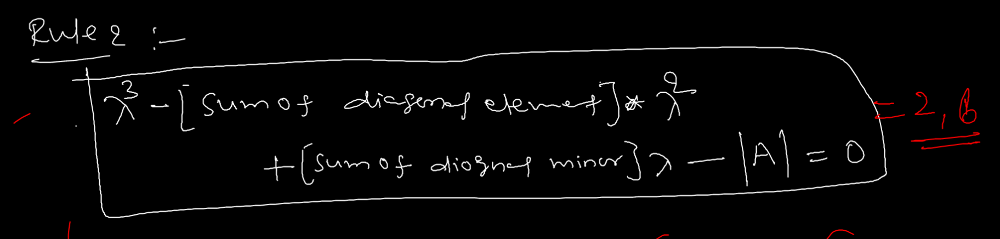

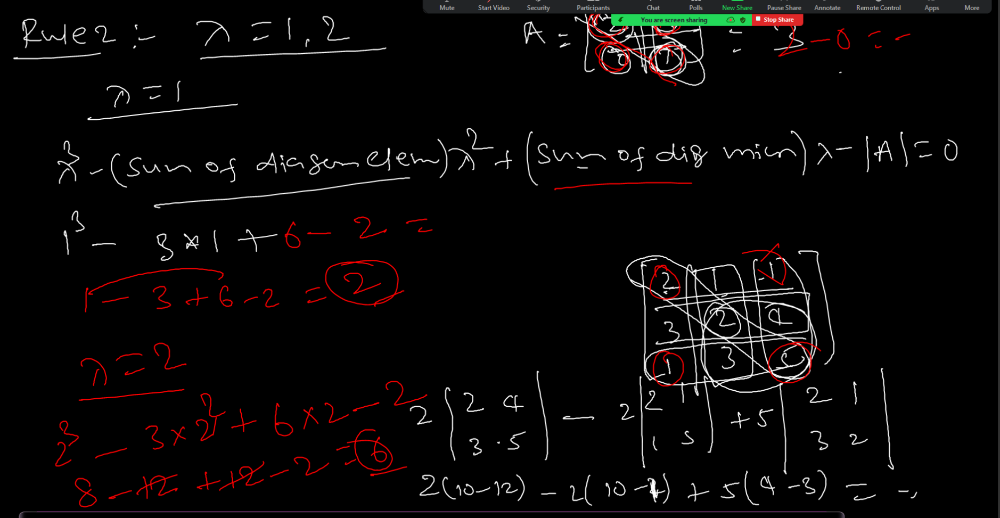

#**Class(25)(PCA(Code),Unsupervised ML)(Sep2-2023)**


In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_theme(style='darkgrid')
import warnings
warnings.filterwarnings('ignore')

In [ ]:
data=pd.read_csv('/content/Bank-data.csv')
data.head()

,Index,interest_rate,credit,Gender,previous,duration,Churn
0,0,1.334,0,1,0,117,no
1,1,0.767,0,0,1,274,yes
2,2,4.858,0,1,0,167,no
3,3,4.120,0,0,0,686,yes
4,4,4.856,0,1,0,159,no


In [ ]:
data.isnull().any()

Index            False
interest_rate    False
credit           False
Gender           False
previous         False
duration         False
Churn            False
dtype: bool

In [ ]:
data.isnull().sum()

Index            0
interest_rate    0
credit           0
Gender           0
previous         0
duration         0
Churn            0
dtype: int64

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 518 entries, 0 to 517
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Index          518 non-null    int64  
 1   interest_rate  518 non-null    float64
 2   credit         518 non-null    int64  
 3   Gender         518 non-null    int64  
 4   previous       518 non-null    int64  
 5   duration       518 non-null    int64  
 6   Churn          518 non-null    object 
dtypes: float64(1), int64(5), object(1)
memory usage: 28.5+ KB


In [ ]:
# churn is object type
data['Churn']=data['Churn'].astype('category')
data['Churn']=data['Churn'].cat.codes

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 518 entries, 0 to 517
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Index          518 non-null    int64  
 1   interest_rate  518 non-null    float64
 2   credit         518 non-null    int64  
 3   Gender         518 non-null    int64  
 4   previous       518 non-null    int64  
 5   duration       518 non-null    int64  
 6   Churn          518 non-null    int8   
dtypes: float64(1), int64(5), int8(1)
memory usage: 24.9 KB


In [ ]:
# checking dependent variable balance or imbalance
data['Churn'].value_counts()
# here depenedent variable(churn) is balance

0    259
1    259
Name: Churn, dtype: int64

In [ ]:
# split the data into ind and dp variable
x=data.iloc[:,:-1]
y=data.iloc[:,-1]

In [ ]:
x

,Index,interest_rate,credit,Gender,previous,duration
0,0,1.334,0,1,0,117
1,1,0.767,0,0,1,274
2,2,4.858,0,1,0,167
3,3,4.120,0,0,0,686
4,4,4.856,0,1,0,159
...,...,...,...,...,...,...
513,513,1.334,0,1,0,204
514,514,0.861,0,0,1,806
515,515,0.879,0,0,0,290
516,516,0.877,0,0,1,473


In [ ]:
y

0      0
1      1
2      0
3      1
4      0
      ..
513    0
514    1
515    0
516    1
517    0
Name: Churn, Length: 518, dtype: int8

In [ ]:
# split the data into train and test
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.25,random_state=101)

**Logistic Regression Model**

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
logit=LogisticRegression()
logit.fit(x_train,y_train)
y_pred=logit.predict(x_test)
print(accuracy_score(y_test,y_pred))


0.8538461538461538


**Principal Component Analysis(PCA)**

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pd.DataFrame(x_train).head(2)

,Index,interest_rate,credit,Gender,previous,duration
69,69,4.120,0,0,0,104
260,260,1.453,0,0,0,463


In [ ]:
pca=PCA(n_components=None) # None means all component/variables/features
x_train_n=pca.fit_transform(x_train)
x_test_n=pca.fit_transform(x_test)

In [ ]:
pd.DataFrame(x_train_n).head(2)

,0,1,2,3,4,5
0,-293.378624,175.880375,1.204506,-0.217953,-0.058617,-0.064395
1,74.599343,2.806120,-1.361333,-0.239816,-0.275379,-0.065405


In [ ]:
# To check pca significant label in each slice
explained_variance=pca.explained_variance_ratio_

In [ ]:
explained_variance

array([8.07144870e-01, 1.92823493e-01, 2.92532511e-05, 1.52261165e-06,
       6.96408766e-07, 1.64823601e-07])

In [ ]:
# pca0 = 8.0714487 (80.7%)  - more significant
# pca1 = 1.92823493 (19.2%) - less signifiacant then 0
# pca2 = 2.925325     - less signifiacant then 2
# pca3 = 1.52261165   - less signifiacant then 3
# pca4 = 6.96408766   - less signifiacant then 4
# pca5 = 1.64823601   - less signifiacant then 5

In [ ]:
# PCA = 2 component are significant

In [ ]:
pca_2=PCA(n_components=2)
x_train_2=pca_2.fit_transform(x_train)
x_test_2=pca_2.fit_transform(x_test)

In [ ]:
pd.DataFrame(x_train_2).head(2)

,0,1
0,-293.378624,175.880375
1,74.599343,2.806120


In [ ]:
# logisticRegression with PCA

In [ ]:
logit1=LogisticRegression()
logit1.fit(x_train_2,y_train)
y_pred2=logit1.predict(x_test_2)
print(accuracy_score(y_test,y_pred2))


0.7384615384615385


In [ ]:
# PCA is a Feature Engineering Technique, where Feature extraction(dropping) happened.

In [ ]:
# when we have huge features we really need dimension reduction, because i have no
#    clarity which feature we have to select which feature not,then pca will help.

In [ ]:
# PCA gives not good accuracy, because in pca we are removing so many features and take only highly significant features.

In [ ]:
# PCA gives the highly significant features.
# through PCS we have to find highly significant feature after that build the model then :-
      # 1.  time will reduce
      # 2.  complexity get reduce
      # 3.  dimension reduce


In [ ]:
# Cross Vaidation method
from sklearn.model_selection import cross_val_score
accuracy=cross_val_score(logit1,x_train_2,y_train,cv=10)
accuracy_test=cross_val_score(logit1,x_test_2,y_test,cv=10)
print(accuracy)
print(accuracy.mean())
print(accuracy.max())
print("*****************************************")
print(accuracy_test)
print(accuracy_test.mean())
print(accuracy_test.max())

[0.76923077 0.51282051 0.76923077 0.74358974 0.69230769 0.48717949
 0.64102564 0.82051282 0.68421053 0.65789474]
0.6778002699055331
0.8205128205128205
*****************************************
[0.76923077 0.76923077 0.61538462 0.76923077 0.46153846 0.76923077
 0.92307692 0.76923077 0.76923077 0.69230769]
0.7307692307692308
0.9230769230769231


**RandomForest Classifier**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf=RandomForestClassifier()
rf.fit(x_train,y_train)
y_pred=rf.predict(x_test)
print(accuracy_score(y_test,y_pred))

0.8384615384615385


---------------------------------- **UNSUPERVISED LEARNING** --------------------------------------------------------

In [ ]:
      # Unsupervised Learning(Data Mining) :-

  # Clustering is an unsupervised machine learning technique.
  # Clustering is a data science technique in machine learning that groups similar rows in a data set.

        # TASK - Task is to group them  basis similar data pont.


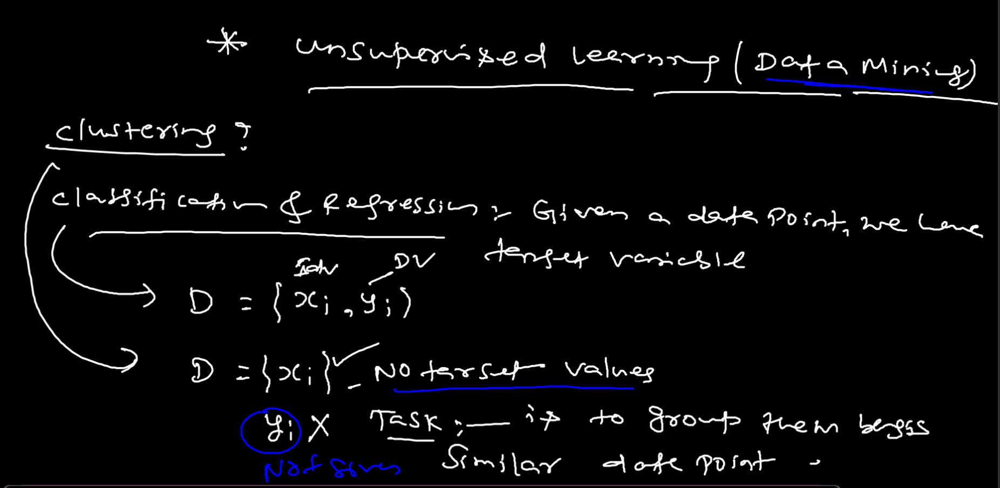

In [ ]:
# you have to group them all together with similarity.

  #  KEY POINT TO REMEMBER :-
  #     1. Points in a cluster are cloase together.
  #     2. Points in different cluster are far away.


 # how do you measure cluster as how good model is, check through k-means,Hierarchical,DbScan

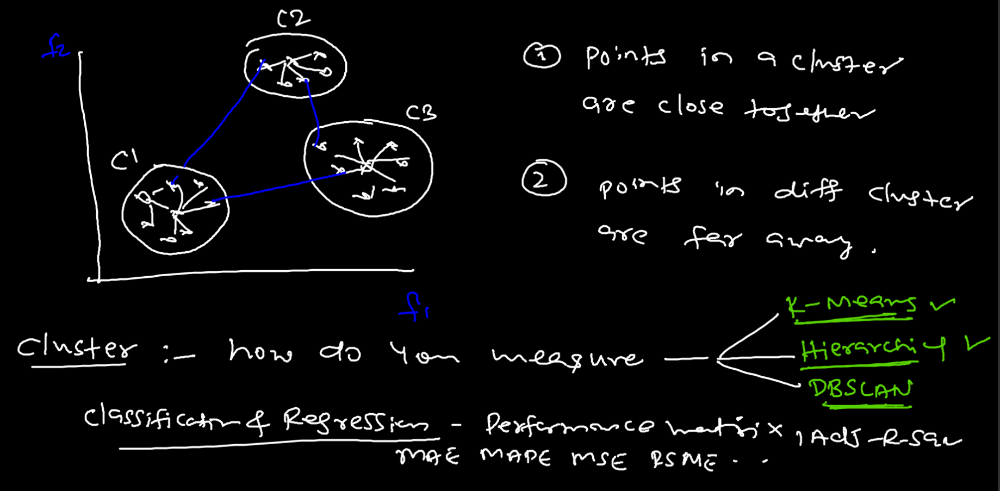

In [ ]:
# Intra Cluster(cohesion) - within a cluster
# Inter Cluster(Seperation) - Across or Between cluster

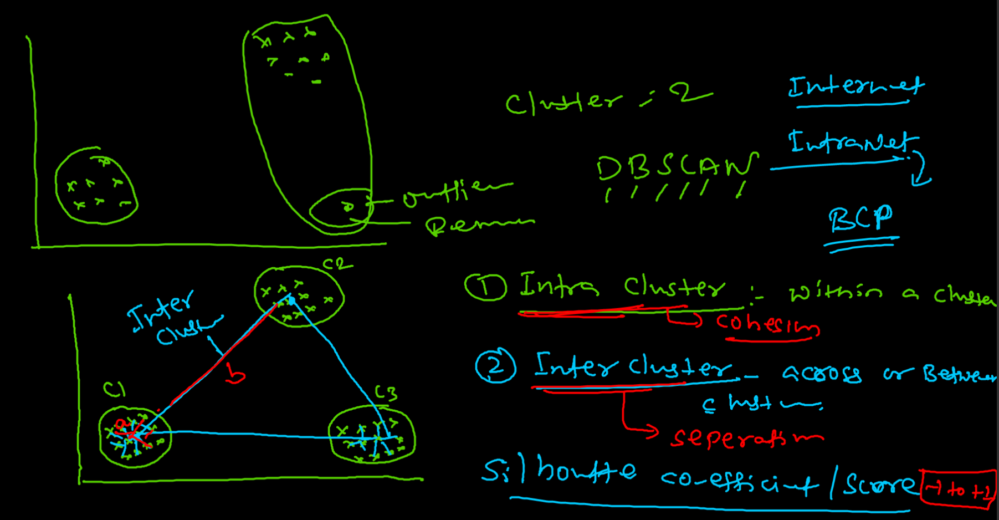

In [ ]:
# in fig, which cluster is better A or B.
      # Ideas - First see the intra cluster(intra cluster if the distance is very low,then cluster is good. In A c1 is low distance)
      #         - Intra cluster(if the distance is very high,then cluster is good.in A c1 and c2 center to center distance is high)
      #          -       Hence A cluster is better cluster

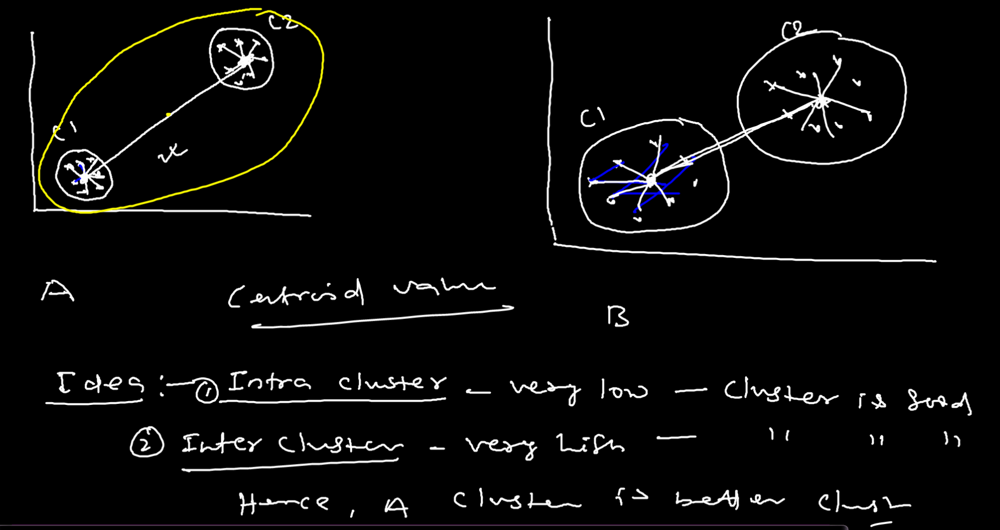

In [ ]:
# How many cluster we require?

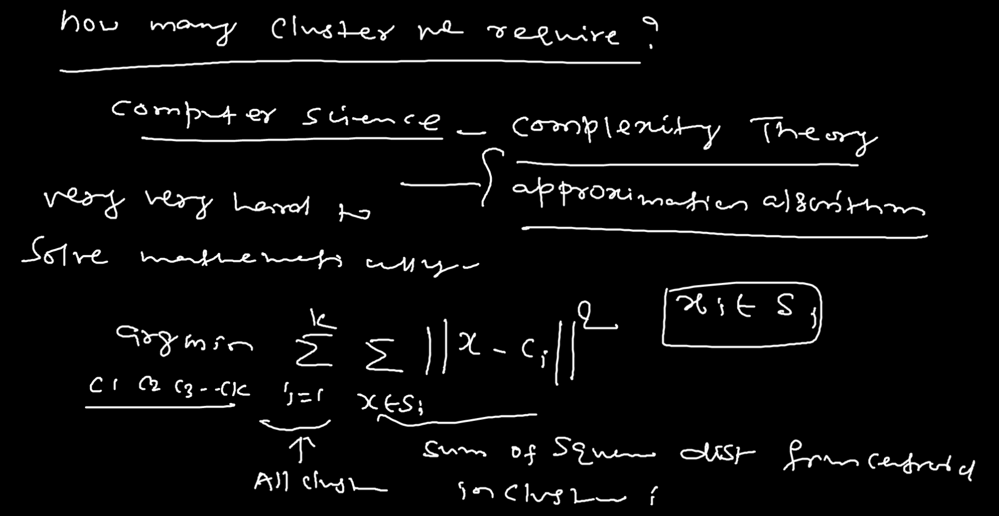

In [ ]:
         ### Lloyd Algorithm ######
  # ---> Lloyd algorithm, also known as k-means algorithm.

## How you will define the Lloyd method?
# ----> first we randomly initialize the k(cluster) value, how many k required, for finding the k we
#             have to use elbow method, Lets k is 2, i will go and pick 2 cluster randomly(Check fig).
#  ----> second part i will assign the value c1 and c2 ( check fig )

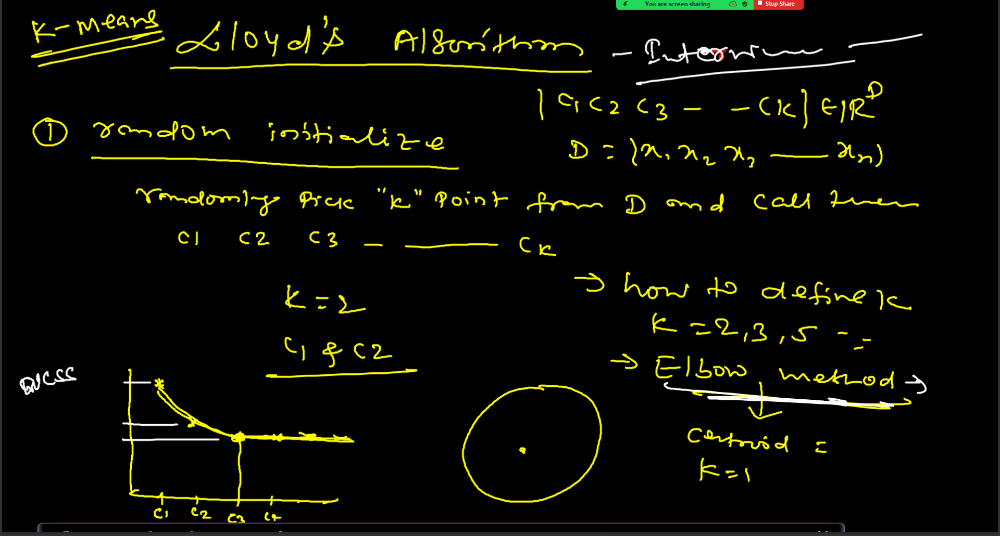

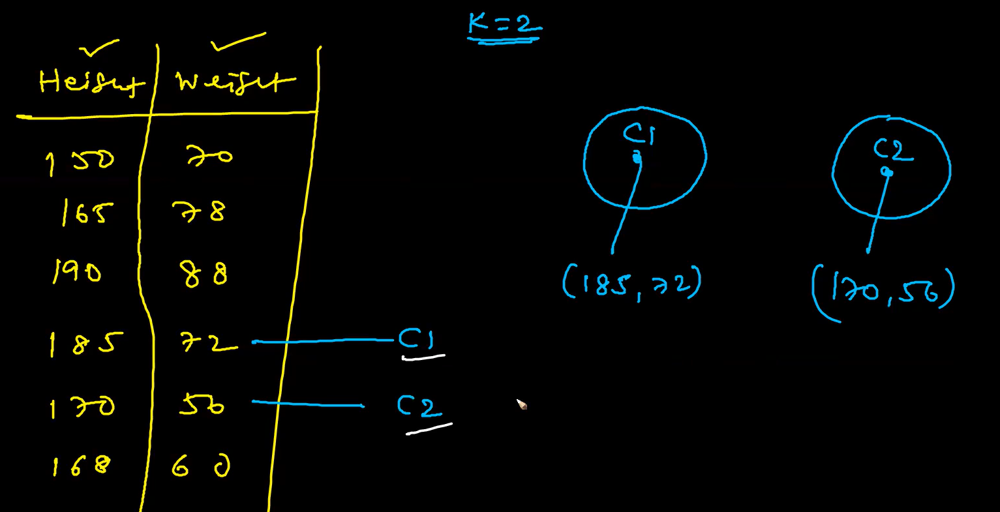

In [ ]:
# (2) Assignment
# (3) Recompute centroid & update
# (4) Repeat step 2 & 3 until covergence

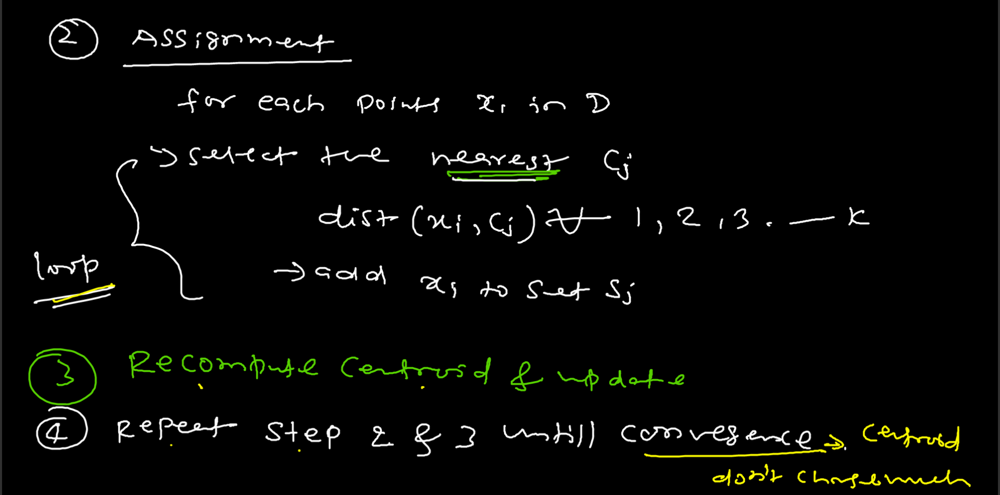

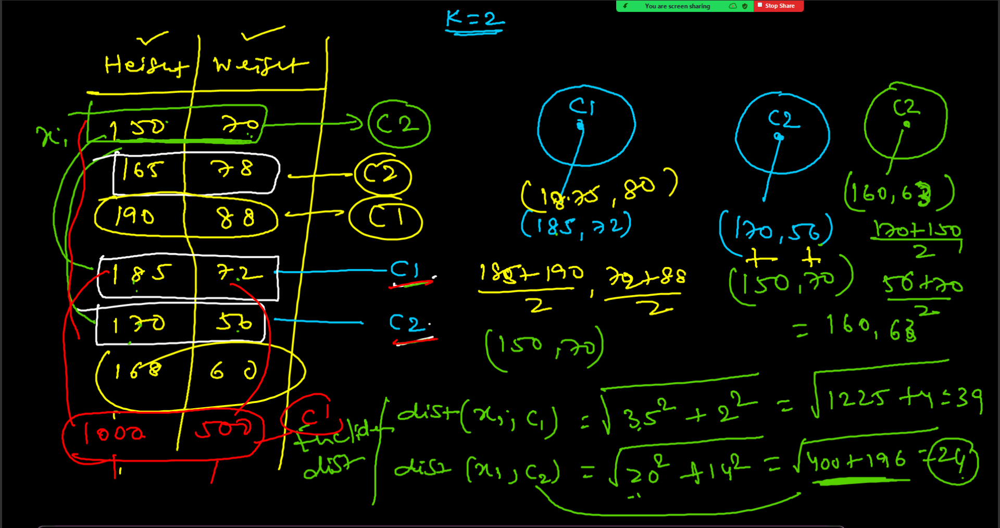

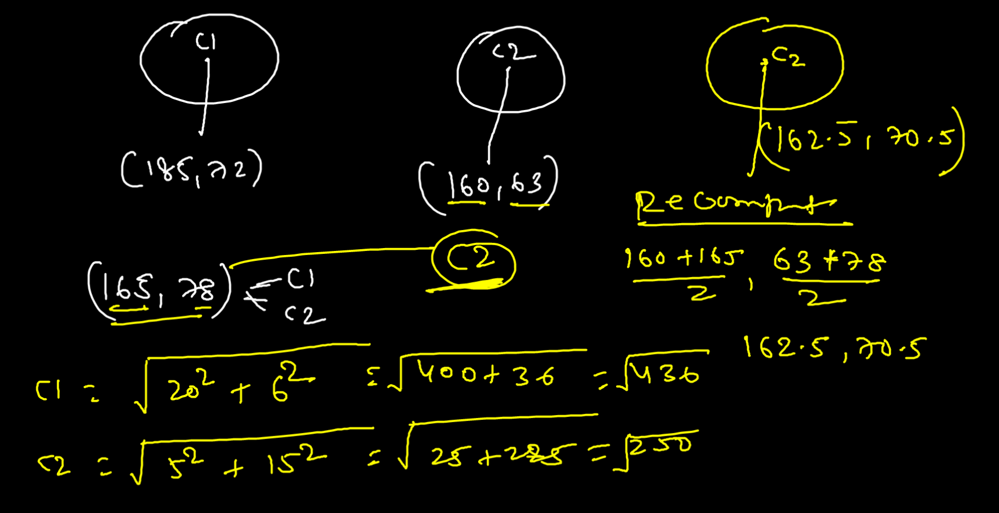

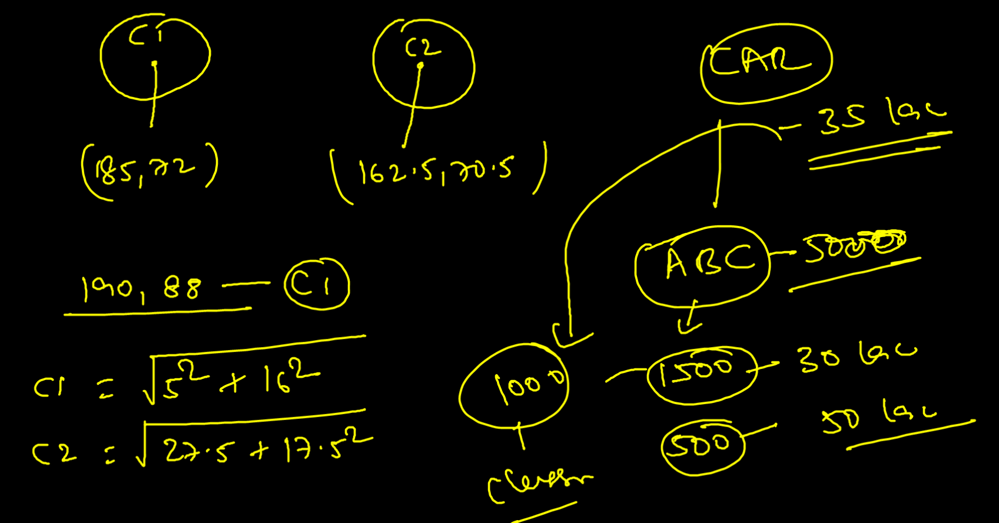

In [ ]:
    #Drawback :-

     # --> Before Process you must maintain the no. of cluster
     # ---> we can not treat outlier as seperate cluster

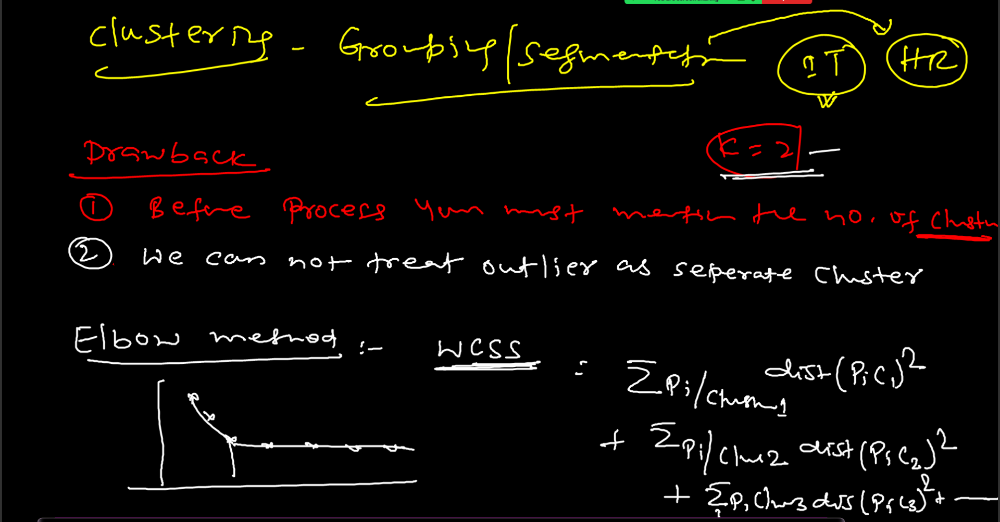

**Hierarchical Clustering Technique**

In [ ]:
   # Two Approach is there in Hierarchical :-
#   1. Agglomerative - very Famous
#                     Bottom-up Approach
#   2. Divisive  - not famous
#                 - industry not using

#Both method calculated k value by the help of Dendrogram

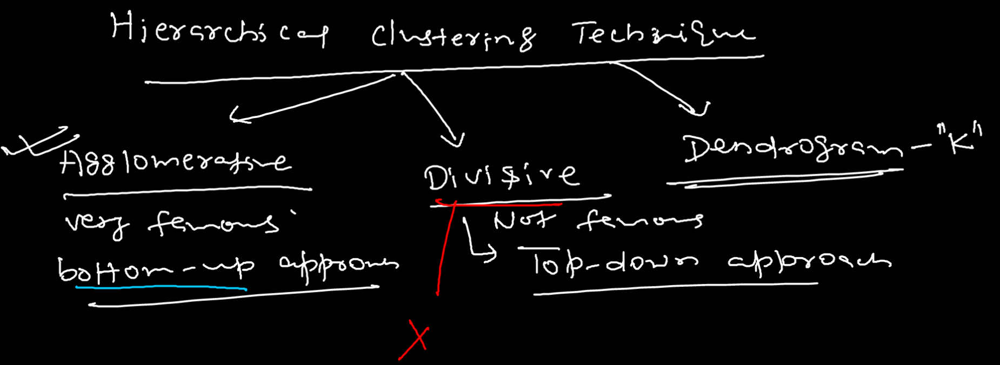

In [ ]:
    # Agglomarative :-

    # Purpose is to make one cluster

    # 1. All individual point are consider cluster,in fig 13 cluster is there
    # 2. Find the nearest one
    # 3. Repeat step to till convergence


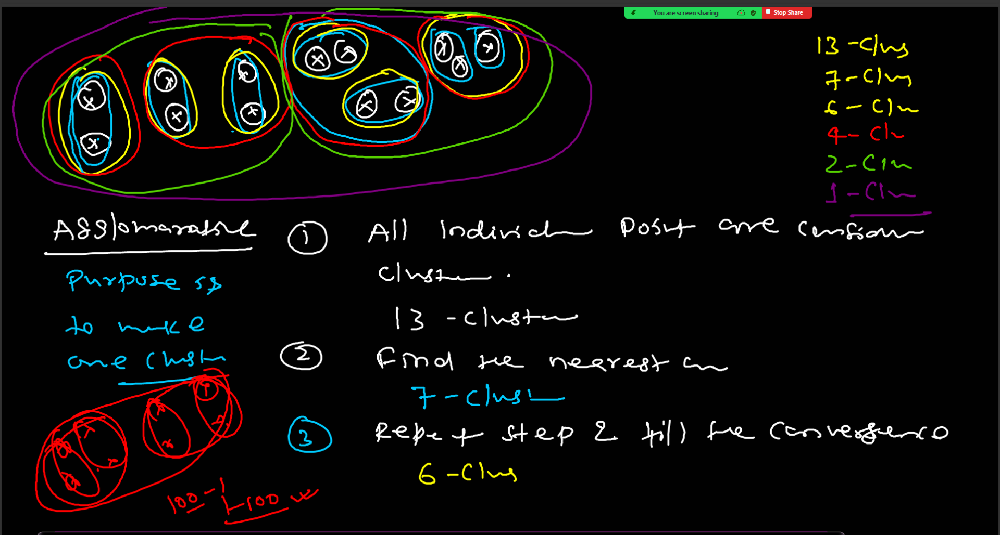

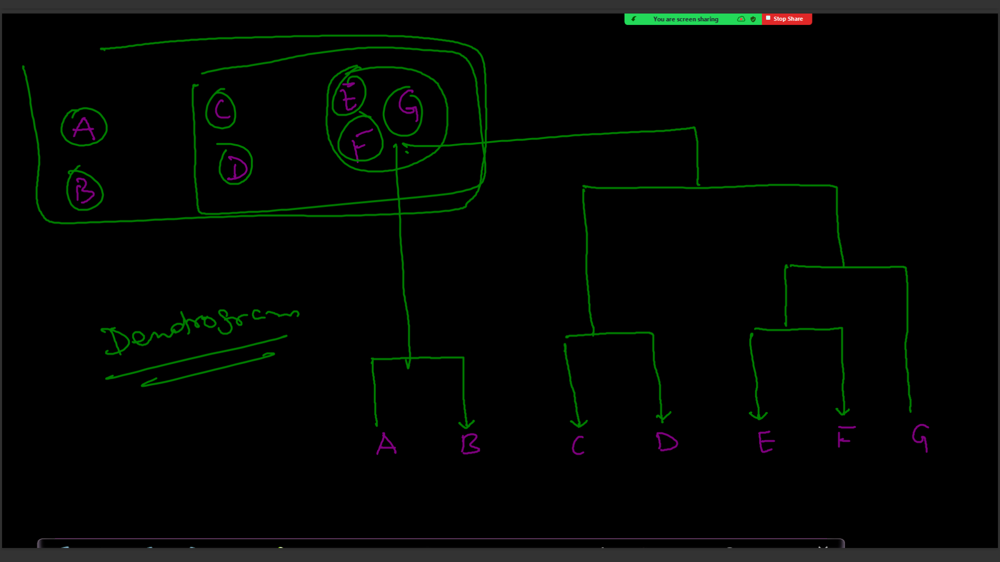

In [ ]:
  # Calculate Agglomarative

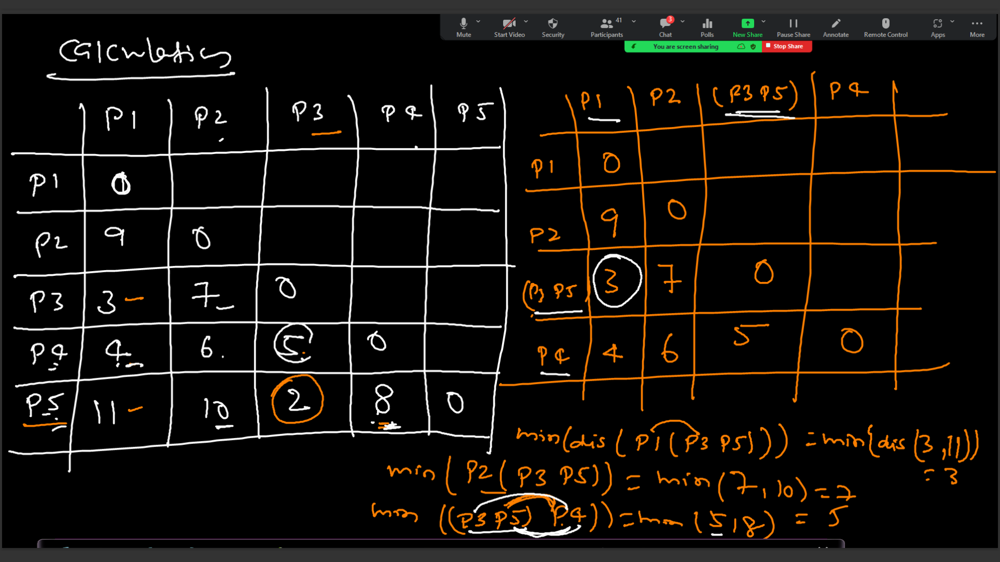

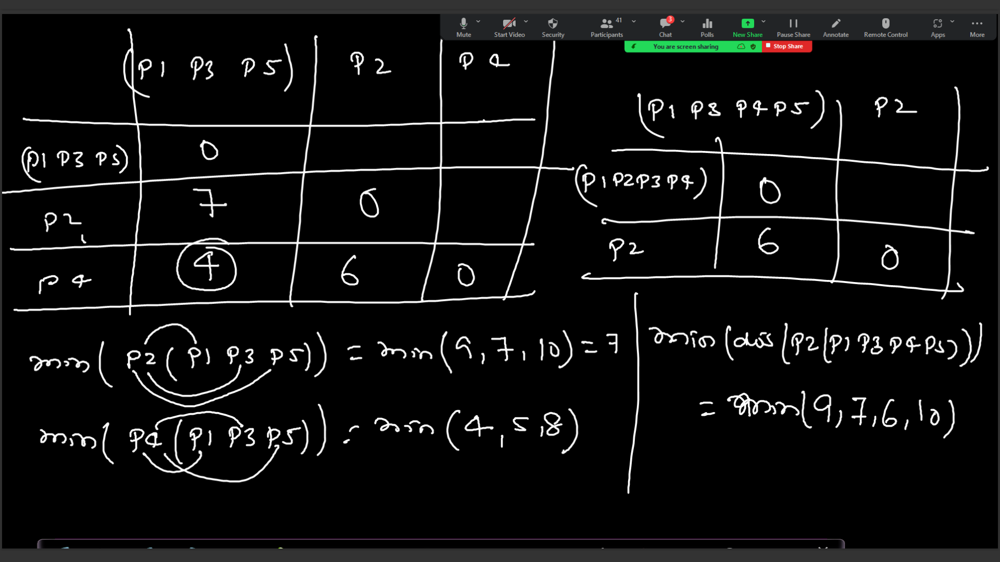

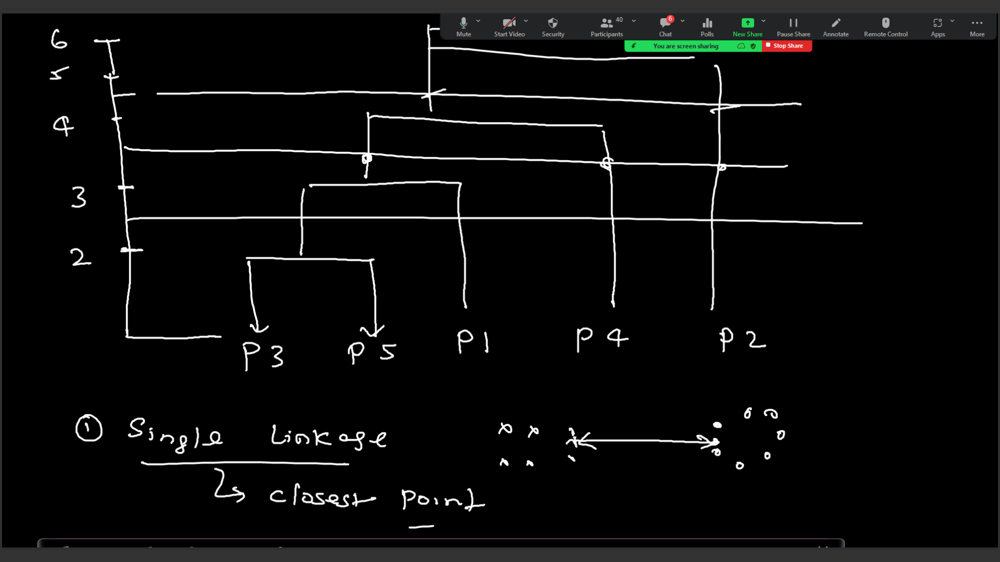

In [ ]:
# (2) Complete linkage
# (3) Average distance
# (4) Centroid linkage

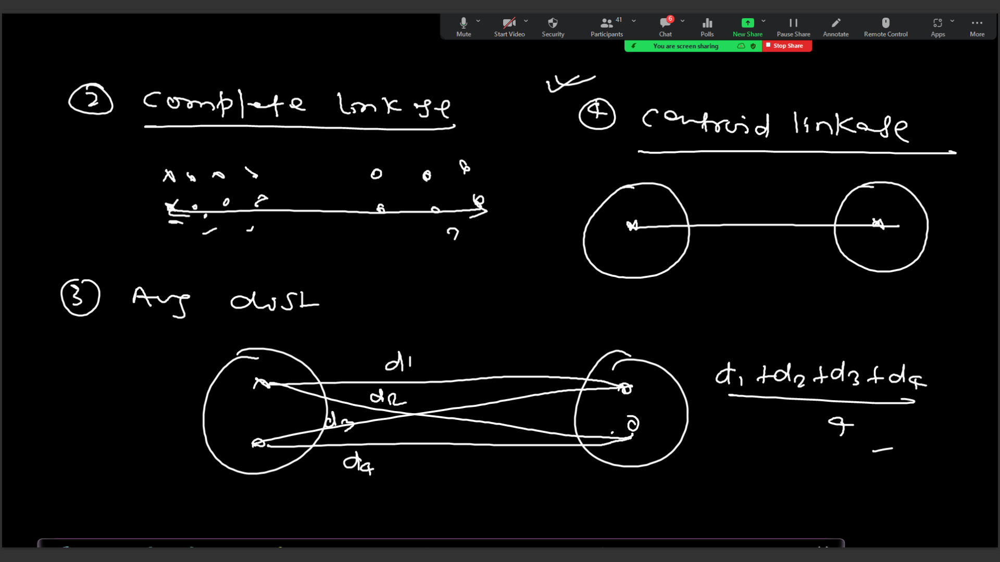

In [ ]:
    # Silhoutte distance

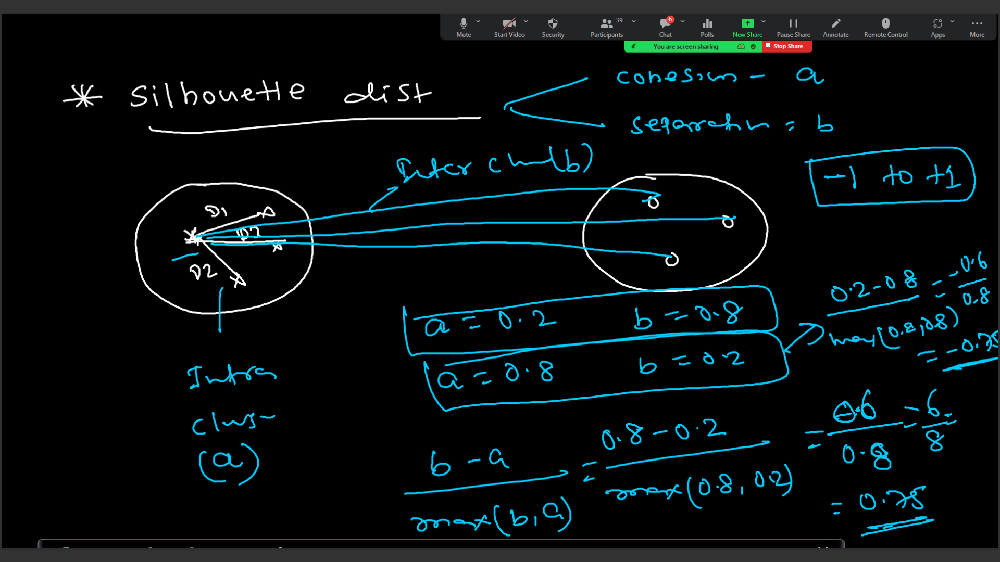

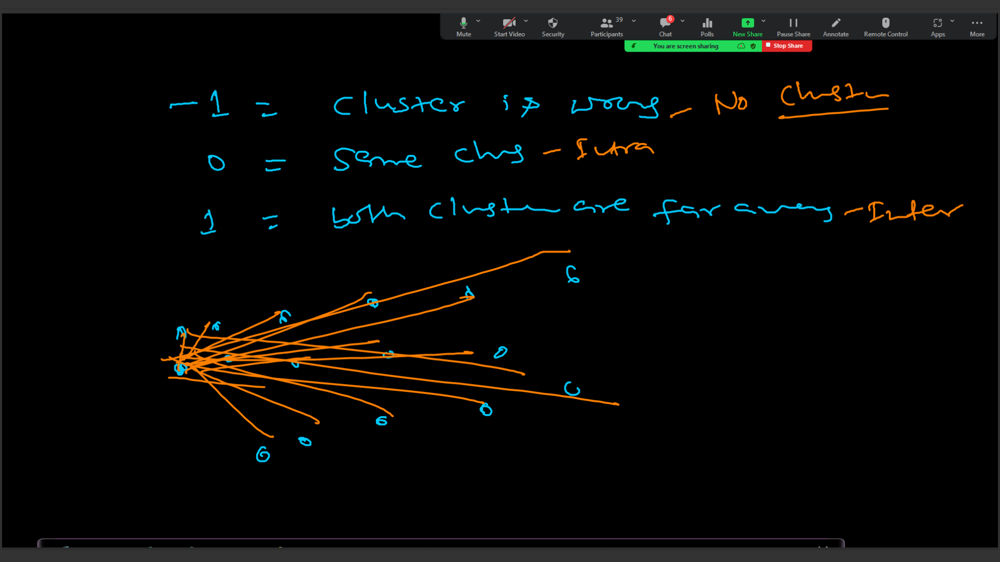

#**Class(26)(DBSCAN)(Sep3-2023)**

In [ ]:
#DBSCAN - Density Based Special clustering Application With Noise.

# ---> NoBody using DBSCAN

In [ ]:
# Seperate dataset into dense region from sparse region.

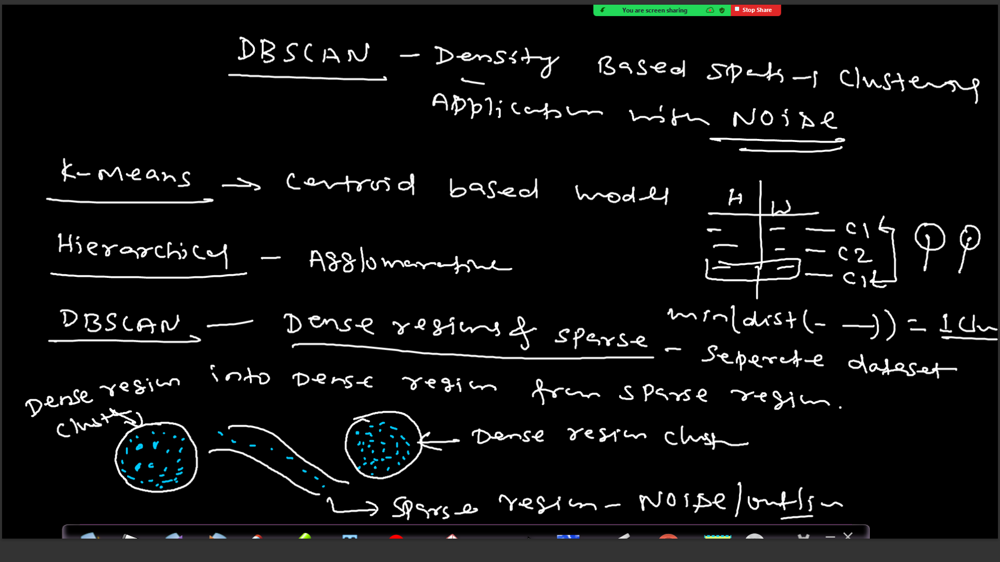

In [ ]:
# How to measure Density?
# ---> Understand the minpoints,epsilon value,core points,Border Points,noise points.

    ## min Point and epsilon(eps) value :-
#--> no. of(#) ponts within a circle/hypersphere/sphere of radius(eps) around p

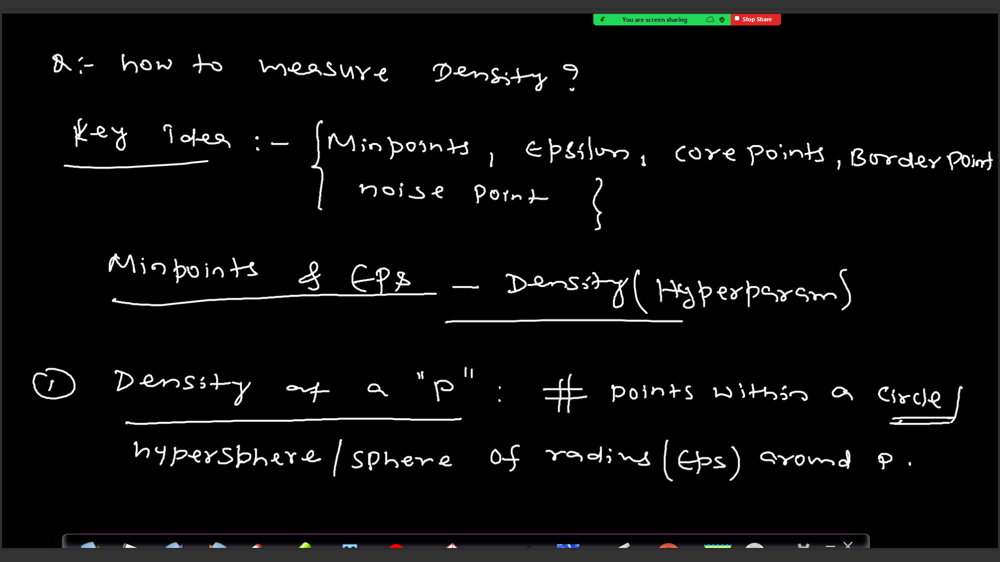

In [ ]:
# Density Cluster - min point 4 and radius is 1 then we can say Density Cluster.
# Core Point - if P value >= min point in an eps/radius around it,that is called core point.
# P(core point) is center.

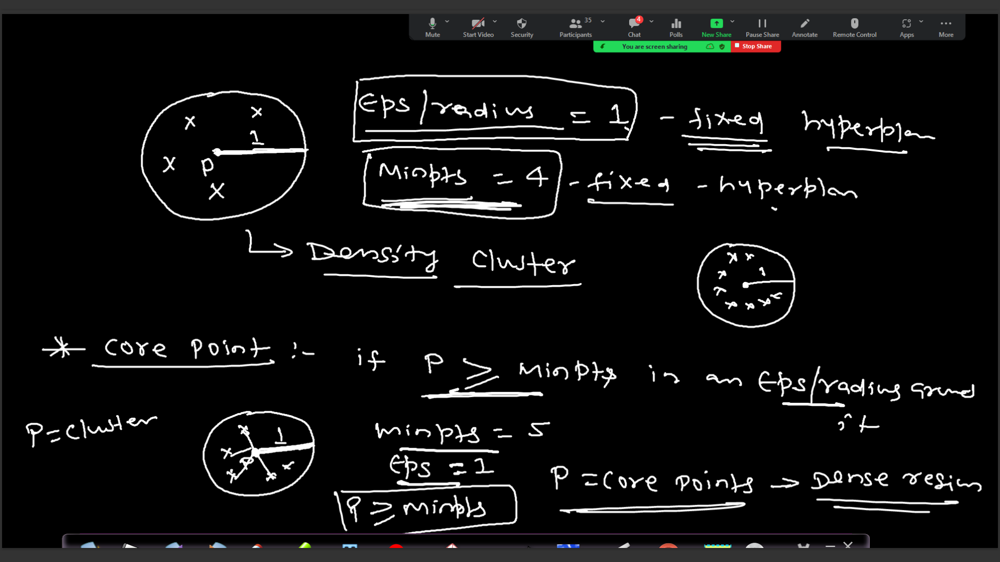

In [ ]:
# Border Point(Boundary point) -

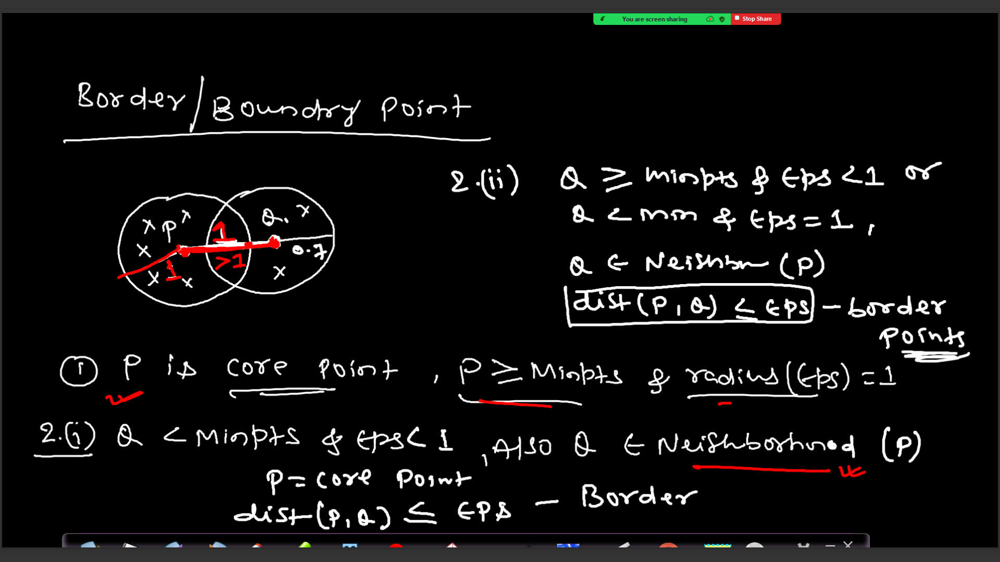

In [ ]:
# Noise Point

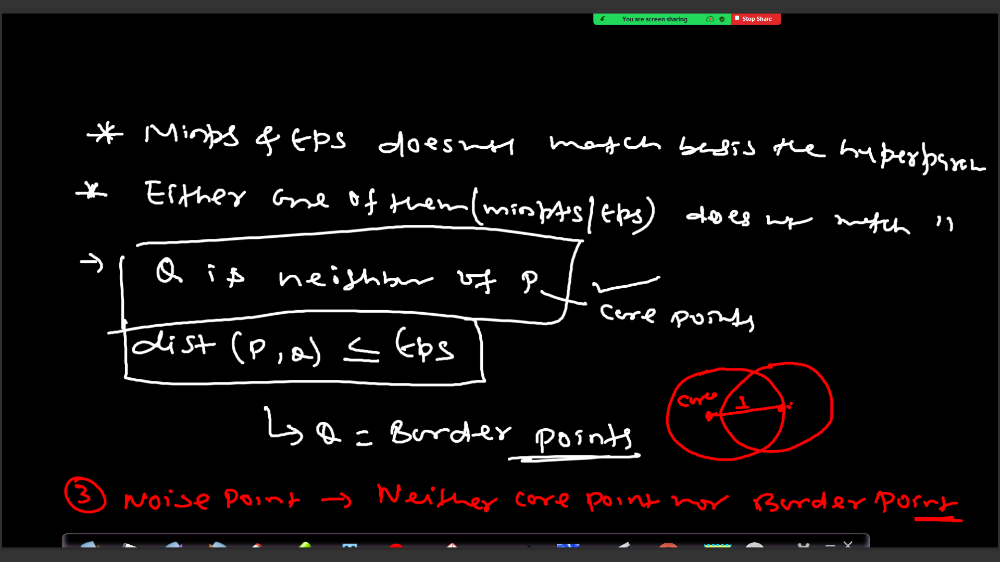

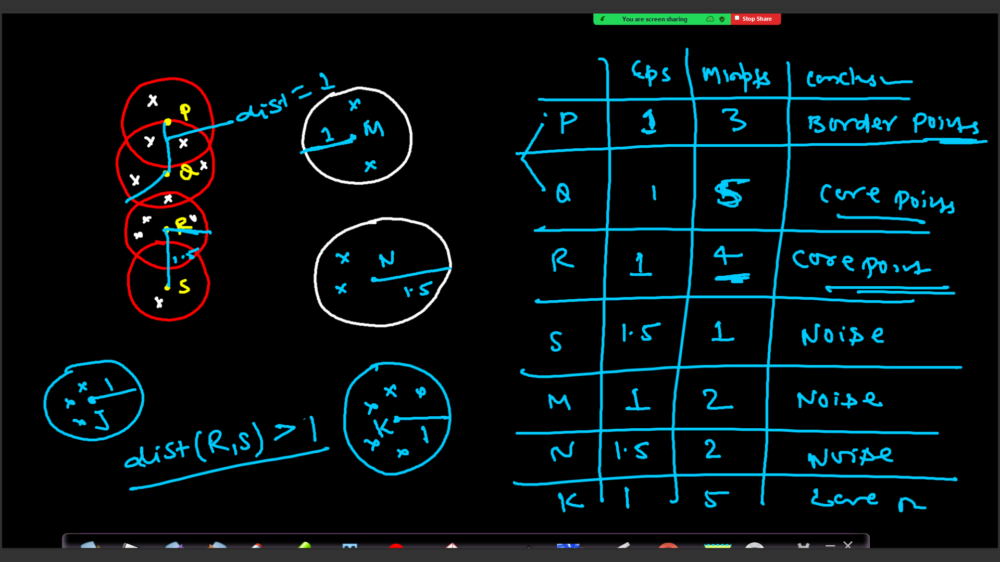

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [ ]:
mydata=pd.read_csv('/content/Mall_Customers.csv')
mydata.head()

,CustomerID,Gender,Age,Annual Income (k$),Spending Score (1-100)
0,1,Male,19,15,39
1,2,Male,21,15,81
2,3,Female,20,16,6
3,4,Female,23,16,77
4,5,Female,31,17,40


In [ ]:
# x=mydata.iloc[:,3:]
x=mydata.iloc[:,3:].values
x

array([[ 15,  39],
       [ 15,  81],
       [ 16,   6],
       [ 16,  77],
       [ 17,  40],
       [ 17,  76],
       [ 18,   6],
       [ 18,  94],
       [ 19,   3],
       [ 19,  72],
       [ 19,  14],
       [ 19,  99],
       [ 20,  15],
       [ 20,  77],
       [ 20,  13],
       [ 20,  79],
       [ 21,  35],
       [ 21,  66],
       [ 23,  29],
       [ 23,  98],
       [ 24,  35],
       [ 24,  73],
       [ 25,   5],
       [ 25,  73],
       [ 28,  14],
       [ 28,  82],
       [ 28,  32],
       [ 28,  61],
       [ 29,  31],
       [ 29,  87],
       [ 30,   4],
       [ 30,  73],
       [ 33,   4],
       [ 33,  92],
       [ 33,  14],
       [ 33,  81],
       [ 34,  17],
       [ 34,  73],
       [ 37,  26],
       [ 37,  75],
       [ 38,  35],
       [ 38,  92],
       [ 39,  36],
       [ 39,  61],
       [ 39,  28],
       [ 39,  65],
       [ 40,  55],
       [ 40,  47],
       [ 40,  42],
       [ 40,  42],
       [ 42,  52],
       [ 42,  60],
       [ 43,

In [ ]:
# scale the data
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
x_sc = sc.fit_transform(x)
pd.DataFrame(x_sc)

,0,1
0,-1.738999,-0.434801
1,-1.738999,1.195704
2,-1.700830,-1.715913
3,-1.700830,1.040418
4,-1.662660,-0.395980
...,...,...
195,2.268791,1.118061
196,2.497807,-0.861839
197,2.497807,0.923953
198,2.917671,-1.250054


In [ ]:
mydata.isnull().sum()

CustomerID                0
Gender                    0
Age                       0
Annual Income (k$)        0
Spending Score (1-100)    0
dtype: int64

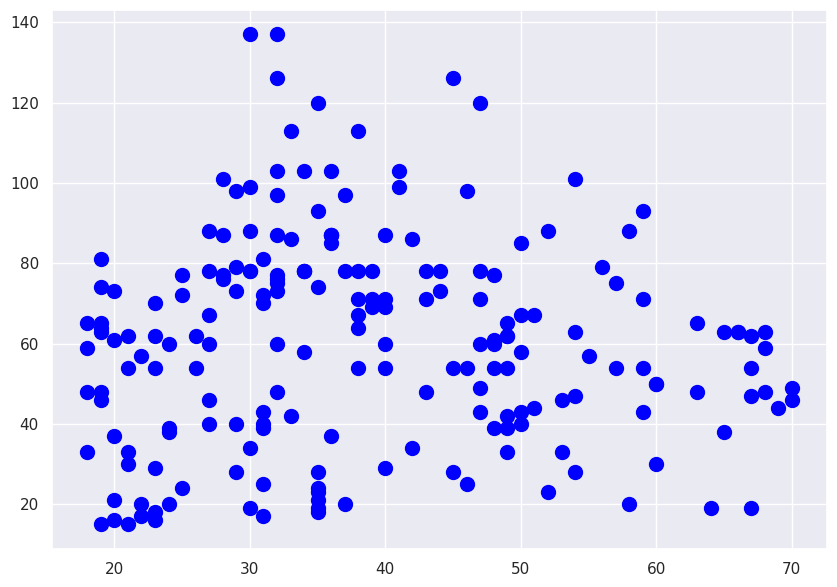

In [ ]:
# Visualization Age vs Annual Income (k$)
plt.figure(figsize=(10,7))
plt.scatter(mydata[['Age']],mydata[['Annual Income (k$)']],s=100,c='blue')
plt.show()

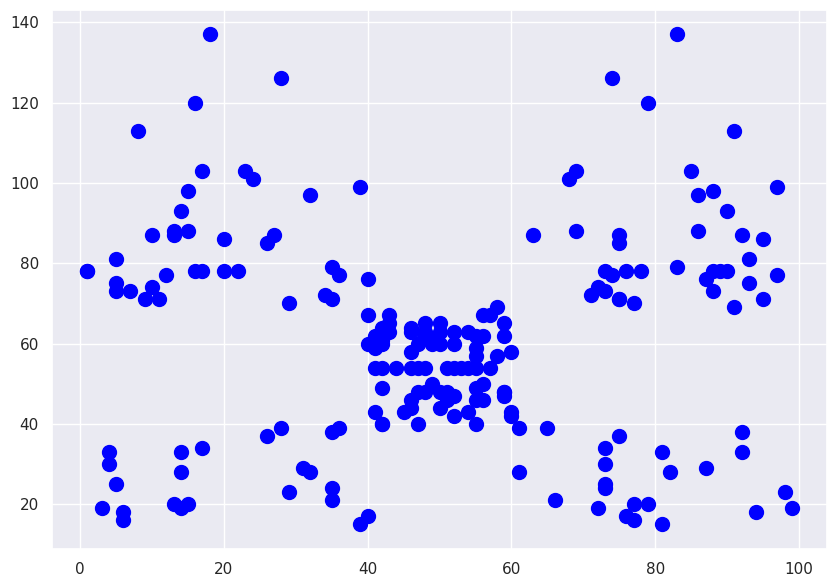

In [ ]:
# Visualization Spending Score (1-100) vs Annual Income (k$)
plt.figure(figsize=(10,7))
plt.scatter(mydata[['Spending Score (1-100)']],mydata[['Annual Income (k$)']],s=100,c='blue')
plt.show()

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# our purpose is here, To decide which cluster is a good or bad,what is the agenda first

In [ ]:
# through elbow method will decide how many cluster is required

In [ ]:
# kmeans=KMeans(n_clusters=8,init='k-means++')
# n_clusters=8 (Bydefault n_cluster is 8)
# init='k-means++' ('k-means++' calculating the centroid value)

In [ ]:
# find how many cluster is good

#wcss - within cluster sum of square
wcss=[]
wcss = []

for i in range(1,15):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=1)
    kmeans.fit(x_sc)
    wcss.append(kmeans.inertia_) # inertia_ means center value


In [ ]:
wcss
# inertia

[400.00000000000006,
 269.1425070447922,
 157.7040081503594,
 108.92131661364358,
 65.56840815571681,
 55.10377812115058,
 44.91118554999014,
 37.15135706793107,
 33.85410621736369,
 29.076176851244277,
 26.23063414845603,
 23.37409986508554,
 21.260965079895307,
 18.862307505767365]

In [ ]:
len(wcss)

14

In [ ]:
a = [1,2,3,4,5,6,7,8,9,10,11,12,13,14]

<Axes: >

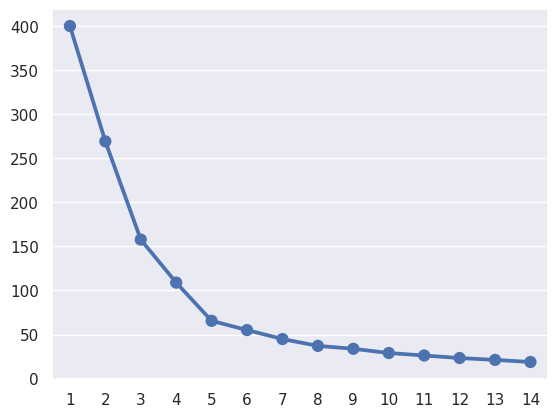

In [ ]:
sns.pointplot(x=a, y=wcss)
# here we can see elbow method, so easily we can say 5 cluster is good.

In [ ]:
# so here put n_cluster=5
kmeans=KMeans(n_clusters=5,init='k-means++',random_state=1)
# init='k-means++' ('k-means++' calculating the centroid value)
y_kmeans=kmeans.fit_predict(x_sc)
y_kmeans

array([4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0,
       4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 0, 4, 2,
       4, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 1, 3, 2, 3, 1, 3, 1, 3,
       2, 3, 1, 3, 1, 3, 1, 3, 1, 3, 2, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3,
       1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3,
       1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3, 1, 3,
       1, 3], dtype=int32)

In [63]:
combined=pd.concat([mydata,pd.DataFrame(y_kmeans)],axis=1)
combined.head()

,CustomerID,Gender,Age,Annual Income (k$),Spending Score (1-100),0
0,1,Male,19,15,39,4
1,2,Male,21,15,81,0
2,3,Female,20,16,6,4
3,4,Female,23,16,77,0
4,5,Female,31,17,40,4


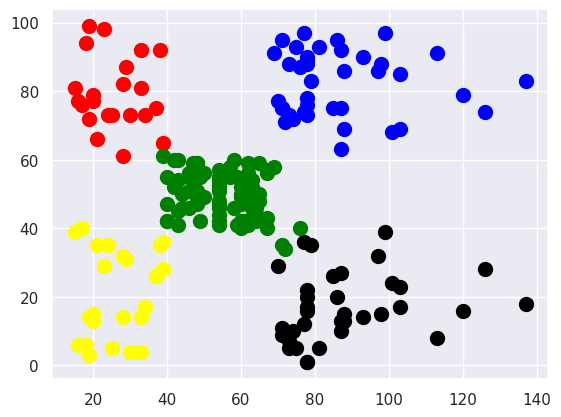

In [64]:
# 0 represent annual salary and 1 represent spending score
# 0,1,2,3,4 is cluster
plt.scatter(x[y_kmeans==0,0], x[y_kmeans==0,1], s=100, c='red', label='Cluster0')
plt.scatter(x[y_kmeans==1,0], x[y_kmeans==1,1], s=100, c='black', label='Cluster1')
plt.scatter(x[y_kmeans==2,0], x[y_kmeans==2,1], s=100, c='green', label='Cluster2')
plt.scatter(x[y_kmeans==3,0], x[y_kmeans==3,1], s=100, c='blue', label='Cluster3')
plt.scatter(x[y_kmeans==4,0], x[y_kmeans==4,1], s=100, c='yellow', label='Cluster4')
plt.show()

# here x axis is Annual Income (k$) and y axis is Spending Score (1-100).
    ## Explain visualization :-
  #  --->  Blue cluster is higher the salary and higher the spending score, so they are the prime cluster. we have to give the all facility.
  # -----> Black Cluster, higher the salary but lower the spending score,so black need marketing promotion required, give some offer. blue and black have approximately same salary but blue one is do fluently transaction but black is not so we have to give some offer for black whcih through black will increase the transaction.
  # ------> green cluster is neither bad or good, so our target about green is go upside through marketing. green is required similar approach like Black.
  # ------> Red cluster is lower salary and higher spending, so we have to increase the limit.
  # ------> Yellow cluster, not worry about them, they will do transaction or not.

**Silhouette Score**

In [ ]:
# Range of Silhouette Score is -1 to +1.

In [ ]:
# Silhouette Score > 0.1 that means good cluster, the distance far away
# Silhouette Score = 0 that means within cluster, all the data in one cluster
# Silhouette Score < -0.1 that means poor cluster, you can not do cluster.

In [65]:
from sklearn.metrics import silhouette_score

In [66]:
silhouette_score(x, y_kmeans)
# Silhouette Score > 0.1 that means good cluster

0.553931997444648

In [67]:
combined.to_csv('final_report_clustering.csv')